###Mount Google Drive
Mount Google Drive - where all nuScenes data and resulting run data will be strored

In [ ]:
#Need to mount my Google Drive
from google.colab import drive
drive.mount("/content/gdrive/")

Drive already mounted at /content/gdrive/; to attempt to forcibly remount, call drive.mount("/content/gdrive/", force_remount=True).


Set environment variable for path to nuScenes dataset

In [ ]:
%cd /content/gdrive/MyDrive/MScDissertation
import os
cwd = os.getcwd()
print("cwd:",cwd)
dataroot=os.path.join(cwd,'data/sets/nuscenes') #needed to remove / before data to make it work
print("dataroot (after joining)",dataroot)



# Add a new environment variable for the nuScenes path
os.environ['NUSCENES'] = dataroot

print("NUSCENES:", os.environ['NUSCENES'])

/content/gdrive/MyDrive/MScDissertation
cwd: /content/gdrive/MyDrive/MScDissertation
dataroot (after joining) /content/gdrive/MyDrive/MScDissertation/data/sets/nuscenes
NUSCENES: /content/gdrive/MyDrive/MScDissertation/data/sets/nuscenes


###Clone and pull code from Github repository

All code for this project is strored at [the following Github link](https://github.com/aokane001/Dissertation-repo). Clone this repository, pull in recent changes and change to the "src" directory which is the main sub-folder for code

In [ ]:
!git clone https://github.com/aokane001/Dissertation-repo

fatal: destination path 'Dissertation-repo' already exists and is not an empty directory.


In [ ]:
#NB Need to actuall change directory forst before pulling
%cd Dissertation-repo/
!git pull
#then switch to src - this is where most of the files we will want to run are
%cd src/

/content/gdrive/MyDrive/MScDissertation/Dissertation-repo
Already up to date.
/content/gdrive/MyDrive/MScDissertation/Dissertation-repo/src


###Import necessary packages

Import all python packages needed for this project, in particular nuScenes-devkit and efficientnet. Warnings can be ignored. Some minor errors related to matplotlib versions can be resolved by restarting the runtime and running all cells again.

In [ ]:
#pip installing all the other stuff we will need - that will be called by other files
!python3 -m pip install --upgrade pip
!pip install efficientnet_pytorch==0.7.0
!pip install torchvision torch tensorboardX
!pip install pyquaternion
import functools
!python3 -m pip install --upgrade Pillow
!pip install nuscenes-devkit &> /dev/null  # Install nuScenes.
#NB mpl_toolkits is not on PyPi so not installable by pip
#Since I have matplotlib already installed simply use the following command
import matplotlib
import mpl_toolkits
#NB Was getting several ShapelyDeprecation warnings - this is to help ignore them for now
import shapely
import warnings
from shapely.errors import ShapelyDeprecationWarning
warnings.filterwarnings("ignore", category=ShapelyDeprecationWarning)

###Set parameters that will be common accross several function calls

Rather than having to pass the same parameter values to several function calls, set them once here, then pass them to function calls below e.g. as decoder_mode = decoder_mode, once it is set here once (as it is a parameter that will change frequently between run setups).

In [ ]:
#NB - Seen as this is a parameter that will be changing frequently - better to set this here then pass it into function definitions and calls
decoder_mode = 5

#With TF Grid this is set as part of the config file - then when running the actual train file it is
#run by firing the main.py file which runs the train.py file and we specify the arguments to pass and point to the config file where the train label is set
#so it never actually gets explicitly passed in the train.py (on which we based train() below) - so I think that's why we need to set it explicitly here
train_label = 'drivable_area'

#Want to set the logdir here - this is what will actually be passed when we call the function below and pass logdir-logdir
#but in the function definition set the default to just be "./runs"
logdir='./runs'

version = "mini"
dataroot = os.environ["NUSCENES"]
#Use 60 epochs for full runs - as per TF Grid
nepochs = 60
#since only one GPU is available in Colab and we start counting from 0
gpuid = 0

#params related to data_aug_conf - i.e. related to data augmentation of camera images
H=900
W=1600
resize_lim=(0.193, 0.225)
final_dim=(128, 352)
bot_pct_lim=(0.0, 0.22)
rot_lim=(-5.4, 5.4)
rand_flip=True
ncams=5
max_grad_norm=5.0
pos_weight=2.13

#params related to grid_conf - i.e. grid configuration of final semantic grid - want this to be 200 x 200 cells i.e. -50m to 50m range in 0.5m intervals
xbound=[-50.0, 50.0, 0.5]
ybound=[-50.0, 50.0, 0.5]
zbound=[-10.0, 10.0, 20.0]
dbound=[4.0, 45.0,1.0] #this is D in literature of Lift Splat Shoot - range of distances

#params related to training function
bsz=2 #batch size
nworkers=2

lr = 1e-3 #learning rate
weight_decay = 1e-7 #weight_decay for L2 regularisation
num_classes = 1 #ultimately only training for 1 class at a time

#params related to PointPillars backbone
num_points = 100000
#NB - AS WE ARE training BASED ON MINI - PASS 34718 WHEN CALLING TRAIN
# trainval avg 34720  , mini avg 34718
n_points=34718

#As per TFGrid config files this was left as is - defined based on xbound, ybound so that grid sizes match up and allow for concatenation
#Comment and let this be passed wheb defining grid_conf
#pc_range= [xbound[0],ybound[0],-4,xbound[1],ybound[1],4]
#voxel_size = [xbound[2],ybound[2],8]

max_points_voxel = 100 #this is N in TF Grid literature
max_voxels = 10000 #this is P in TF Grid literature
input_features= 4 #four initial inputs - supplemented to get up to 9-dimensional within PointPillars block
use_norm = True #we do want to use BatchNorm
vfe_filters = [64] #this is effectively C=64 for PointPillars - controls number of channels
with_distance = False

#Will need to pass this as the place to store data for visualisations
img_save_dir = './runs/viz_model_preds/' #need '/' here so that file path is saved correctly when passing to savefig in viz_model_preds() below

#for lidar_check() below
show_lidar=True #want to see lidar scans
viz_train=False #set this to True to see data augmentation and visualise train data rather than val data

#for viz_model_preds below - or visualisation
map_folder = os.environ["NUSCENES"]

###Define train() function

In [ ]:
#import necessary packages and code from other scripts in Github repo
#the following command effectively mirrors the train.py script from TF Grid repo
import torch
import torch.nn.functional as F
from time import time
from tensorboardX import SummaryWriter
import numpy as np
import os

from models_base import compile_model #this will be for base model runs
#from models_2T import compile_model #swapping out to see the model with 2 transformers - just to try understand how sizes work - how many channels I will need when concatenating
from data import compile_data
from tools import SimpleLoss, get_batch_iou, get_val_info,points_to_voxel_loop

#Define train() function
def train(
  train_label = train_label, #In TFGrid this isn't in the definition of train but really it is needed for compile_data that is called as part of it
                             #so it should be passed - in reality it seems the Fire part of main.py that calls the config file gets it from there - but it should be here
  version = version,
  dataroot = dataroot,
  nepochs = nepochs, #60 for full runs
  gpuid = gpuid,

  H = H,
  W = W,
  resize_lim = resize_lim,
  final_dim = final_dim,
  bot_pct_lim = bot_pct_lim,
  rot_lim = rot_lim,
  rand_flip = rand_flip,
  ncams = ncams,
  max_grad_norm = max_grad_norm,
  pos_weight = pos_weight,
  logdir = logdir,
  xbound = xbound,
  ybound = ybound,
  zbound = zbound,
  dbound = dbound,
  decoder_mode = decoder_mode,

  bsz = bsz,
  nworkers = nworkers,
  lr = lr,
  weight_decay = weight_decay,
  num_classes = num_classes,
  num_points = num_points,
  n_points = n_points,

  max_points_voxel = max_points_voxel,
  max_voxels = max_voxels,
  input_features= input_features,
  use_norm = use_norm,
  vfe_filters = vfe_filters,
  with_distance = with_distance
  ):

  #The following dicts are then defined based on passed params
  grid_conf = {
    'xbound': xbound,
    'ybound': ybound,
    'zbound': zbound,
    'dbound': dbound,
    'decoder_mode':decoder_mode #new parameter for decoder_mode to be passed as part of grid_conf
  }

  data_aug_conf = {
    'resize_lim': resize_lim,
    'final_dim': final_dim,
    'rot_lim': rot_lim,
    'H': H, 'W': W,
    'rand_flip': rand_flip,
    'bot_pct_lim': bot_pct_lim,
    'cams': ['CAM_FRONT_LEFT', 'CAM_FRONT', 'CAM_FRONT_RIGHT','CAM_BACK_LEFT', 'CAM_BACK', 'CAM_BACK_RIGHT'],
    'Ncams': ncams,
  }

  cfg_pp = {
    'num_classes':num_classes,
    'num_points': num_points,
    'pc_range': [xbound[0],ybound[0],-4,xbound[1],ybound[1],4], #NB-define this based on xbound, ybound so grid sizes will match
    'voxel_size' : [xbound[2],ybound[2],8], #NB-define this based on xbound, ybound so grid sizes will match
    'max_points_voxel' : max_points_voxel,
    'max_voxels': max_voxels,
    'input_features': input_features,
    'batch_size': bsz,
    'use_norm': use_norm,
    'vfe_filters': vfe_filters,
    'with_distance': with_distance,
    'n_points': n_points,
  }

  print('Loading data ...')
  #Had to change the way this is called slightly - it is strange, in train.py in TFGrid - it passes n_points and pc_range explicitly but this isn't how it is defined in models.py
  trainloader, valloader = compile_data(version, dataroot, data_aug_conf=data_aug_conf,
                                          grid_conf=grid_conf, bsz=bsz, nworkers=nworkers,
                                          parser_name='segmentationdata',cfg_pp=cfg_pp, train_label=train_label) #other paraemeter - cond, dist, rank, sw can be left as default

  device = torch.device('cpu') if gpuid < 0 else torch.device(f'cuda:{gpuid}')
  print('Compiling model ...')
  model = compile_model(grid_conf, data_aug_conf, outC=1, cfg_pp=cfg_pp) ### outC number of output channels
  model.to(device)
  opt = torch.optim.Adam(model.parameters(), lr=lr, weight_decay=weight_decay)
  loss_fn = SimpleLoss(pos_weight).cuda(gpuid)
  writer = SummaryWriter(logdir=logdir)
  val_step = 500 if version == 'mini' else 5000
  model.train()
  counter = 0
  print('Starting training ...')
  for epoch in range(nepochs):
      print(f"Epoch: {epoch+1}/{nepochs}") #NOTE - ACTUAL VALUE OF epoch WILL START COUNTING FROM 0 - THIS IS JUST FOR CONVENIENCE OF READING OUTPUT TO START FROM 1
      np.random.seed()
      for batchi, (imgs, rots, trans, intrins, post_rots, post_trans, binimgs, points) in enumerate(trainloader):
          t0 = time()
          opt.zero_grad()
          voxels, coors, num_points = points_to_voxel_loop(points, cfg_pp)
          preds = model(imgs.to(device),
                  rots.to(device),
                  trans.to(device),
                  intrins.to(device),
                  post_rots.to(device),
                  post_trans.to(device),
                  voxels.to(device),
                  coors.to(device),
                  num_points.to(device),
                  )

          binimgs = binimgs.to(device)
          loss = loss_fn(preds, binimgs)
          loss.backward()
          torch.nn.utils.clip_grad_norm_(model.parameters(), max_grad_norm)
          opt.step()
          counter += 1
          t1 = time()
          if counter % 10 == 0:
              print(counter, loss.item())
              writer.add_scalar('train/loss', loss, counter)
          if counter % 50 == 0:
              intersection, union, iou = get_batch_iou(preds, binimgs)
              writer.add_scalar('train/iou', iou, counter)
              writer.add_scalar('train/epoch', epoch, counter)
              writer.add_scalar('train/step_time', t1 - t0, counter)
          if counter % val_step == 0:
              val_info = get_val_info(model, valloader, loss_fn, device, cfg_pp=cfg_pp,grid_conf=grid_conf, use_tqdm= True)
              print('VAL', val_info)
              writer.add_scalar('val/loss', val_info['loss'], counter)
              writer.add_scalar('val/iou', val_info['iou'], counter)
          if counter % val_step == 0:
              model.eval()
              mname = os.path.join(logdir, "model{}.pt".format(counter)) #NB This is the location-same runs/ directory where summary will be saved
                                                                         #where the model will also be saved every val_step=500 number of training steps
              print('saving ... ', mname)
              torch.save({
              'epoch': epoch,
              'model_state_dict': model.state_dict(),
              'optimizer_state_dict': opt.state_dict(),
              'loss': loss,
              'counter':counter
              }, mname)
              model.train()


###Now we want to actually call train() to commence training

Loading data ...
Getting all samples
Getting all samples
Compiling model ...
xs shape:  torch.Size([41, 8, 22])
ys shape:  torch.Size([41, 8, 22])


Downloading: "https://github.com/lukemelas/EfficientNet-PyTorch/releases/download/1.0/efficientnet-b0-355c32eb.pth" to /root/.cache/torch/hub/checkpoints/efficientnet-b0-355c32eb.pth
100%|██████████| 20.4M/20.4M [00:02<00:00, 10.4MB/s]
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


Loaded pretrained weights for efficientnet-b0
Starting training ...
Epoch: 1/60
10 0.7873653173446655
20 0.776583731174469
30 0.9065912961959839
40 0.7115129232406616
50 0.633097767829895
60 0.809505820274353
70 0.9575521945953369
80 0.6472500562667847
90 0.6233035922050476
100 0.49880480766296387
110 0.58283531665802
120 0.5087763667106628
130 0.4872263967990875
140 0.45624712109565735
150 0.6213306188583374
160 0.46598100662231445
Epoch: 2/60
170 0.5935601592063904
180 0.6167115569114685
190 0.38344481587409973
200 0.6041967868804932
210 0.42115217447280884
220 0.3199034631252289
230 0.5969941020011902
240 0.5596004724502563
250 0.7702421545982361
260 0.5356367230415344
270 0.6221301555633545
280 0.49020710587501526
290 0.39006122946739197
300 0.49537429213523865
310 0.4674219489097595
320 0.4321750998497009
Epoch: 3/60
330 0.4515995979309082
340 0.597546398639679
350 0.41557881236076355
360 0.4120910167694092
370 0.36168745160102844
380 0.304571270942688
390 0.49388670921325684
400 

  0%|          | 0/40 [00:00<?, ?it/s]/content/gdrive/MyDrive/MScDissertation/Dissertation-repo/src/tools.py:113: UserWarning: The use of `x.T` on tensors of dimension other than 2 to reverse their shape is deprecated and it will throw an error in a future release. Consider `x.mT` to transpose batches of matrices or `x.permute(*torch.arange(x.ndim - 1, -1, -1))` to reverse the dimensions of a tensor. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3571.)
  ax2.imshow(ndimage.rotate(cv2.flip(np.array(binimgs[j].T),0), -90, reshape=False), vmin=0, vmax=1, cmap='Blues')


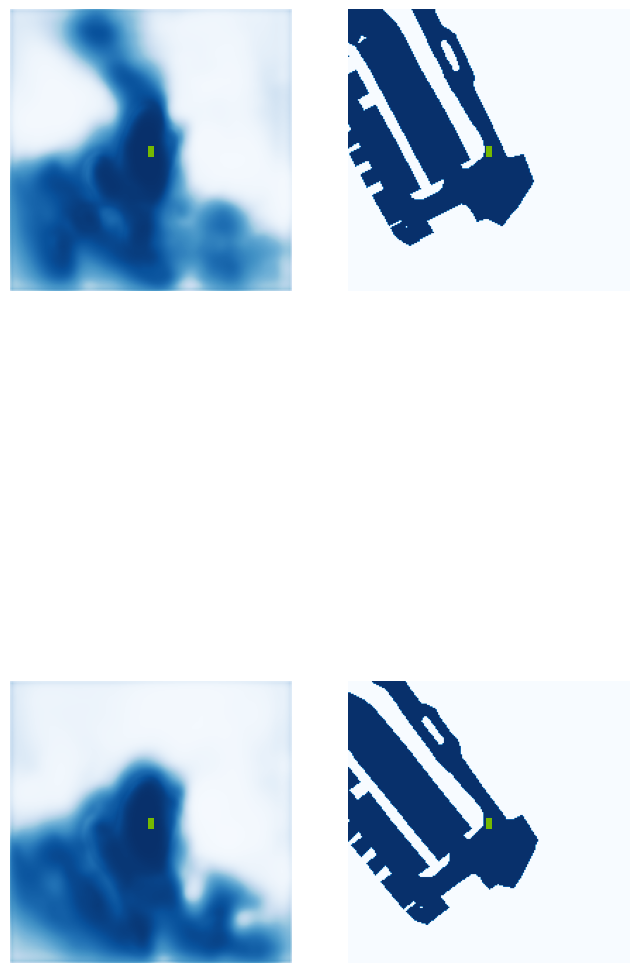

  5%|▌         | 2/40 [00:11<02:56,  4.63s/it]

Image saved! ... ./runs/get_val_info/0-iou-0.28.jpg


 12%|█▎        | 5/40 [00:29<03:26,  5.90s/it]

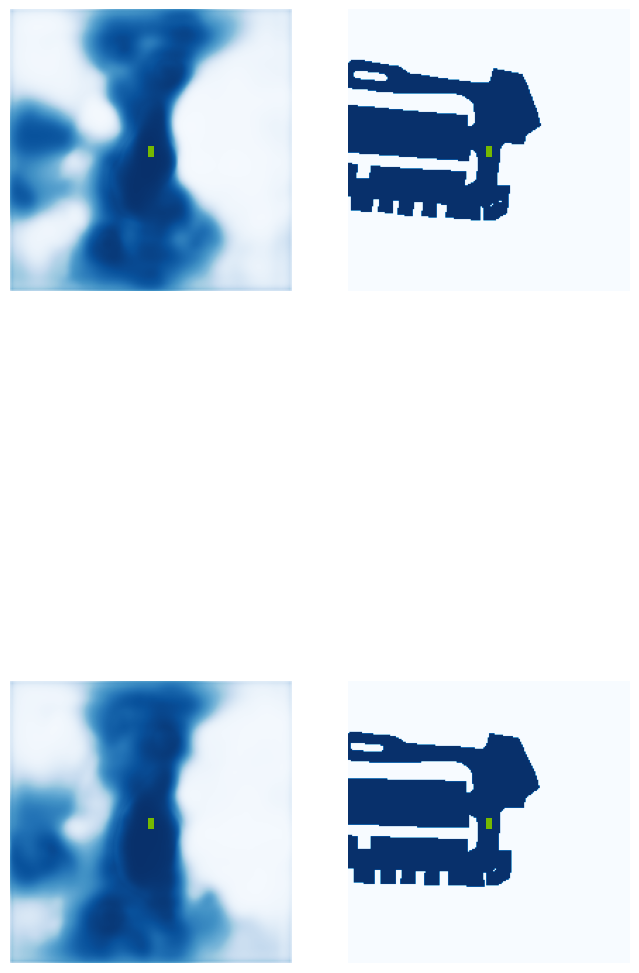

 15%|█▌        | 6/40 [00:29<02:16,  4.03s/it]

Image saved! ... ./runs/get_val_info/5-iou-0.32.jpg


 25%|██▌       | 10/40 [00:48<02:00,  4.00s/it]

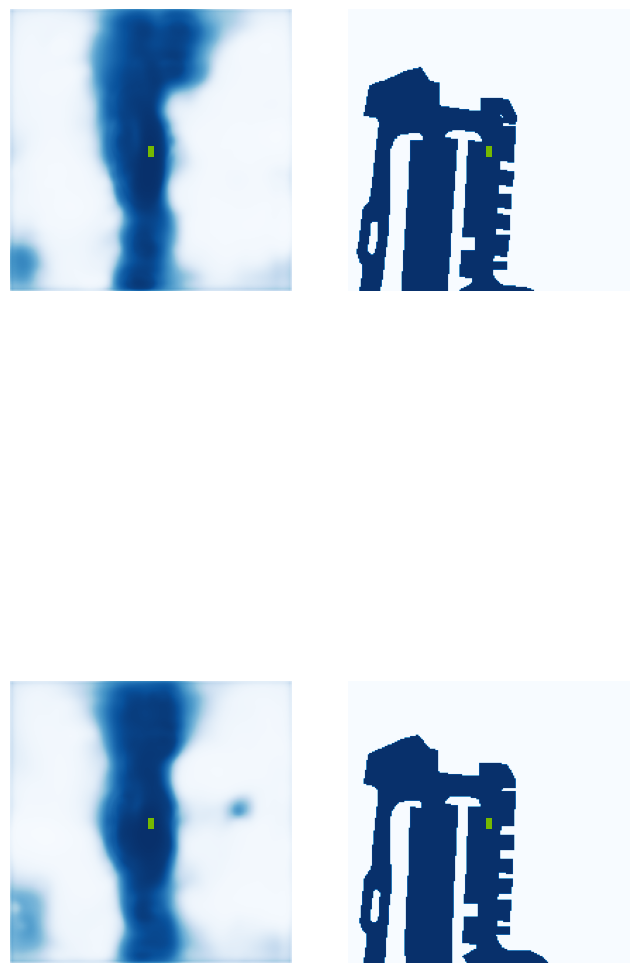

 28%|██▊       | 11/40 [00:58<02:44,  5.68s/it]

Image saved! ... ./runs/get_val_info/10-iou-0.27.jpg


 38%|███▊      | 15/40 [01:17<02:18,  5.55s/it]

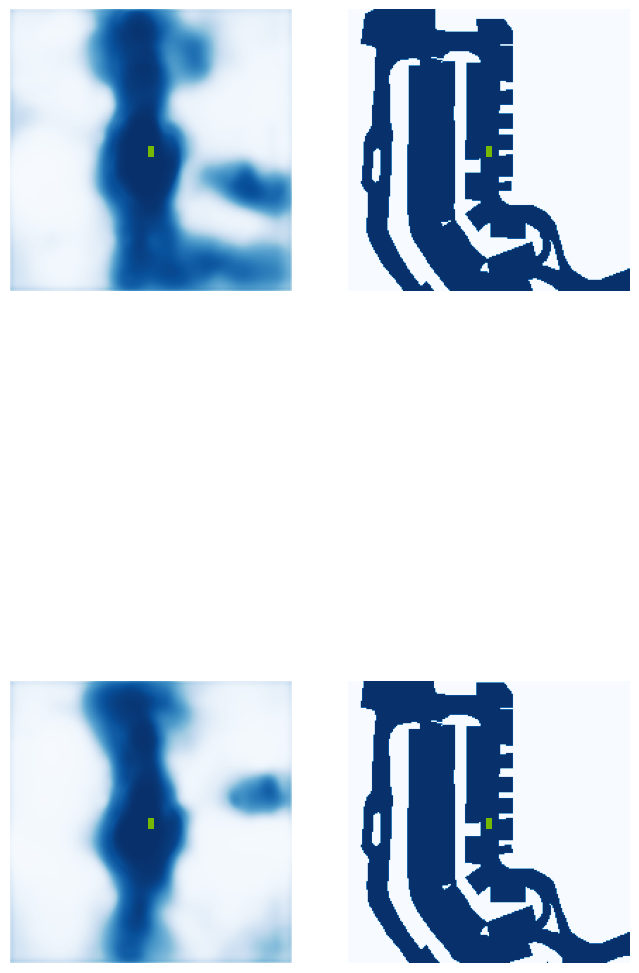

 40%|████      | 16/40 [01:18<01:39,  4.15s/it]

Image saved! ... ./runs/get_val_info/15-iou-0.35.jpg


 50%|█████     | 20/40 [01:37<01:21,  4.09s/it]

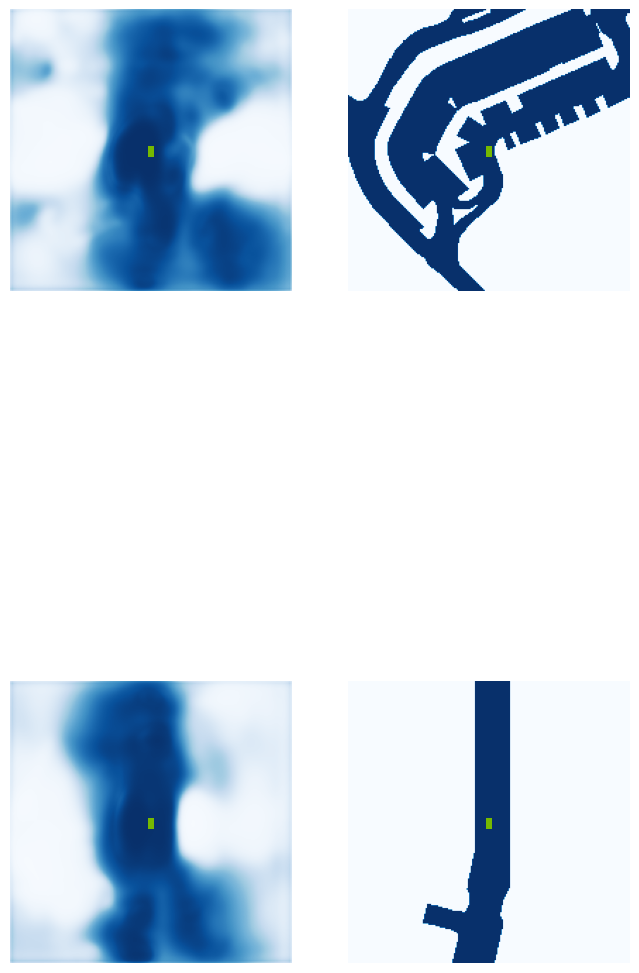

 52%|█████▎    | 21/40 [01:46<01:46,  5.61s/it]

Image saved! ... ./runs/get_val_info/20-iou-0.33.jpg


 62%|██████▎   | 25/40 [02:05<01:22,  5.49s/it]

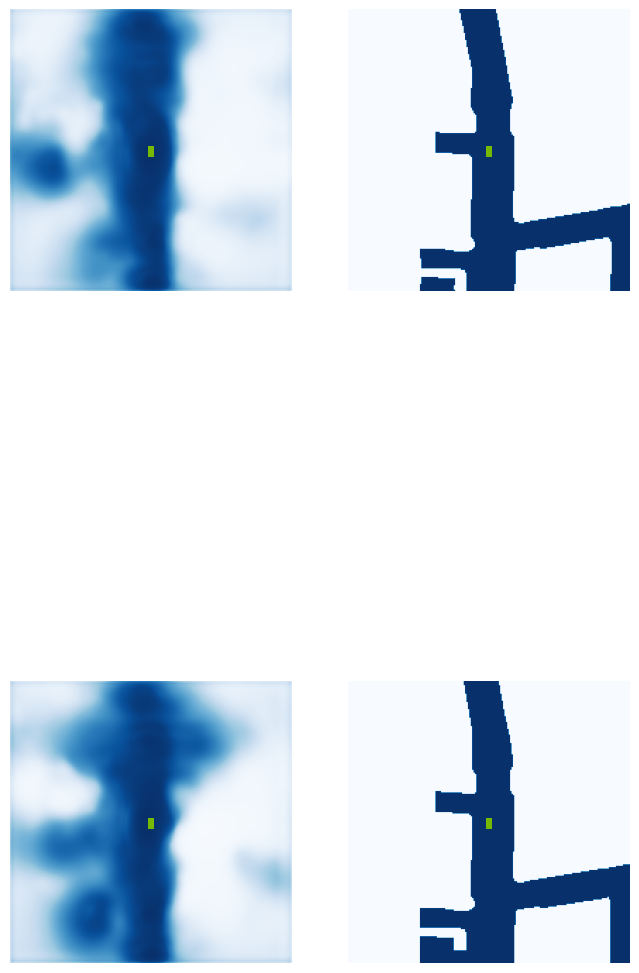

 65%|██████▌   | 26/40 [02:06<00:59,  4.23s/it]

Image saved! ... ./runs/get_val_info/25-iou-0.39.jpg


 75%|███████▌  | 30/40 [02:24<00:39,  3.97s/it]

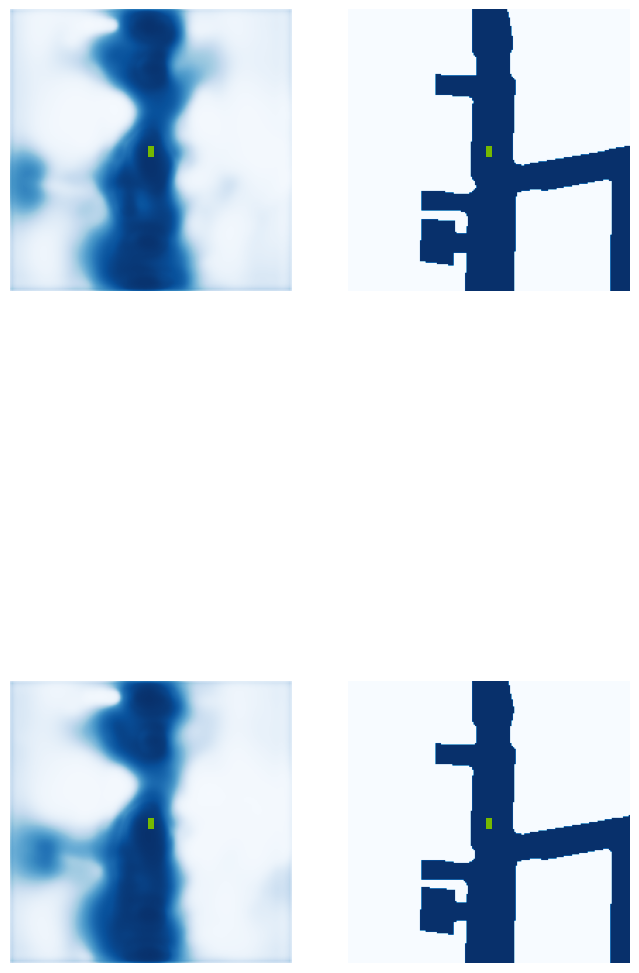

 80%|████████  | 32/40 [02:33<00:31,  3.93s/it]

Image saved! ... ./runs/get_val_info/30-iou-0.48.jpg


 88%|████████▊ | 35/40 [02:52<00:27,  5.50s/it]

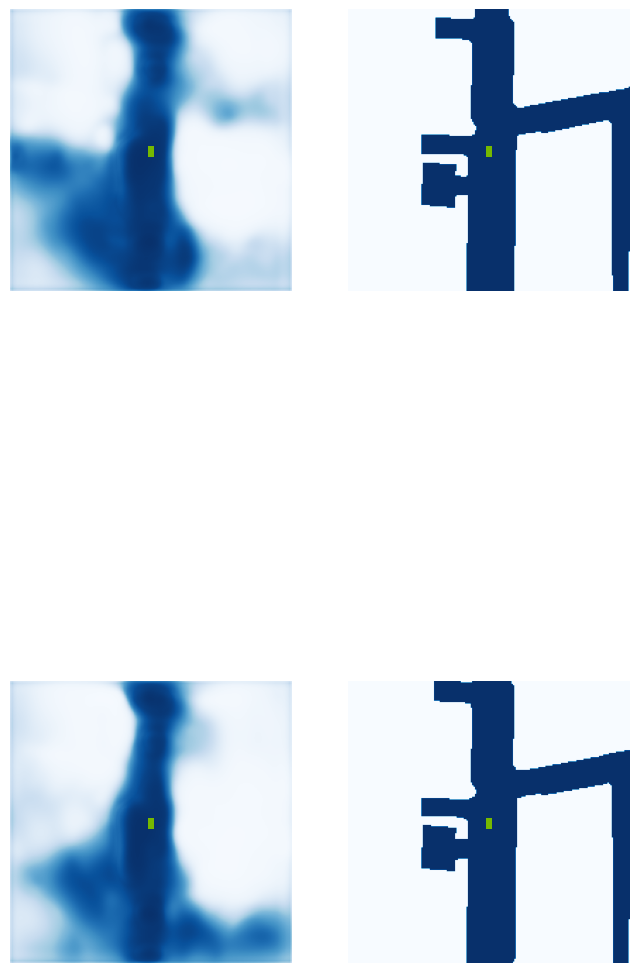

 90%|█████████ | 36/40 [02:53<00:16,  4.13s/it]

Image saved! ... ./runs/get_val_info/35-iou-0.41.jpg


100%|██████████| 40/40 [03:12<00:00,  4.80s/it]


VAL {'loss': 1.0475450827751631, 'iou': 0.3645984712159447}
saving ...  ./runs/model500.pt
510 0.33207258582115173
520 0.39452287554740906
530 0.47911536693573
540 0.4102131724357605
550 0.4096275269985199
560 0.4184643030166626
570 0.34680771827697754
580 0.3481898307800293
590 0.8560915589332581
600 0.3454274535179138
610 0.37827038764953613
620 0.3407728374004364
630 0.2958025336265564
640 0.9282202124595642
Epoch: 5/60
650 0.32969504594802856
660 0.657558798789978
670 0.4176516532897949
680 0.5258932709693909
690 0.37653857469558716
700 0.3442739248275757
710 0.3005266785621643
720 0.35858529806137085
730 0.30028730630874634
740 0.25207942724227905
750 0.364456444978714
760 0.36679187417030334
770 0.29432806372642517
780 0.33558201789855957
790 0.3494513928890228
800 0.41582658886909485
Epoch: 6/60
810 0.3336620032787323
820 0.2950623333454132
830 0.4602058529853821
840 0.37406259775161743
850 0.34378090500831604
860 0.2742469012737274
870 0.3051888048648834
880 0.3526608943939209


  0%|          | 0/40 [00:00<?, ?it/s]

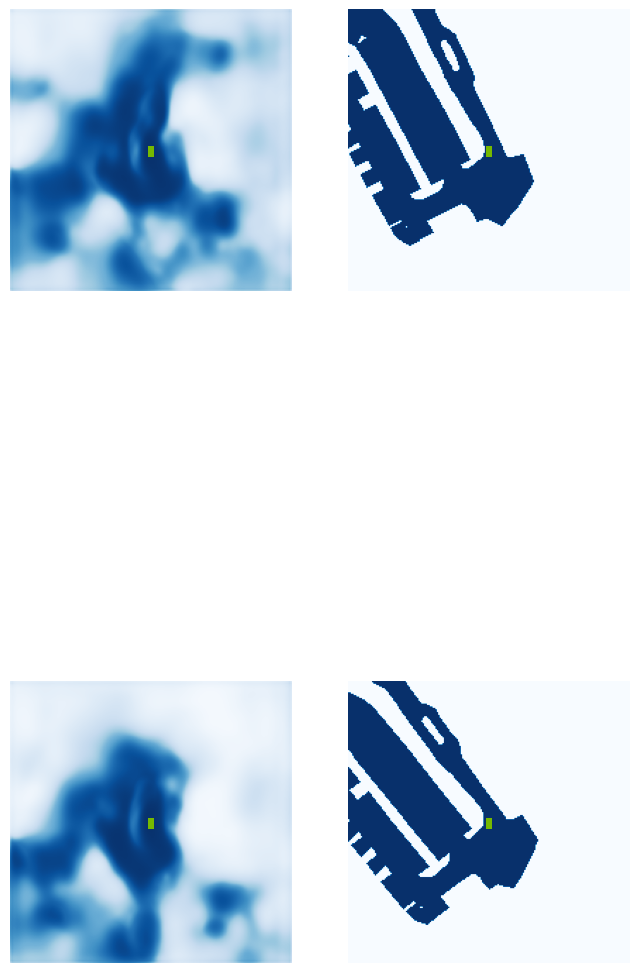

  5%|▌         | 2/40 [00:01<00:20,  1.87it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.31.jpg


 12%|█▎        | 5/40 [00:01<00:07,  4.67it/s]

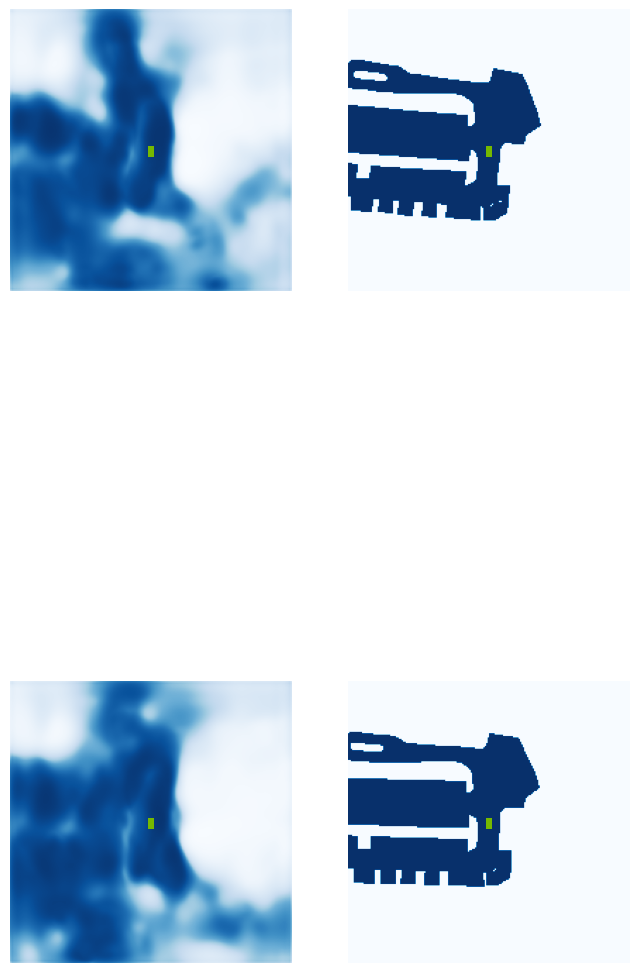

 18%|█▊        | 7/40 [00:02<00:07,  4.38it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.38.jpg


 25%|██▌       | 10/40 [00:02<00:05,  5.52it/s]

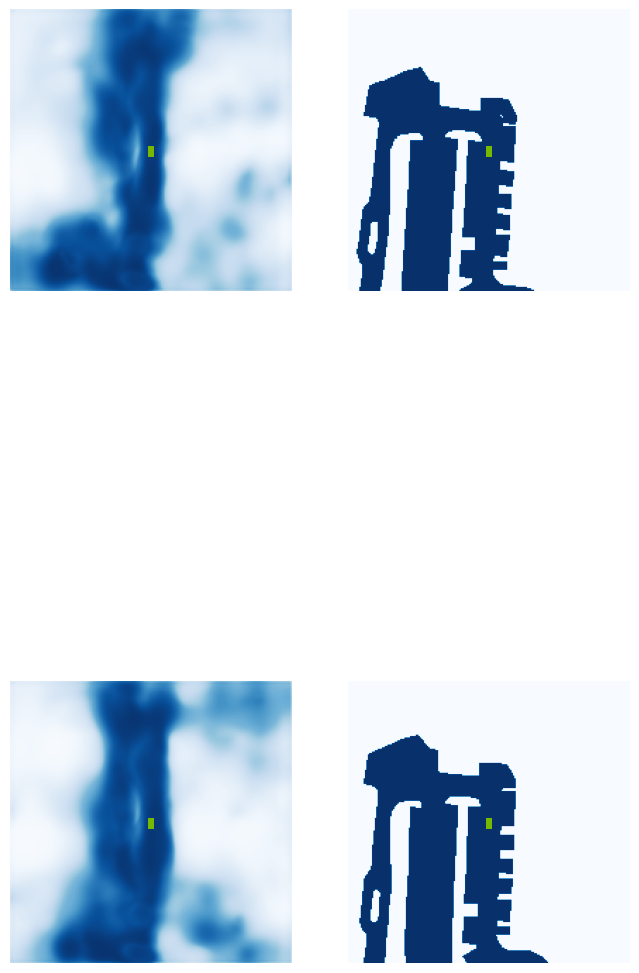

 30%|███       | 12/40 [00:03<00:07,  3.79it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.38.jpg


 38%|███▊      | 15/40 [00:03<00:05,  4.51it/s]

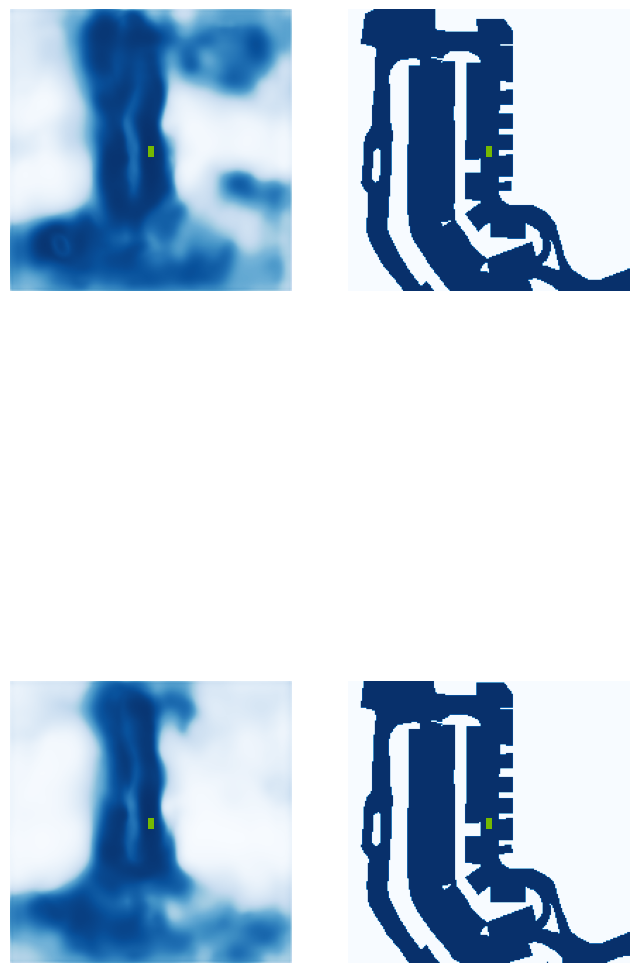

 40%|████      | 16/40 [00:04<00:06,  3.46it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.47.jpg


 50%|█████     | 20/40 [00:04<00:03,  5.46it/s]

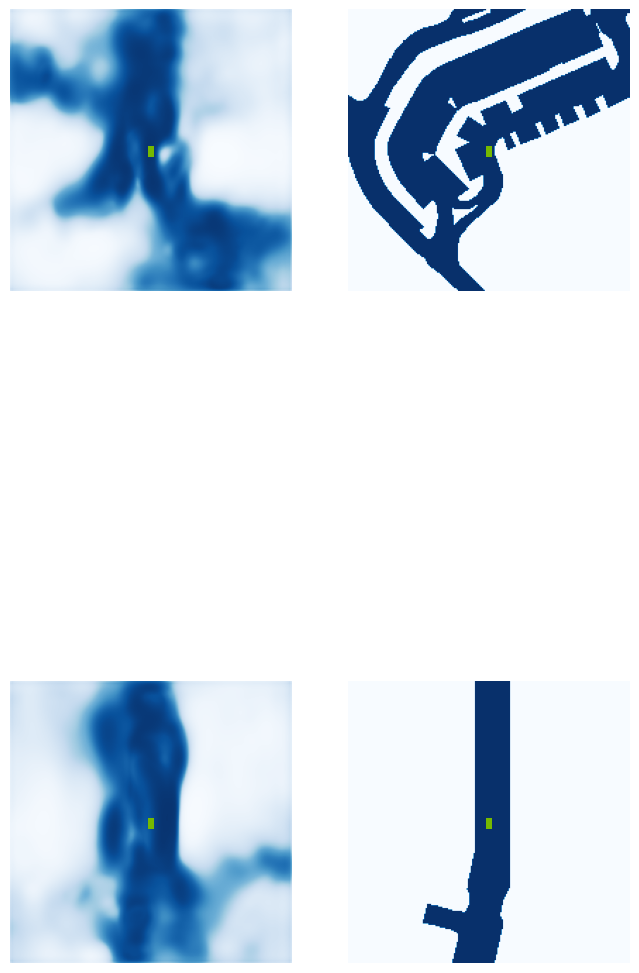

 57%|█████▊    | 23/40 [00:05<00:03,  4.72it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.29.jpg


 62%|██████▎   | 25/40 [00:06<00:02,  5.65it/s]

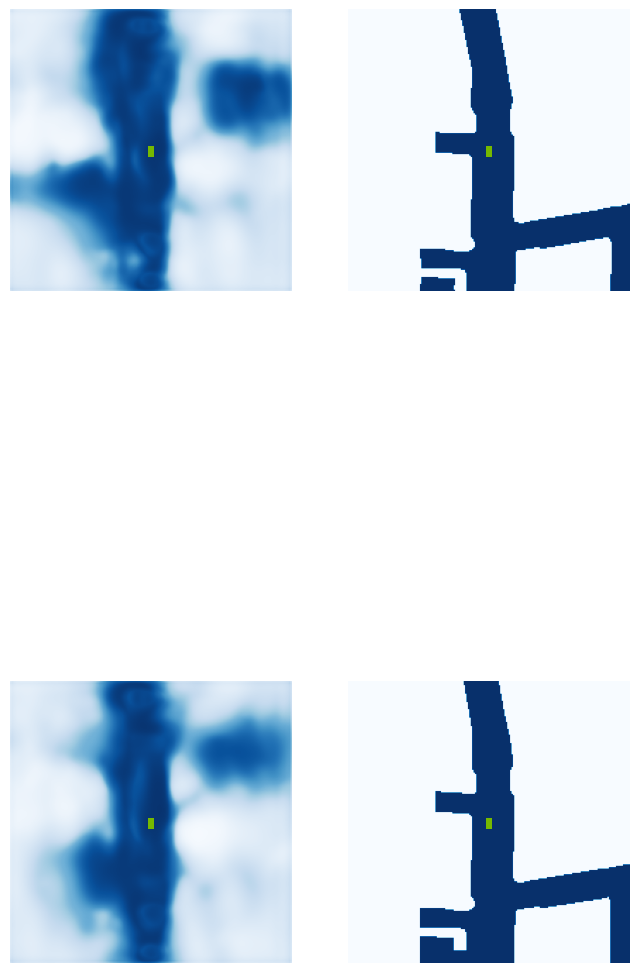

 68%|██████▊   | 27/40 [00:06<00:02,  4.73it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.33.jpg


 75%|███████▌  | 30/40 [00:06<00:01,  6.85it/s]

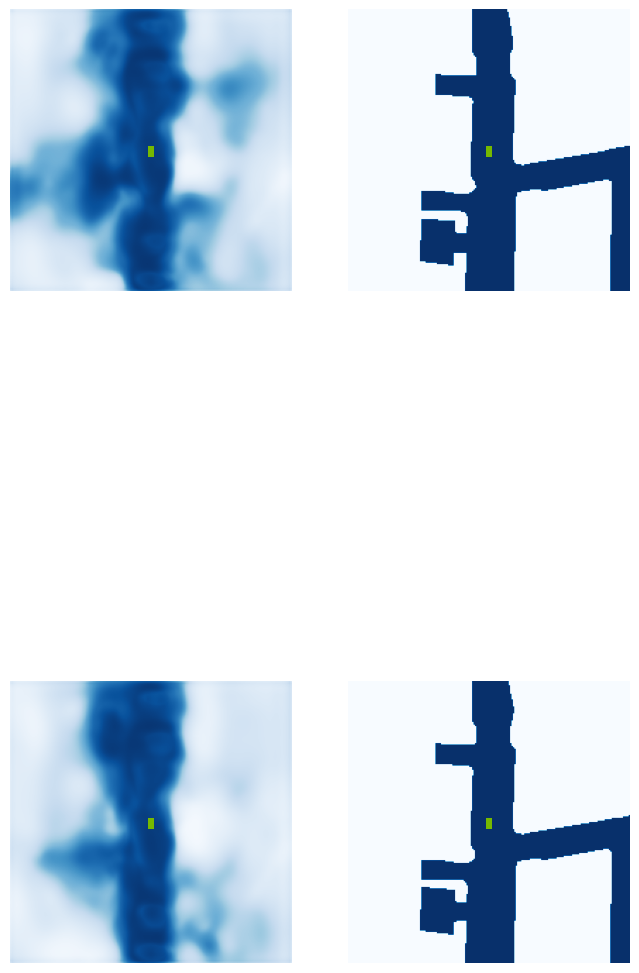

 80%|████████  | 32/40 [00:07<00:01,  4.47it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.41.jpg


 88%|████████▊ | 35/40 [00:07<00:00,  6.58it/s]

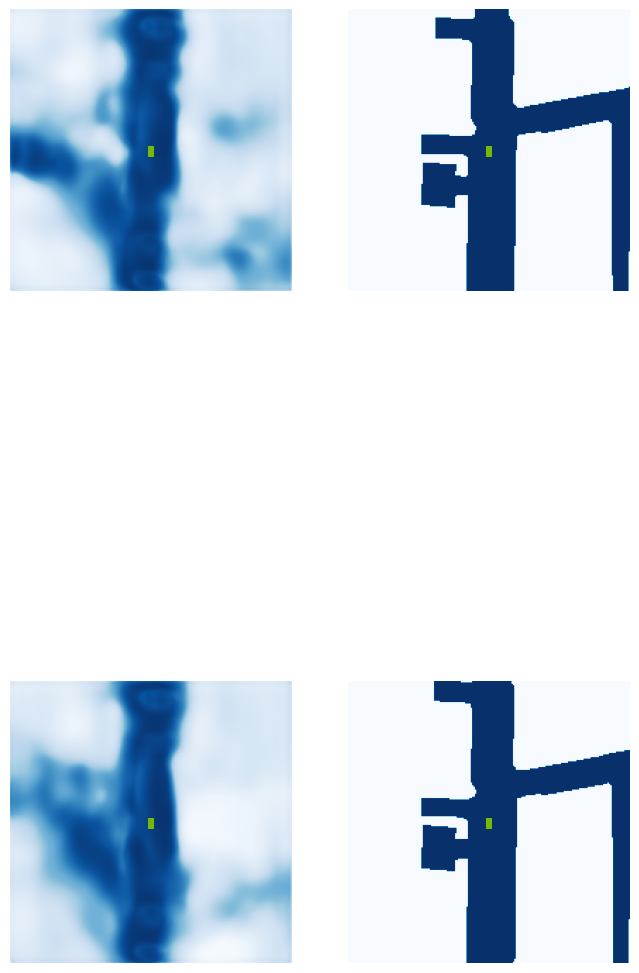

 92%|█████████▎| 37/40 [00:08<00:00,  5.09it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.45.jpg


100%|██████████| 40/40 [00:08<00:00,  4.54it/s]


VAL {'loss': 0.8668810894459854, 'iou': 0.40304909151841567}
saving ...  ./runs/model1000.pt
1010 0.24488043785095215
1020 0.3530482351779938
1030 0.30897197127342224
1040 0.45012351870536804
1050 0.2702949047088623
1060 0.30314138531684875
1070 0.27996063232421875
1080 0.3801361322402954
1090 0.3664112985134125
1100 0.37157347798347473
1110 0.31655386090278625
1120 0.2732757031917572
Epoch: 8/60
1130 0.4416002333164215
1140 0.45769208669662476
1150 0.3964710235595703
1160 0.29189178347587585
1170 0.3314317762851715
1180 0.3052971065044403
1190 0.3674814701080322
1200 0.35236331820487976
1210 0.24314965307712555
1220 0.29352861642837524
1230 0.29874560236930847
1240 0.21102648973464966
1250 0.25483599305152893
1260 0.21636295318603516
1270 0.3548411428928375
1280 0.2840535342693329
Epoch: 9/60
1290 0.23649461567401886
1300 0.3449634611606598
1310 0.21322999894618988
1320 0.5818784832954407
1330 0.4419591724872589
1340 0.2781635820865631
1350 0.29246821999549866
1360 0.2773926258087158


  0%|          | 0/40 [00:00<?, ?it/s]

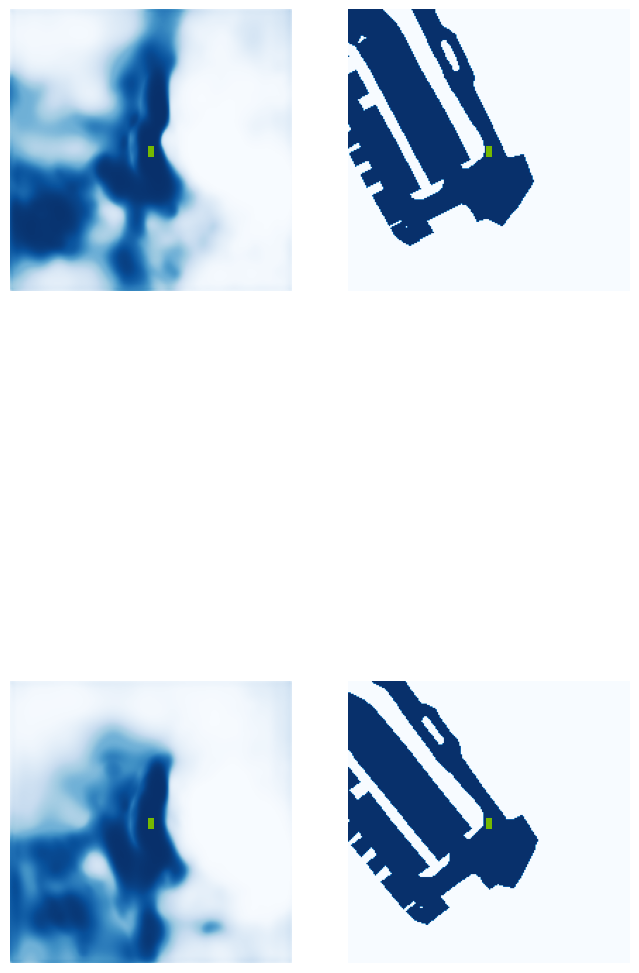

  5%|▌         | 2/40 [00:01<00:22,  1.73it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.32.jpg


 12%|█▎        | 5/40 [00:01<00:07,  4.57it/s]

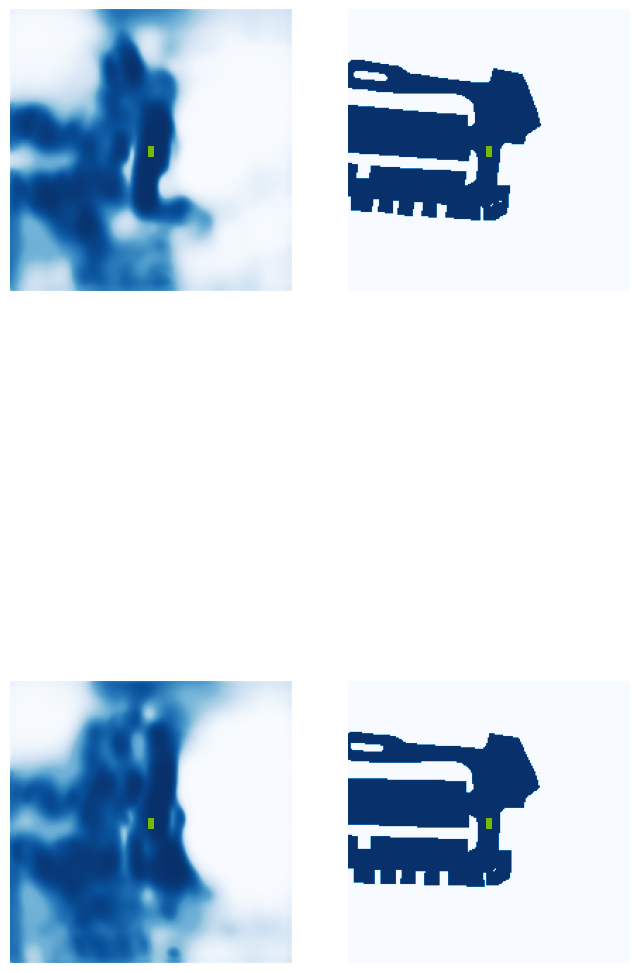

 18%|█▊        | 7/40 [00:02<00:07,  4.32it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.42.jpg


 25%|██▌       | 10/40 [00:02<00:05,  5.51it/s]

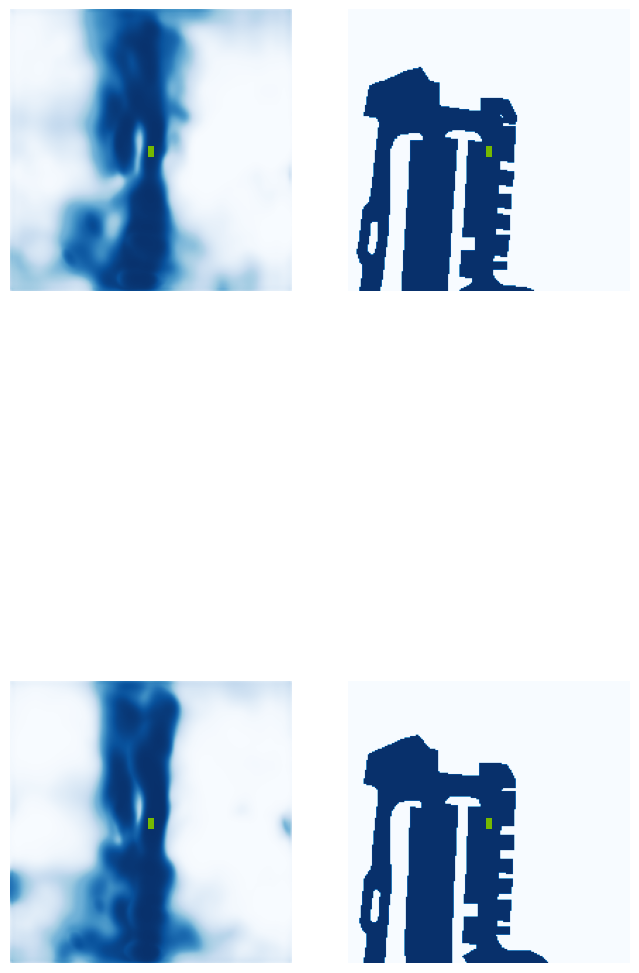

 30%|███       | 12/40 [00:03<00:06,  4.05it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.37.jpg


 38%|███▊      | 15/40 [00:03<00:05,  4.51it/s]

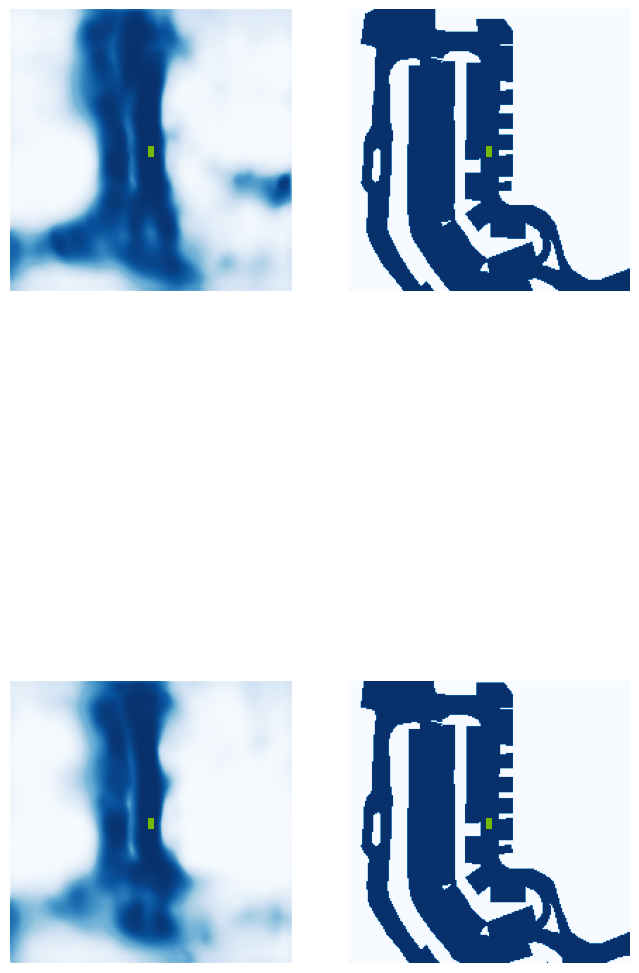

 42%|████▎     | 17/40 [00:04<00:05,  4.21it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.44.jpg


 50%|█████     | 20/40 [00:05<00:03,  5.14it/s]

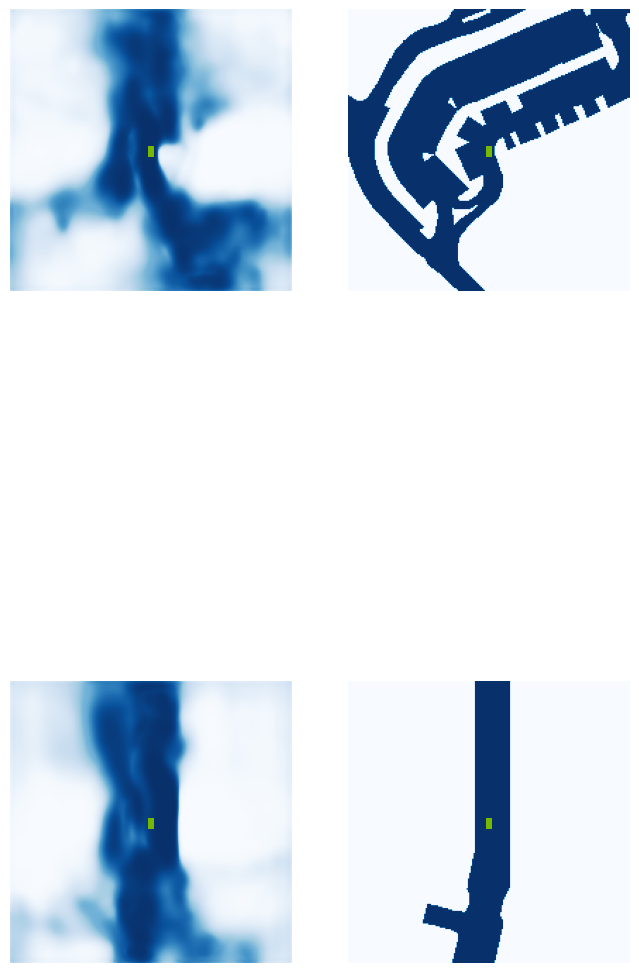

 57%|█████▊    | 23/40 [00:05<00:03,  4.84it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.30.jpg


 62%|██████▎   | 25/40 [00:06<00:02,  5.29it/s]

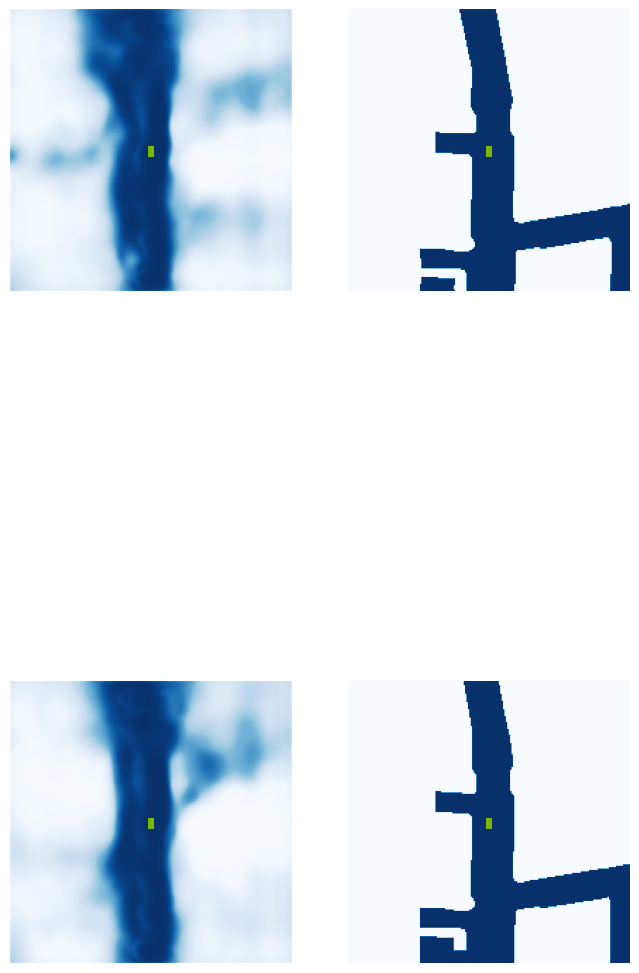

 68%|██████▊   | 27/40 [00:06<00:02,  4.59it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.43.jpg


 75%|███████▌  | 30/40 [00:06<00:01,  6.79it/s]

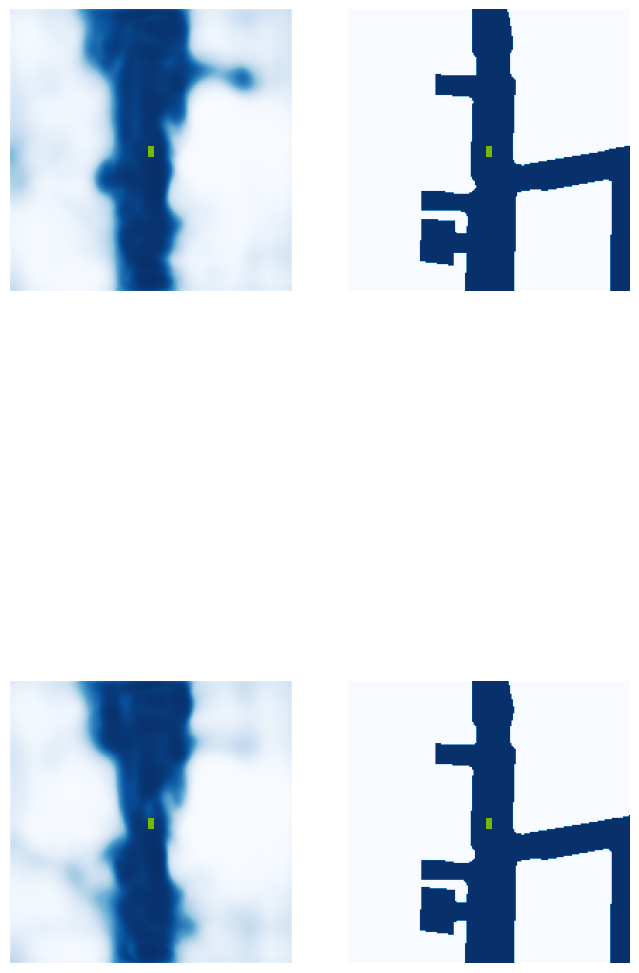

 82%|████████▎ | 33/40 [00:07<00:01,  5.10it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.44.jpg


 88%|████████▊ | 35/40 [00:08<00:00,  5.54it/s]

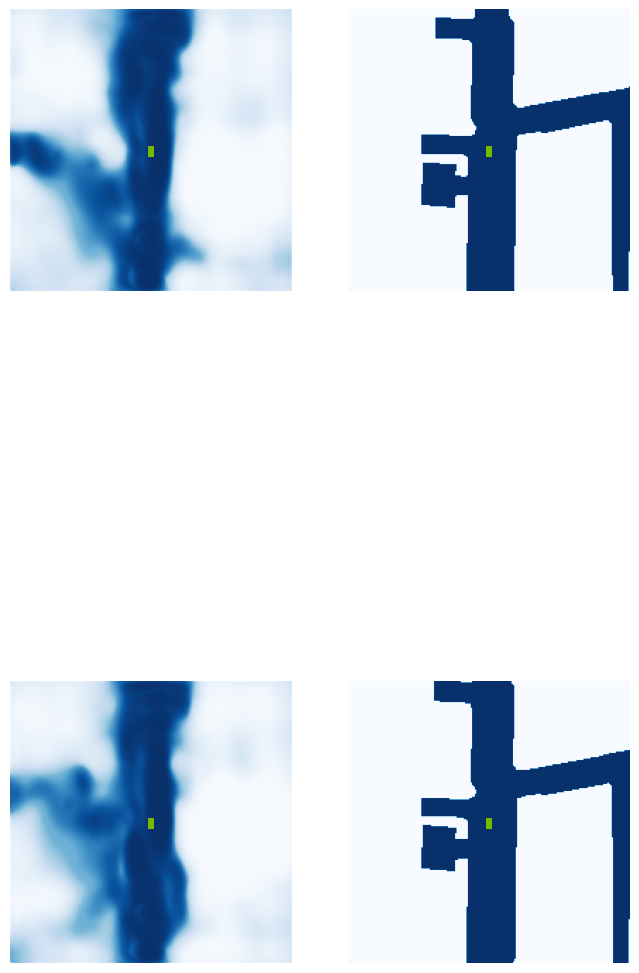

 92%|█████████▎| 37/40 [00:08<00:00,  4.77it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.45.jpg


100%|██████████| 40/40 [00:09<00:00,  4.43it/s]


VAL {'loss': 0.9386895571225955, 'iou': 0.4264475894287945}
saving ...  ./runs/model1500.pt
1510 0.3558972477912903
1520 0.2986557185649872
1530 0.3105396628379822
1540 0.21880090236663818
1550 0.30782806873321533
1560 0.20776115357875824
1570 0.5174415111541748
1580 0.2581312954425812
1590 0.26347461342811584
1600 0.46275603771209717
1610 0.635025680065155
Epoch: 11/60
1620 0.3672238290309906
1630 0.4406931400299072
1640 0.433843731880188
1650 0.23862262070178986
1660 0.436086505651474
1670 0.34233972430229187
1680 0.23318657279014587
1690 0.17694224417209625
1700 0.20607882738113403
1710 0.2883606255054474
1720 0.28050506114959717
1730 0.23573946952819824
1740 0.5031793117523193
1750 0.4014410674571991
1760 0.29825058579444885
1770 0.3250156044960022
Epoch: 12/60
1780 0.2002285271883011
1790 0.19007036089897156
1800 0.24419288337230682
1810 0.23422592878341675
1820 0.7473068833351135
1830 0.35192590951919556
1840 0.16619336605072021
1850 0.27724385261535645
1860 0.23770858347415924
1

  0%|          | 0/40 [00:00<?, ?it/s]

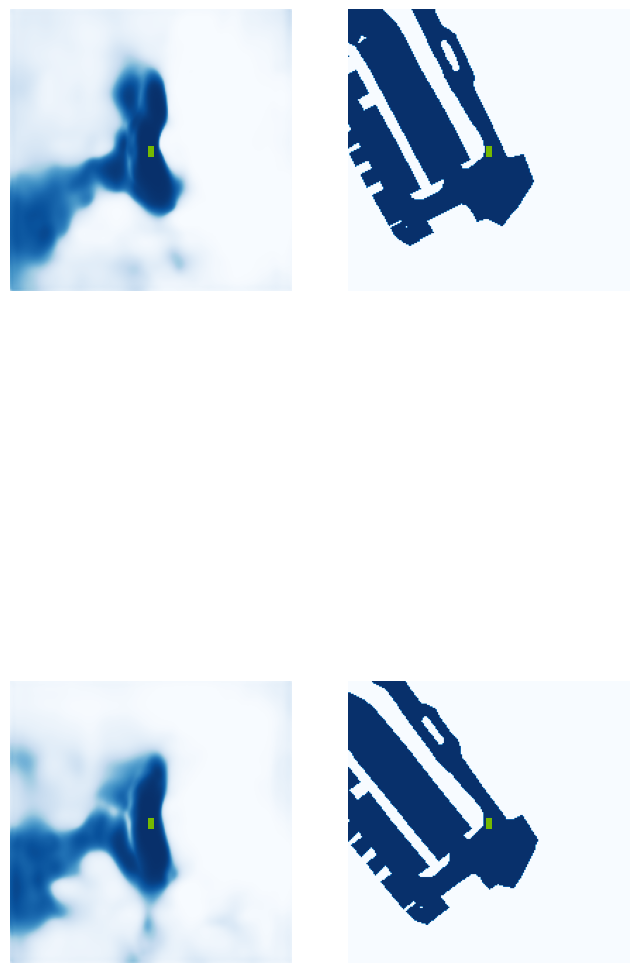

  5%|▌         | 2/40 [00:01<00:19,  1.92it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.27.jpg


 12%|█▎        | 5/40 [00:01<00:07,  4.77it/s]

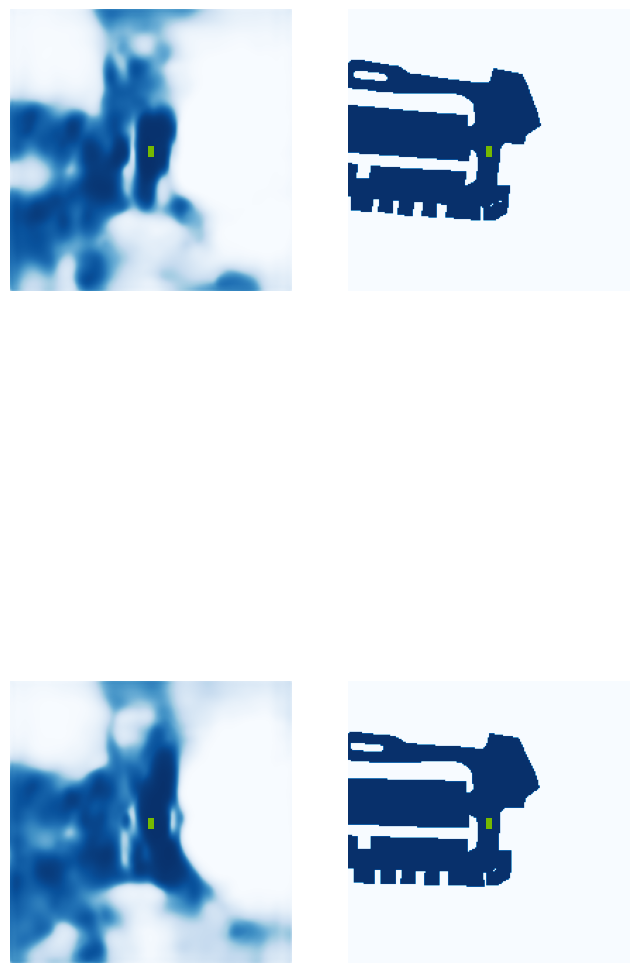

 18%|█▊        | 7/40 [00:02<00:07,  4.45it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.45.jpg


 22%|██▎       | 9/40 [00:02<00:06,  4.97it/s]

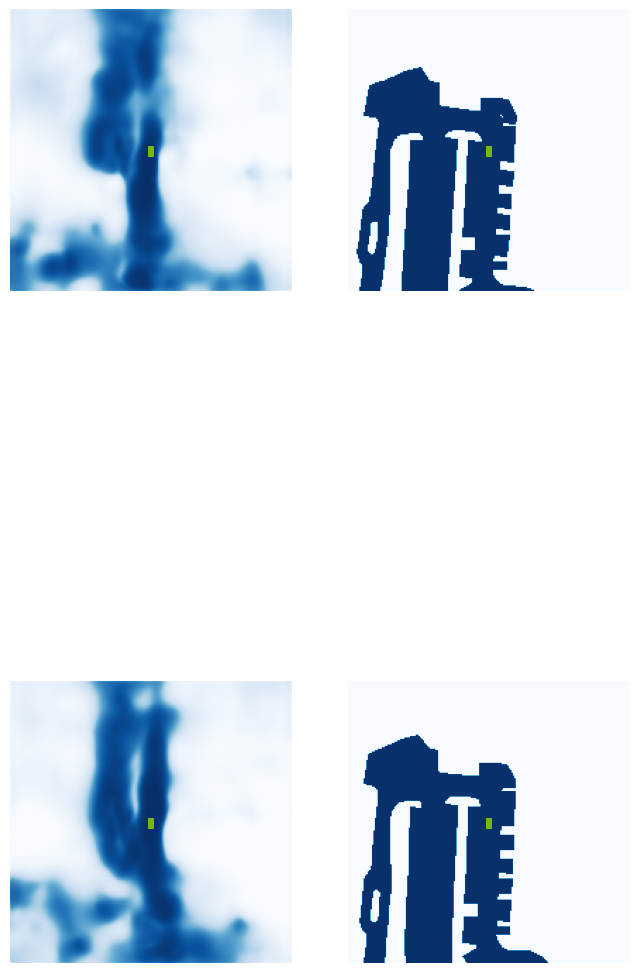

 30%|███       | 12/40 [00:03<00:06,  4.32it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.35.jpg


 38%|███▊      | 15/40 [00:03<00:05,  4.80it/s]

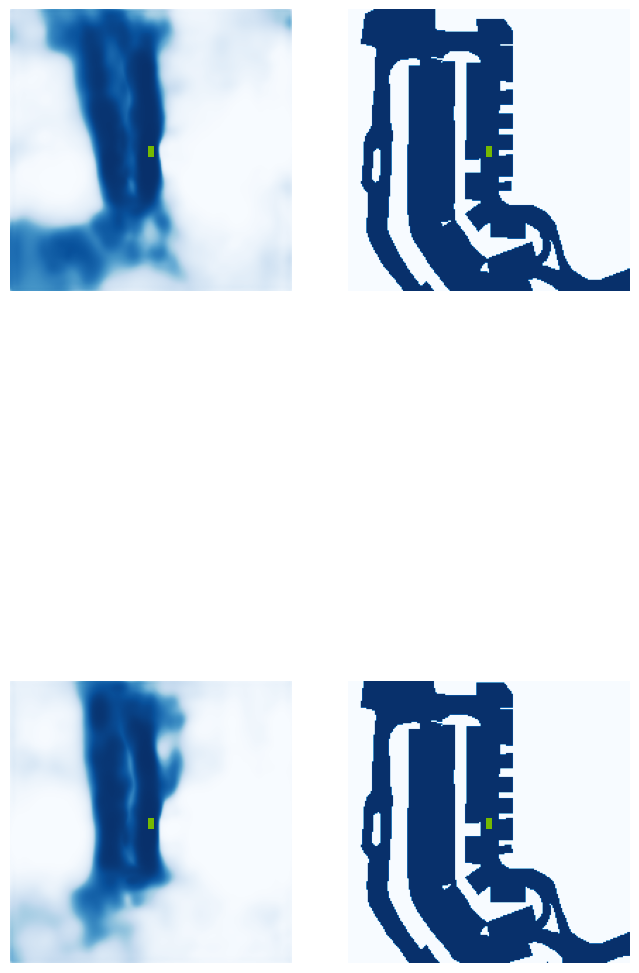

 42%|████▎     | 17/40 [00:04<00:05,  4.49it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.41.jpg


 50%|█████     | 20/40 [00:04<00:03,  5.53it/s]

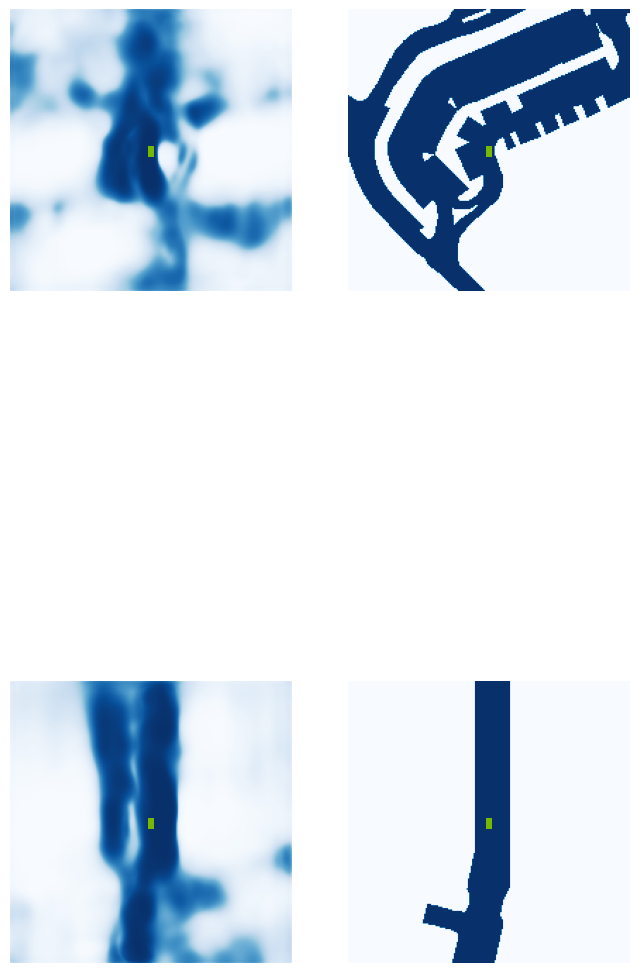

 57%|█████▊    | 23/40 [00:05<00:03,  4.68it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.29.jpg


 62%|██████▎   | 25/40 [00:05<00:02,  5.34it/s]

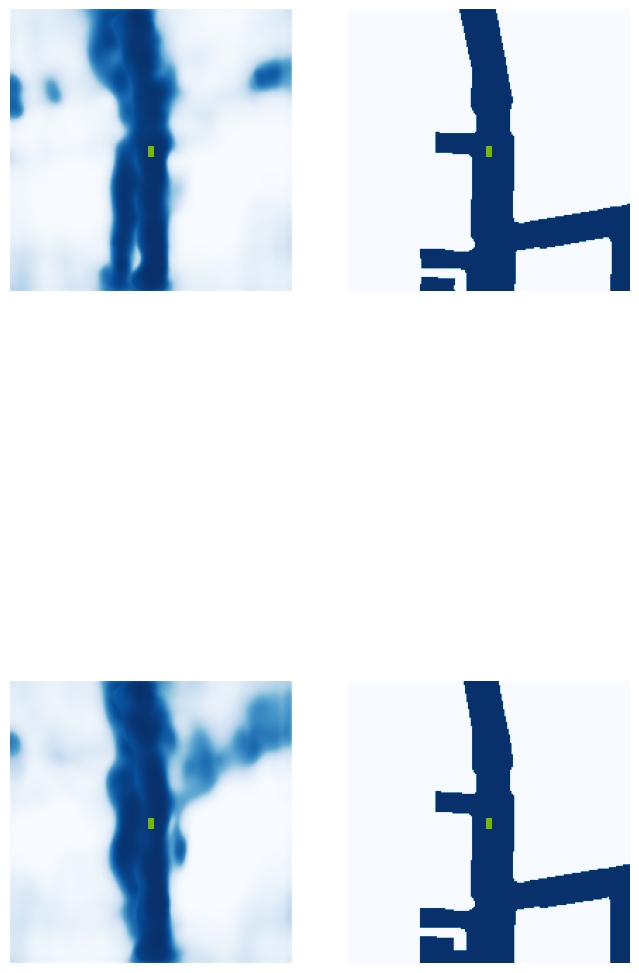

 68%|██████▊   | 27/40 [00:06<00:02,  4.78it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.41.jpg


 75%|███████▌  | 30/40 [00:06<00:01,  6.21it/s]

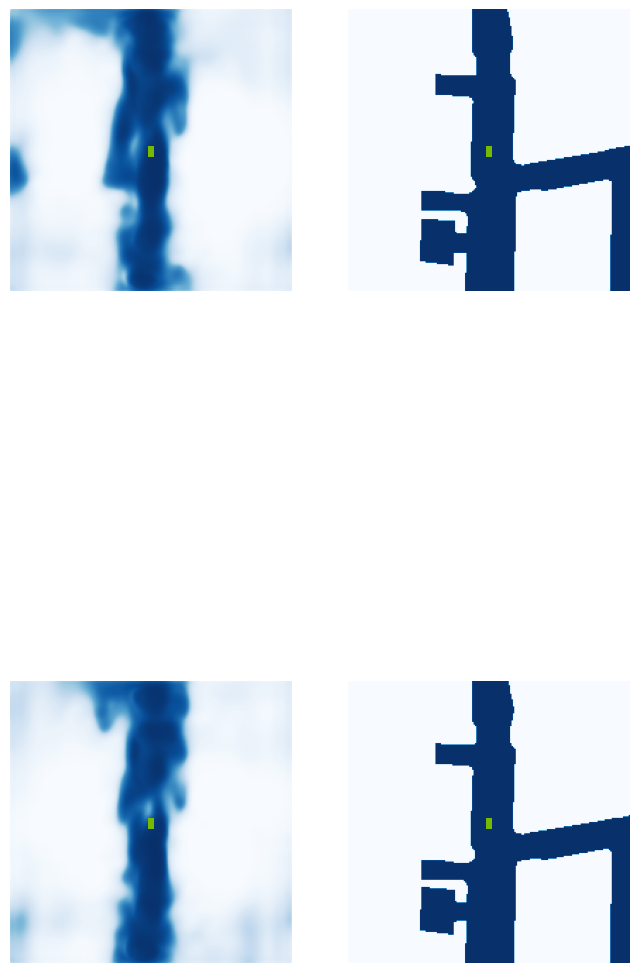

 80%|████████  | 32/40 [00:07<00:01,  4.07it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.43.jpg


 88%|████████▊ | 35/40 [00:08<00:00,  5.67it/s]

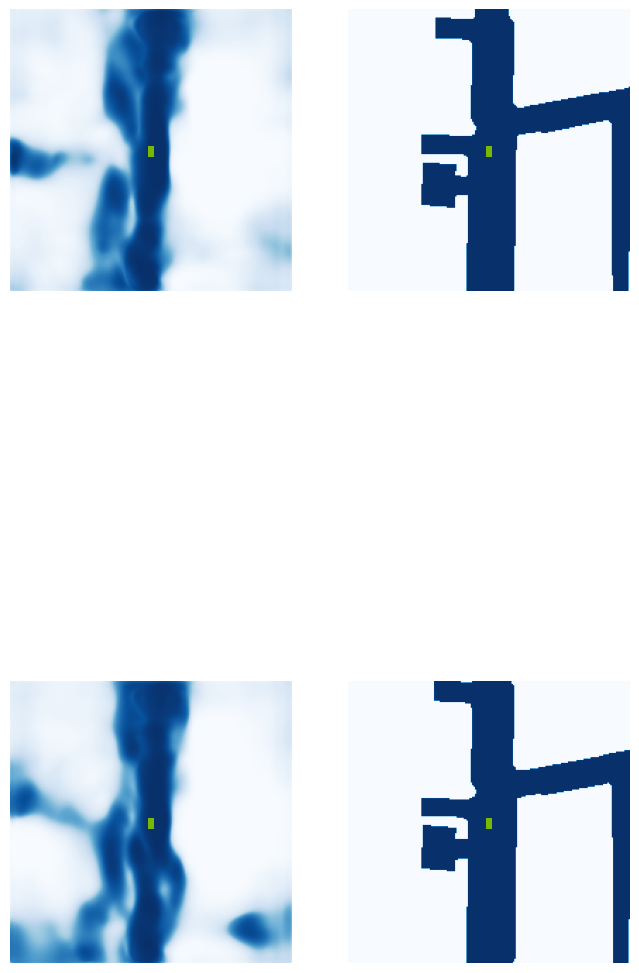

 92%|█████████▎| 37/40 [00:08<00:00,  4.51it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.41.jpg


100%|██████████| 40/40 [00:08<00:00,  4.46it/s]


VAL {'loss': 1.1105098459455702, 'iou': 0.4067224504985632}
saving ...  ./runs/model2000.pt
2010 0.29835569858551025
2020 0.13873061537742615
2030 0.2736051082611084
2040 0.23610514402389526
2050 0.39573708176612854
2060 0.21778951585292816
2070 0.17063507437705994
2080 0.16161124408245087
2090 0.33978646993637085
Epoch: 14/60
2100 0.2233772873878479
2110 0.24665109813213348
2120 0.16758441925048828
2130 0.47365906834602356
2140 0.15034279227256775
2150 0.15882746875286102
2160 0.4150650203227997
2170 0.32036757469177246
2180 0.3227218687534332
2190 0.2610796391963959
2200 0.15564800798892975
2210 0.15369096398353577
2220 0.28307509422302246
2230 0.2297525405883789
2240 0.1597820222377777
2250 0.44277244806289673
Epoch: 15/60
2260 0.36609241366386414
2270 0.5288655161857605
2280 0.1675855964422226
2290 0.15654882788658142
2300 0.342488169670105
2310 0.2721172273159027
2320 0.17878517508506775
2330 0.44954514503479004
2340 0.26042279601097107
2350 0.24905097484588623
2360 0.145297214388

  0%|          | 0/40 [00:00<?, ?it/s]

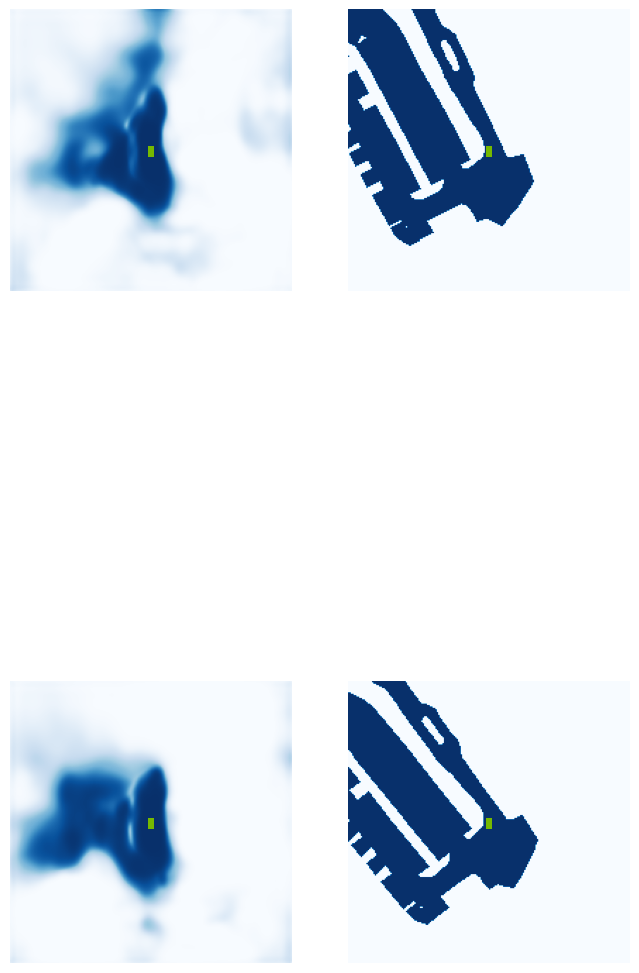

  5%|▌         | 2/40 [00:01<00:21,  1.81it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.34.jpg


 12%|█▎        | 5/40 [00:01<00:07,  4.71it/s]

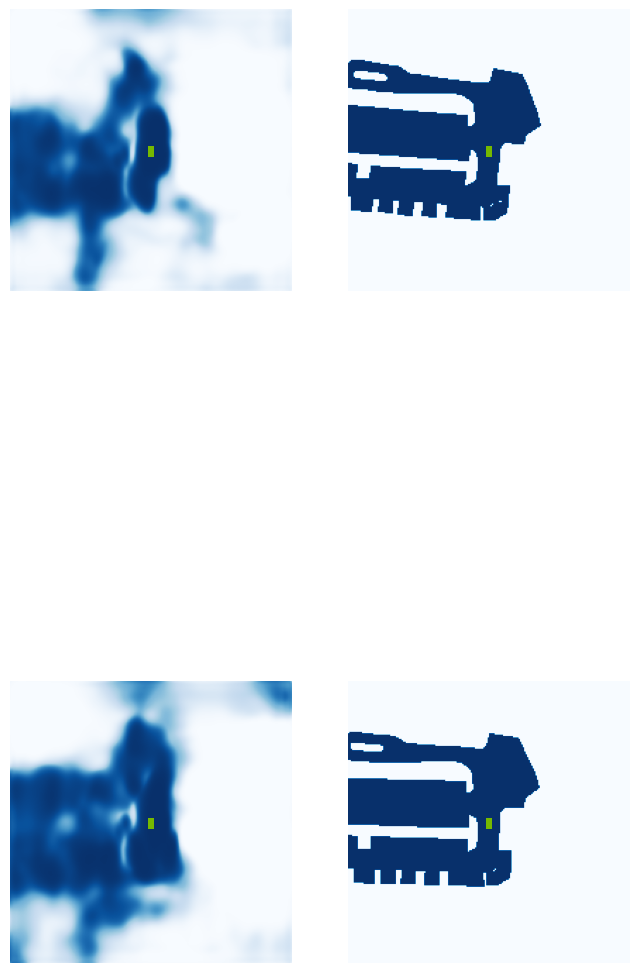

 18%|█▊        | 7/40 [00:02<00:07,  4.57it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.52.jpg


 25%|██▌       | 10/40 [00:02<00:05,  5.36it/s]

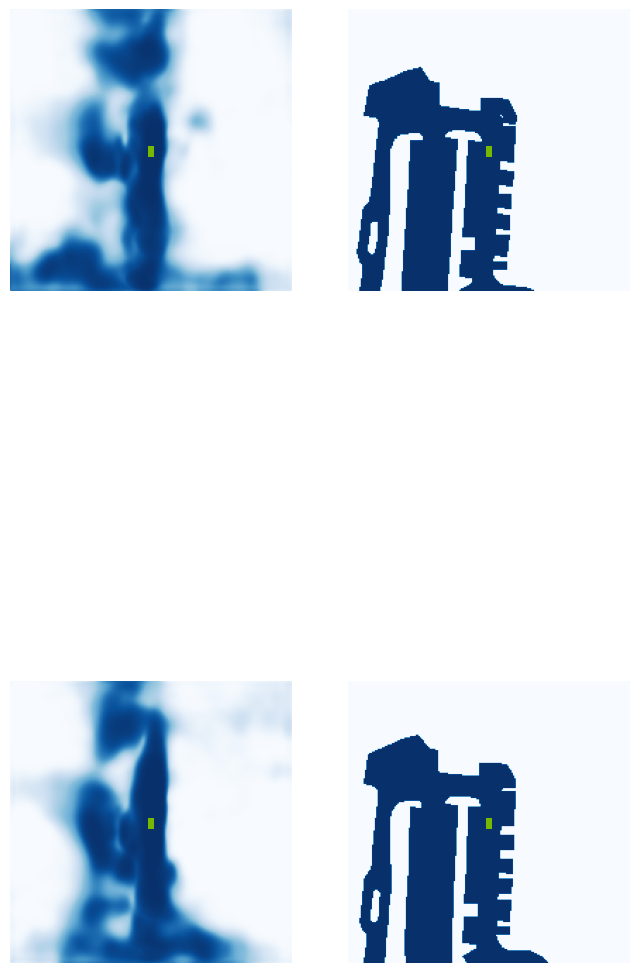

 30%|███       | 12/40 [00:03<00:07,  3.80it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.41.jpg


 38%|███▊      | 15/40 [00:03<00:05,  4.71it/s]

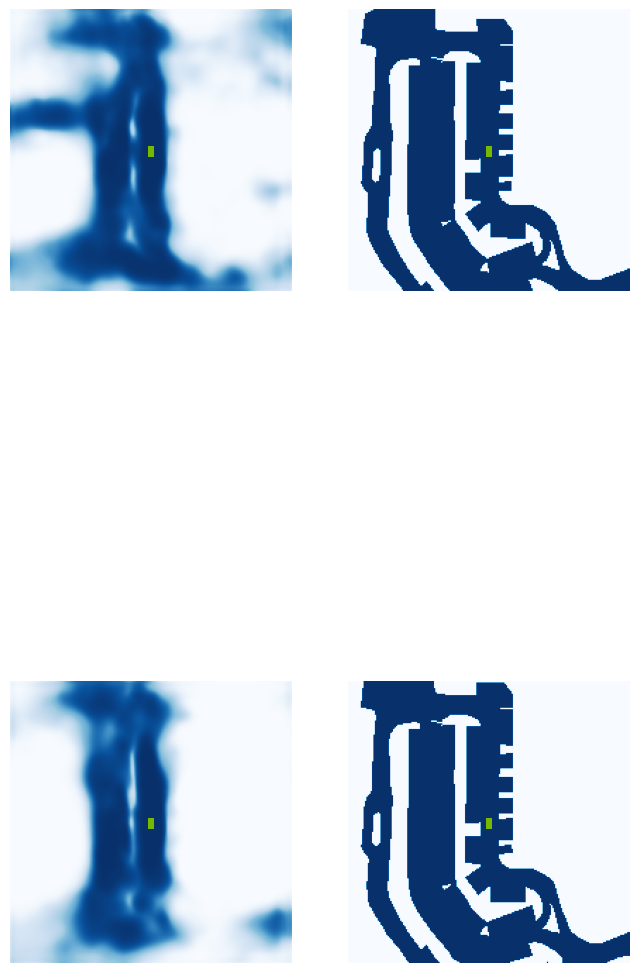

 42%|████▎     | 17/40 [00:04<00:05,  4.46it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.47.jpg


 50%|█████     | 20/40 [00:04<00:03,  5.47it/s]

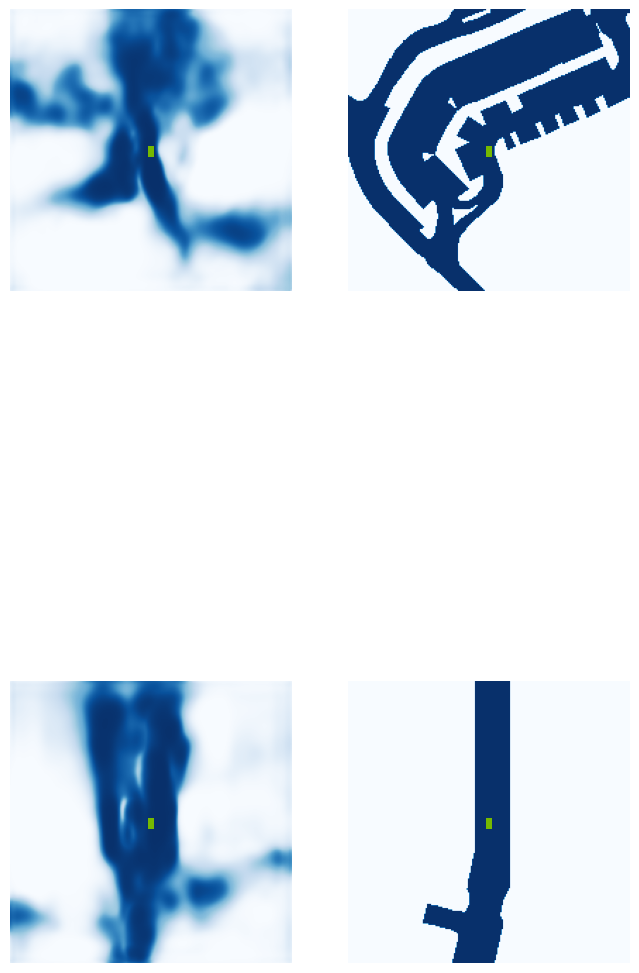

 55%|█████▌    | 22/40 [00:05<00:04,  4.00it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.36.jpg


 62%|██████▎   | 25/40 [00:06<00:02,  5.53it/s]

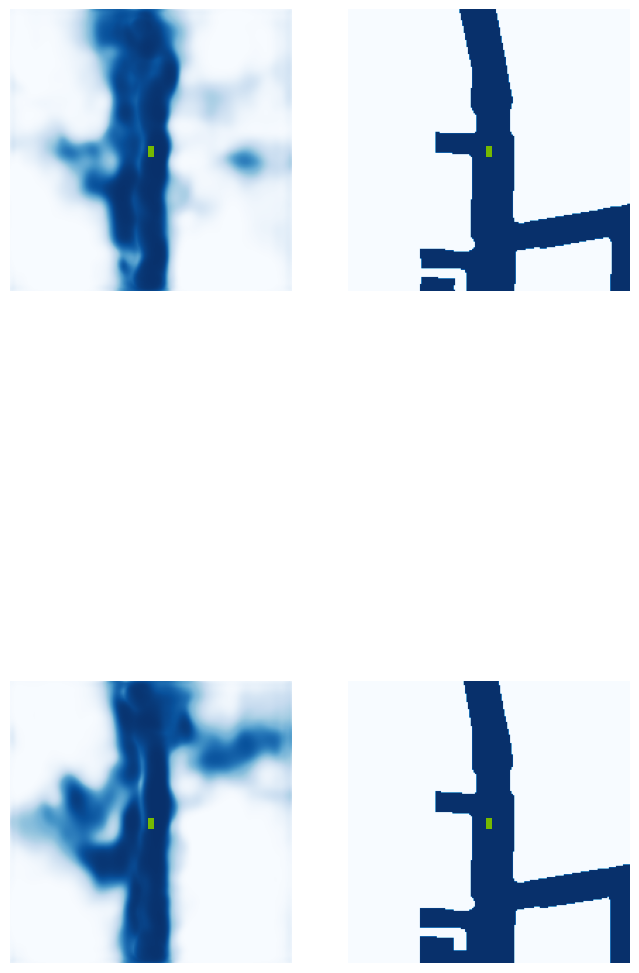

 68%|██████▊   | 27/40 [00:06<00:02,  4.78it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.38.jpg


 75%|███████▌  | 30/40 [00:06<00:01,  5.95it/s]

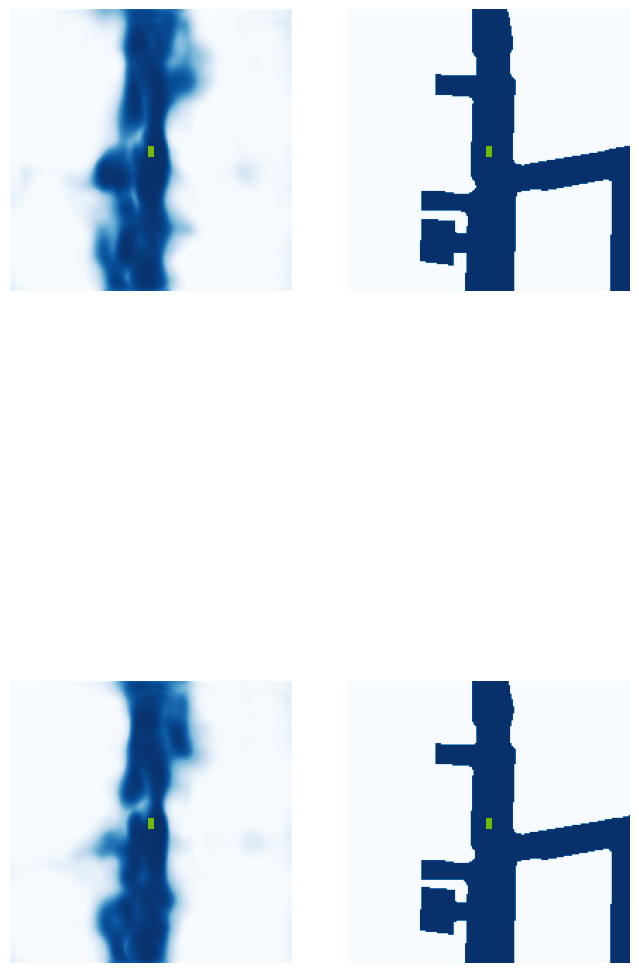

 80%|████████  | 32/40 [00:07<00:01,  4.25it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.47.jpg


 88%|████████▊ | 35/40 [00:08<00:00,  6.42it/s]

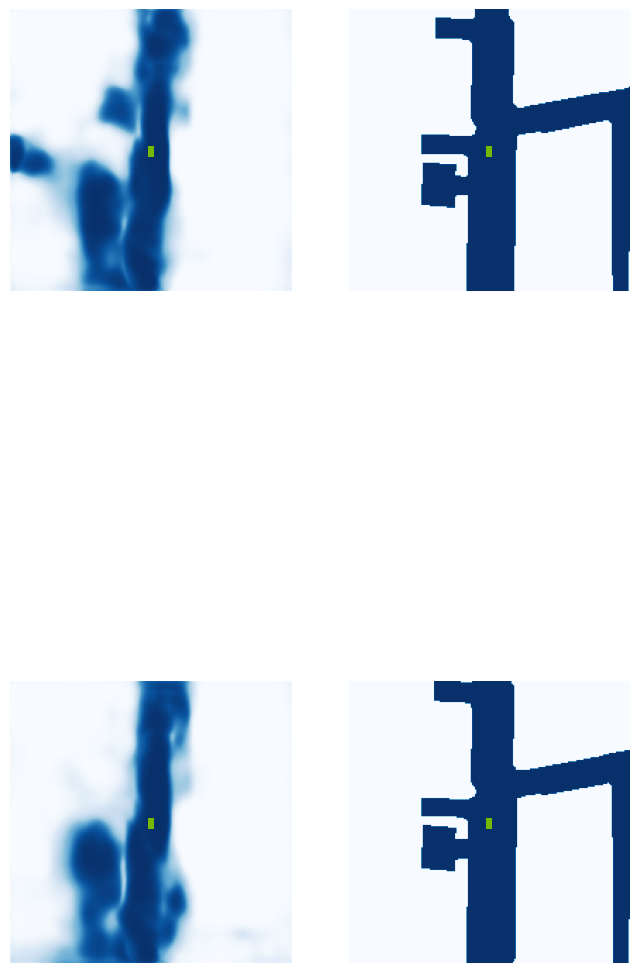

 92%|█████████▎| 37/40 [00:08<00:00,  4.44it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.42.jpg


100%|██████████| 40/40 [00:09<00:00,  4.41it/s]


VAL {'loss': 1.2061327710563754, 'iou': 0.4414701925171192}
saving ...  ./runs/model2500.pt
2510 0.4190100133419037
2520 0.1729961335659027
2530 0.2926773428916931
2540 0.11975143849849701
2550 0.18081389367580414
2560 0.21940238773822784
2570 0.13799338042736053
Epoch: 17/60
2580 0.3513084352016449
2590 0.32507529854774475
2600 0.14794325828552246
2610 0.2594797909259796
2620 0.13845843076705933
2630 0.2836756408214569
2640 0.1068645566701889
2650 0.22461454570293427
2660 0.23506388068199158
2670 0.2509749233722687
2680 0.1615133434534073
2690 0.2865856885910034
2700 0.5080026388168335
2710 0.15864774584770203
2720 0.11717817187309265
2730 0.2486291378736496
Epoch: 18/60
2740 0.18550769984722137
2750 0.23782269656658173
2760 0.28971919417381287
2770 0.17311632633209229
2780 0.19081075489521027
2790 0.20849819481372833
2800 0.2371934950351715
2810 0.31558045744895935
2820 0.2594802677631378
2830 0.18672338128089905
2840 0.1412893831729889
2850 0.202615424990654
2860 0.10292067378759384

  0%|          | 0/40 [00:00<?, ?it/s]

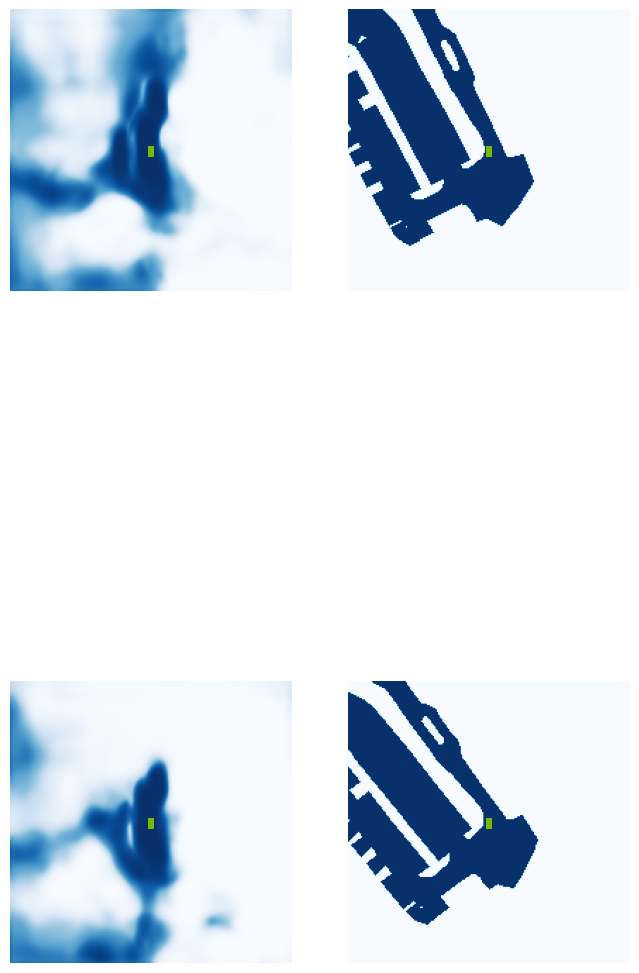

  5%|▌         | 2/40 [00:01<00:25,  1.49it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.25.jpg


 12%|█▎        | 5/40 [00:01<00:08,  4.36it/s]

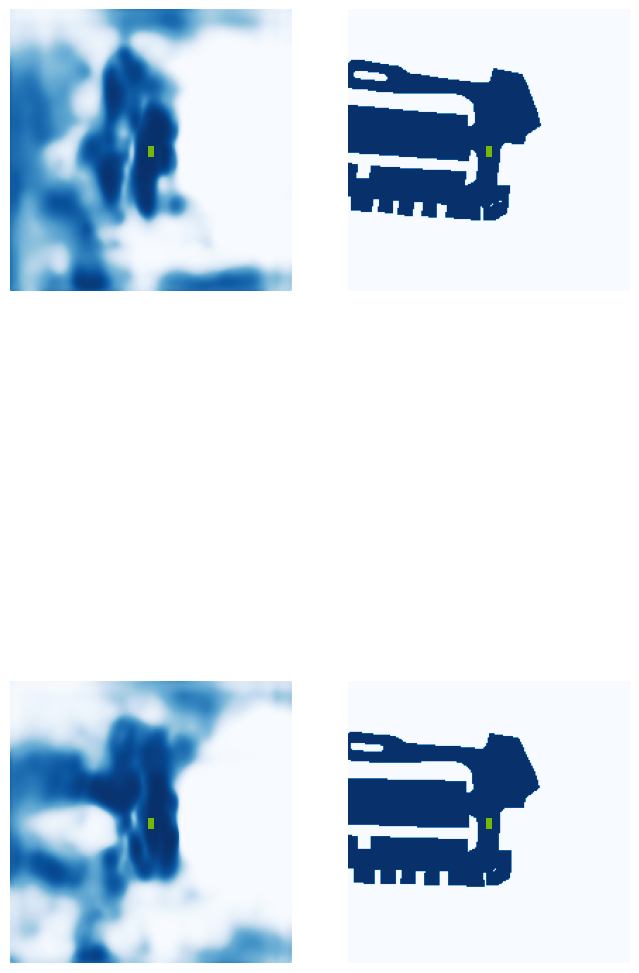

 18%|█▊        | 7/40 [00:02<00:07,  4.24it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.45.jpg


 25%|██▌       | 10/40 [00:02<00:05,  5.03it/s]

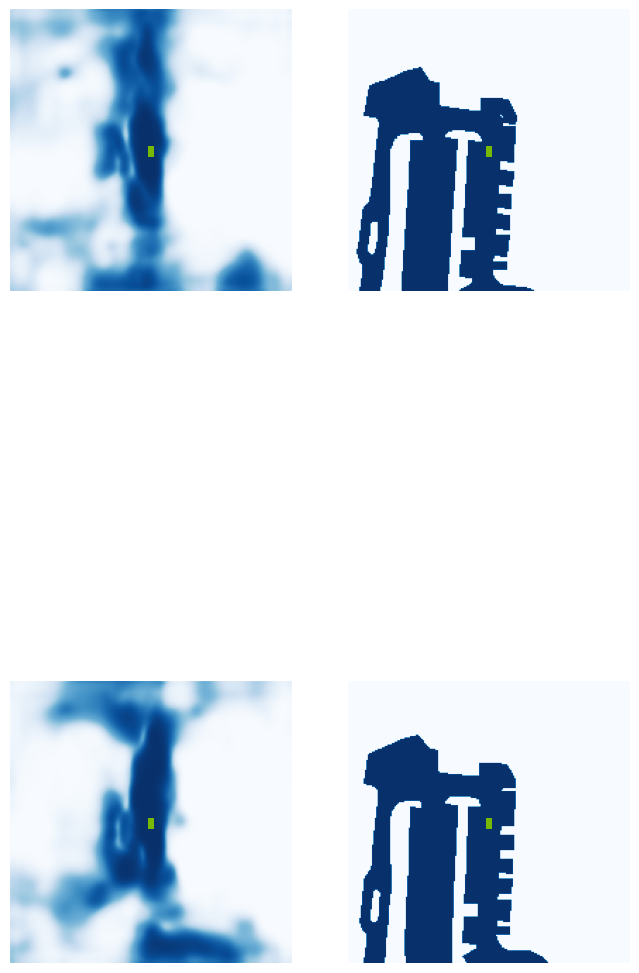

 30%|███       | 12/40 [00:03<00:06,  4.48it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.28.jpg


 38%|███▊      | 15/40 [00:04<00:04,  5.17it/s]

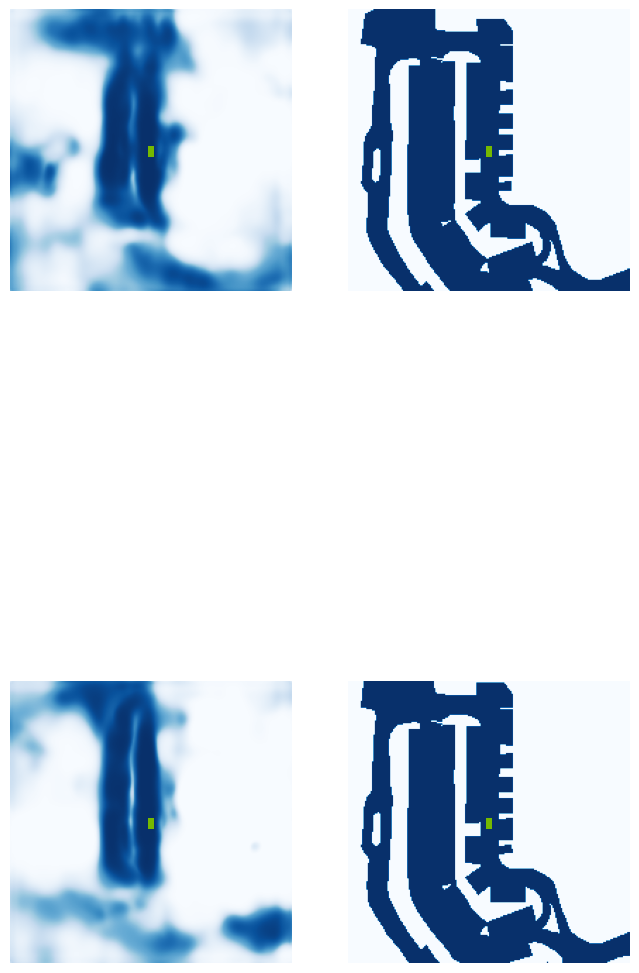

 42%|████▎     | 17/40 [00:04<00:06,  3.81it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.39.jpg


 50%|█████     | 20/40 [00:05<00:04,  4.45it/s]

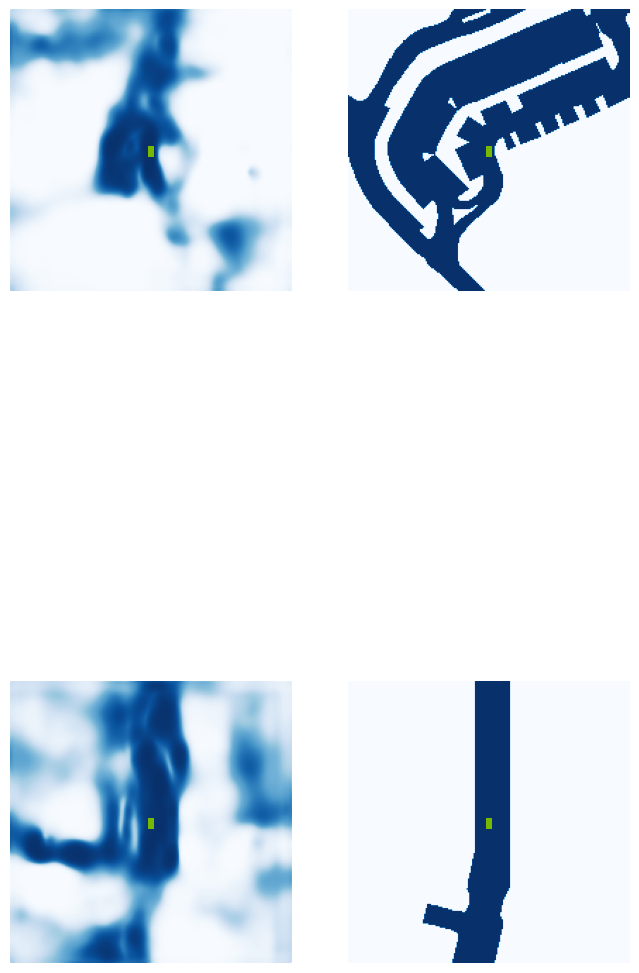

 55%|█████▌    | 22/40 [00:05<00:04,  4.06it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.27.jpg


 62%|██████▎   | 25/40 [00:06<00:02,  6.11it/s]

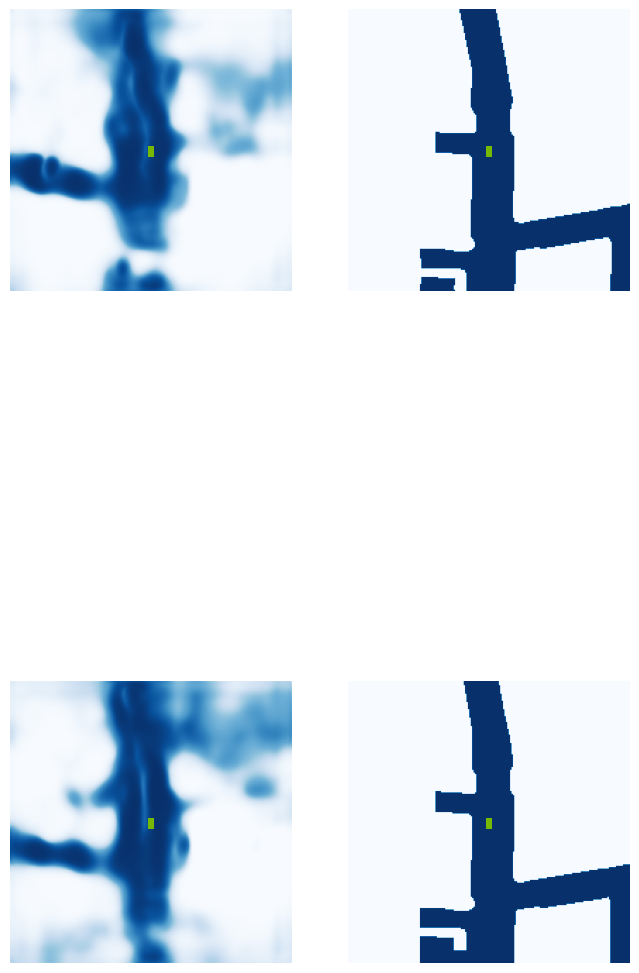

 68%|██████▊   | 27/40 [00:06<00:02,  4.42it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.34.jpg


 75%|███████▌  | 30/40 [00:07<00:01,  5.06it/s]

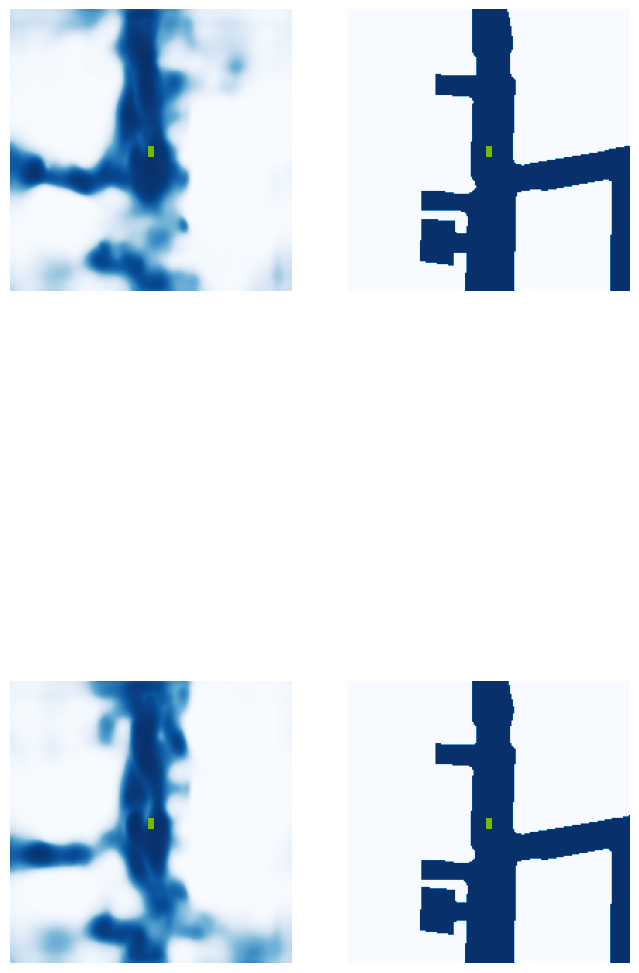

 80%|████████  | 32/40 [00:07<00:01,  4.54it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.39.jpg


 88%|████████▊ | 35/40 [00:08<00:00,  5.53it/s]

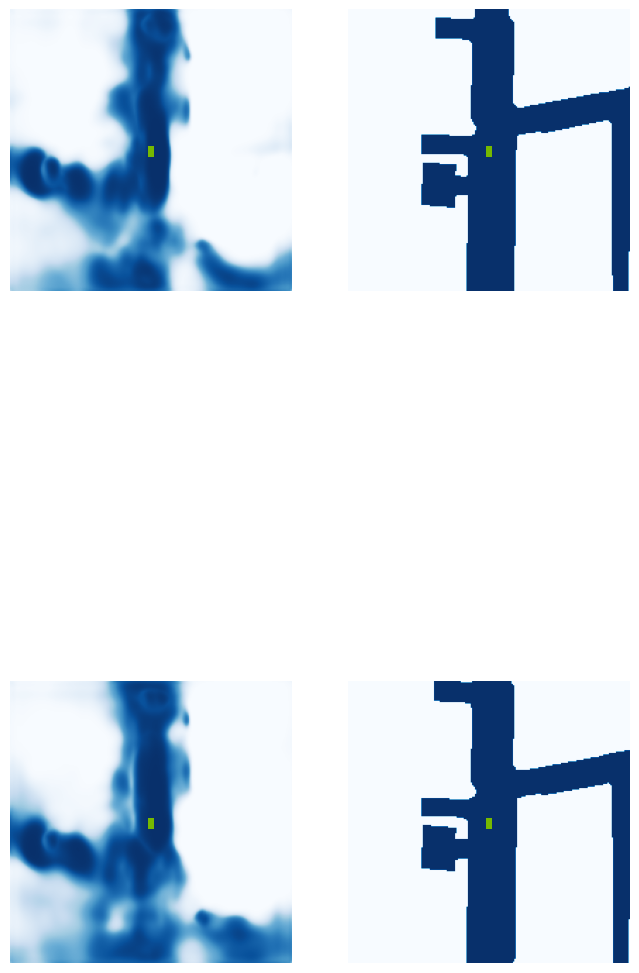

 92%|█████████▎| 37/40 [00:09<00:00,  3.97it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.40.jpg


100%|██████████| 40/40 [00:09<00:00,  4.19it/s]


VAL {'loss': 1.4309151584719435, 'iou': 0.36157311665242126}
saving ...  ./runs/model3000.pt
3010 0.18099097907543182
3020 0.2335217297077179
3030 0.14064176380634308
3040 0.29523539543151855
3050 0.20054614543914795
Epoch: 20/60
3060 0.24024838209152222
3070 0.2455538809299469
3080 0.3297725021839142
3090 0.12397325038909912
3100 0.21291005611419678
3110 0.21409972012043
3120 0.20662753283977509
3130 0.10414963215589523
3140 0.24801205098628998
3150 0.11004325747489929
3160 0.2398376166820526
3170 0.19860750436782837
3180 0.18584464490413666
3190 0.09894777834415436
3200 0.17536157369613647
3210 0.1554092913866043
3220 0.24539533257484436
Epoch: 21/60
3230 0.19814395904541016
3240 0.2856665551662445
3250 0.20416171848773956
3260 0.17519336938858032
3270 0.22829008102416992
3280 0.19809579849243164
3290 0.1897866278886795
3300 0.22912031412124634
3310 0.08767715841531754
3320 0.17869766056537628
3330 0.15114669501781464
3340 0.28783586621284485
3350 0.28536054491996765
3360 0.231896936

  0%|          | 0/40 [00:00<?, ?it/s]

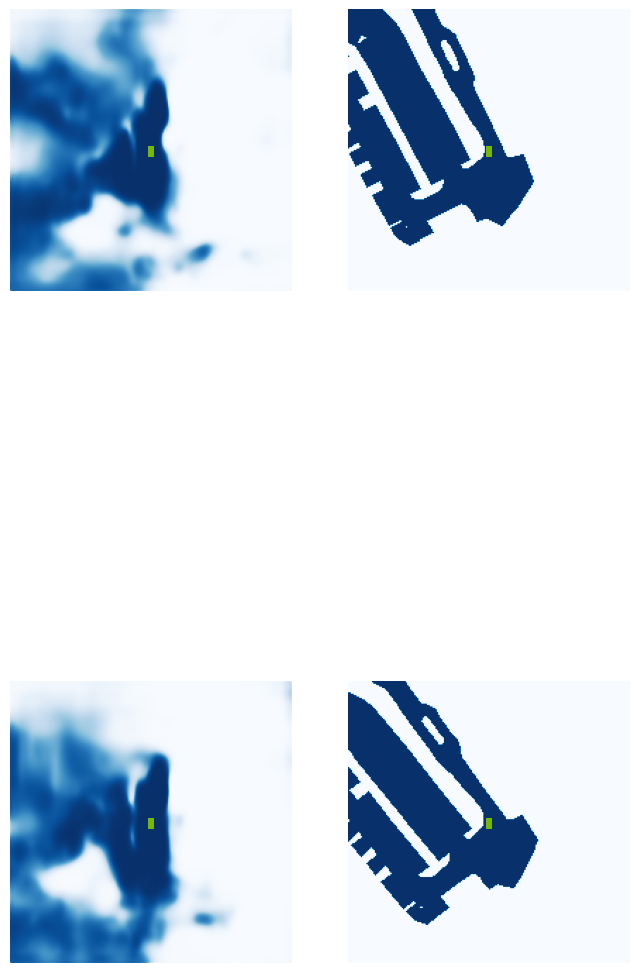

  5%|▌         | 2/40 [00:01<00:19,  1.94it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.41.jpg


 12%|█▎        | 5/40 [00:01<00:08,  4.21it/s]

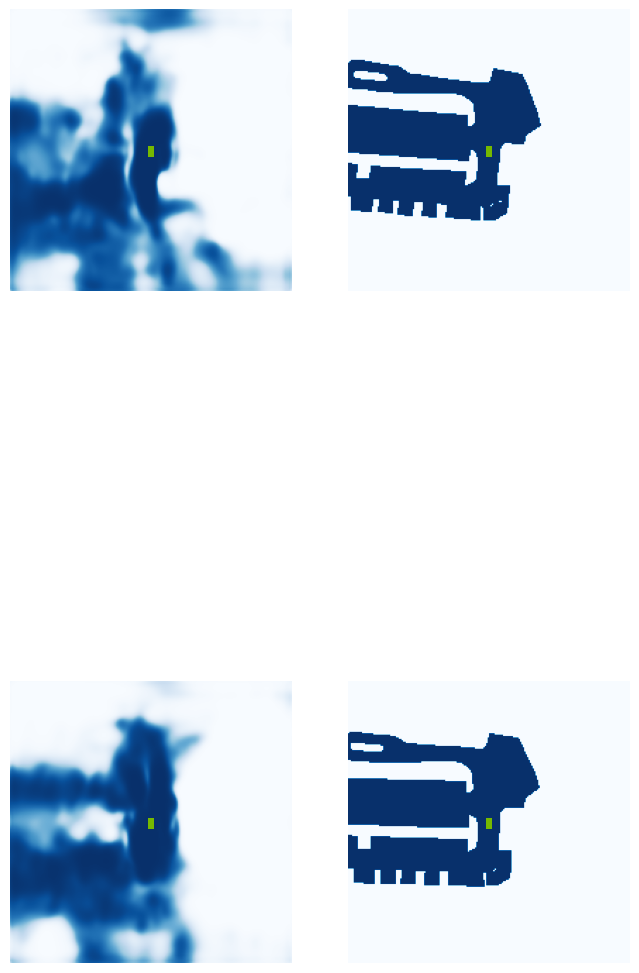

 18%|█▊        | 7/40 [00:02<00:07,  4.17it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.42.jpg


 25%|██▌       | 10/40 [00:02<00:05,  5.80it/s]

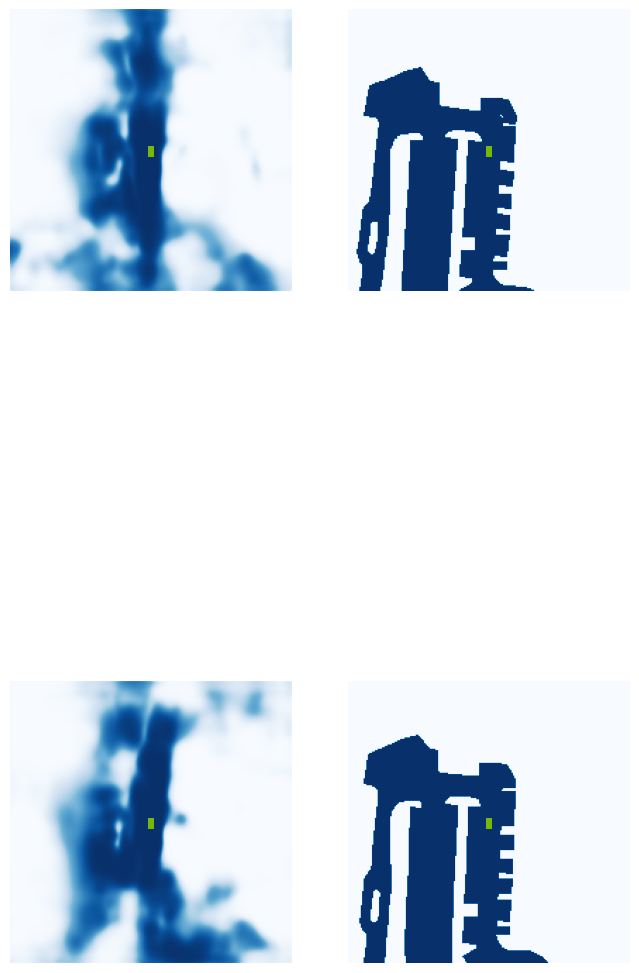

 30%|███       | 12/40 [00:03<00:06,  4.02it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.40.jpg


 38%|███▊      | 15/40 [00:03<00:05,  4.67it/s]

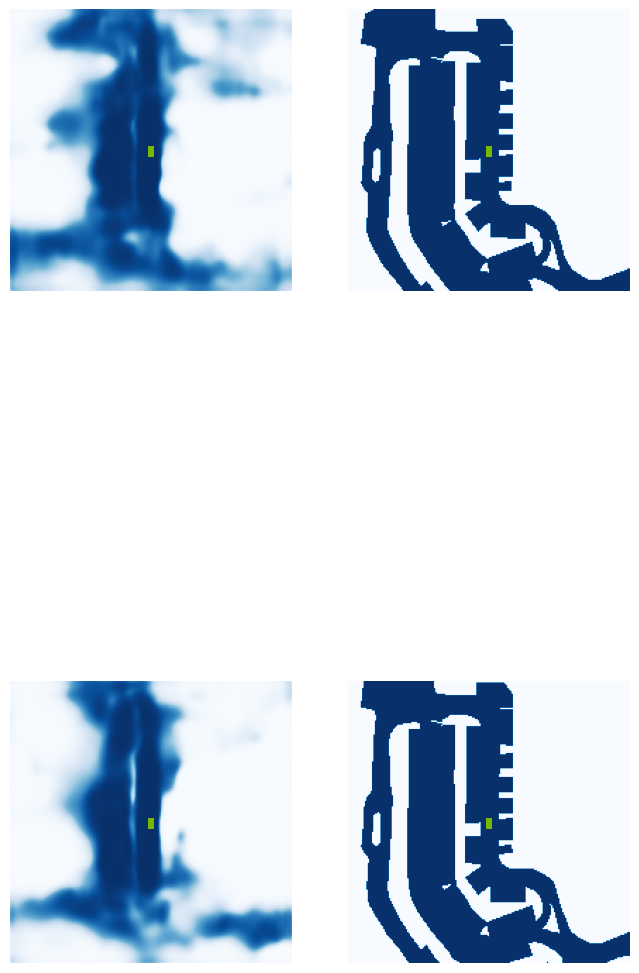

 42%|████▎     | 17/40 [00:04<00:07,  3.23it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.47.jpg


 48%|████▊     | 19/40 [00:05<00:04,  4.68it/s]

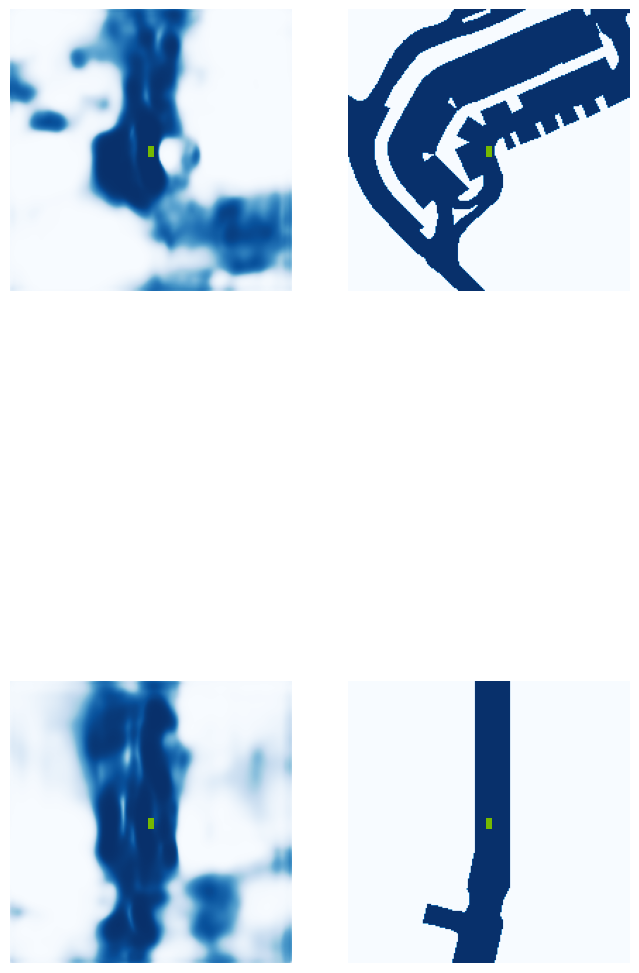

 55%|█████▌    | 22/40 [00:05<00:03,  4.80it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.28.jpg


 62%|██████▎   | 25/40 [00:06<00:02,  6.00it/s]

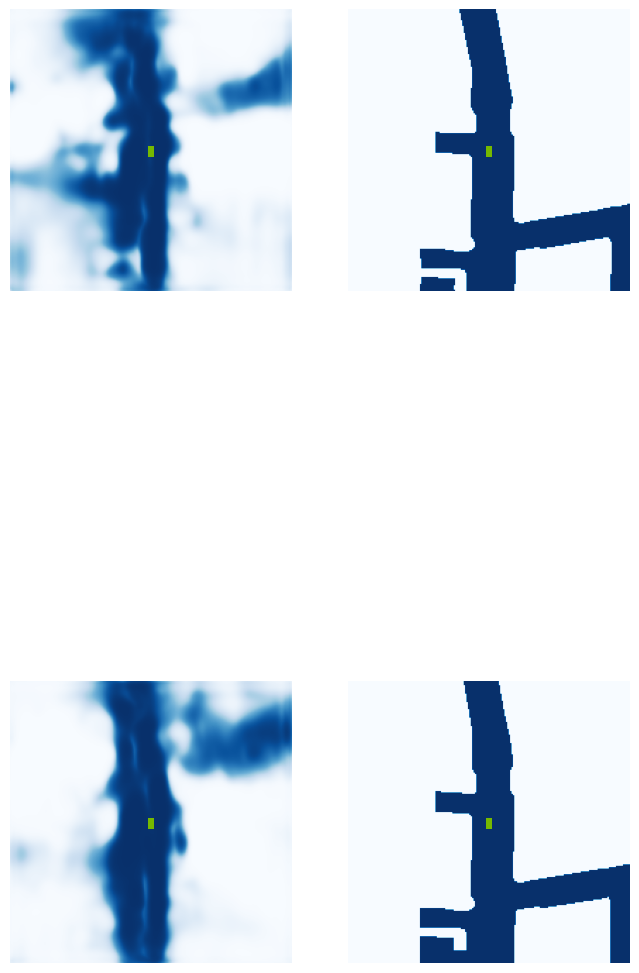

 68%|██████▊   | 27/40 [00:06<00:02,  4.80it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.35.jpg


 75%|███████▌  | 30/40 [00:06<00:01,  6.58it/s]

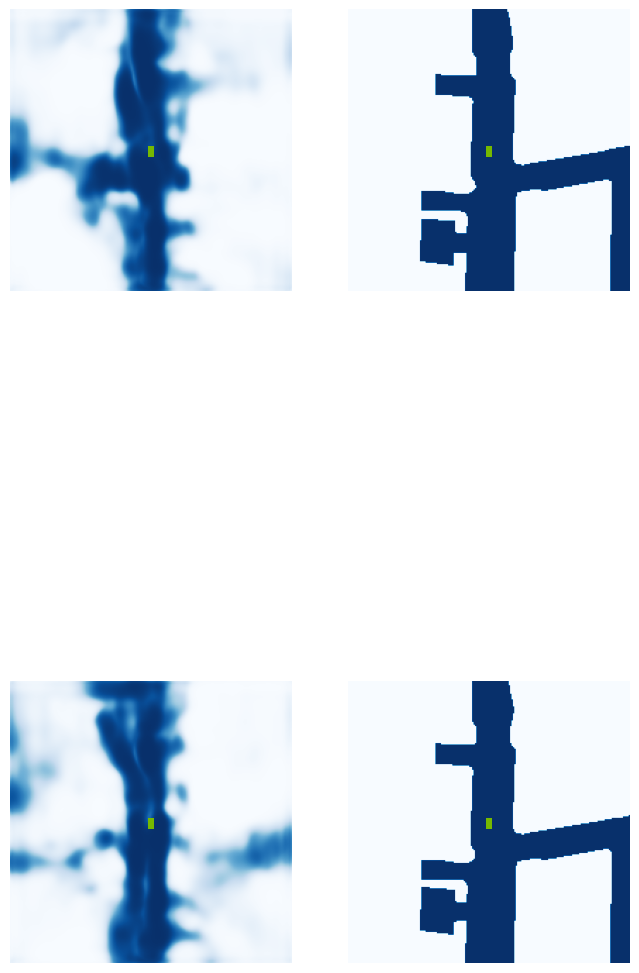

 80%|████████  | 32/40 [00:07<00:01,  4.05it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.45.jpg


 88%|████████▊ | 35/40 [00:08<00:00,  5.70it/s]

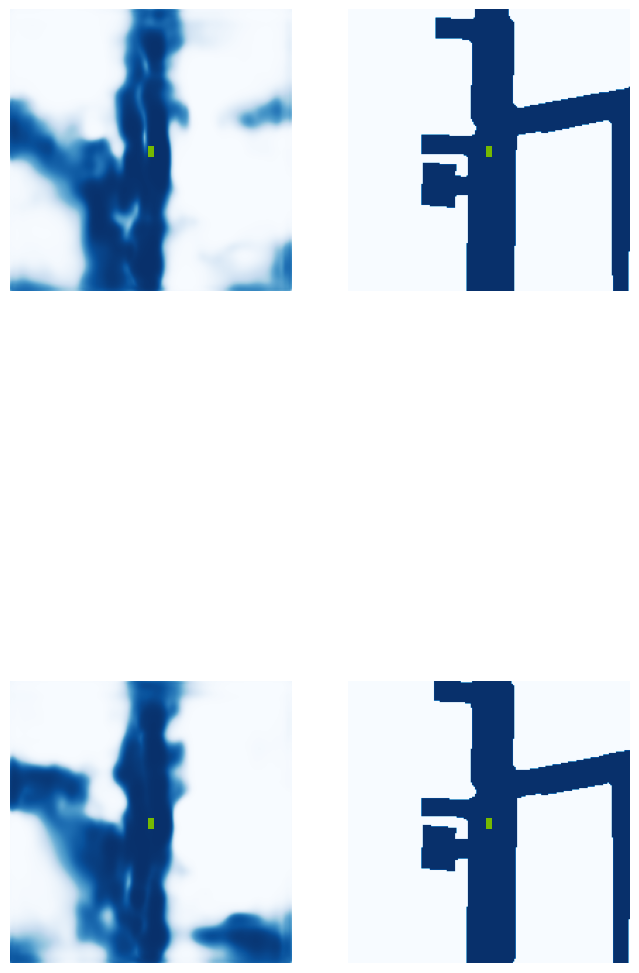

 92%|█████████▎| 37/40 [00:08<00:00,  4.76it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.40.jpg


100%|██████████| 40/40 [00:09<00:00,  4.39it/s]


VAL {'loss': 1.2663563063115248, 'iou': 0.4024857772358466}
saving ...  ./runs/model3500.pt
3510 0.27177542448043823
3520 0.25139641761779785
3530 0.10617700219154358
3540 0.0673607736825943
Epoch: 23/60
3550 0.08852216601371765
3560 0.13392484188079834
3570 0.08710260689258575
3580 0.18833564221858978
3590 0.11335771530866623
3600 0.118965283036232
3610 0.10498277097940445
3620 0.16481412947177887
3630 0.17956915497779846
3640 0.22136320173740387
3650 0.20991241931915283
3660 0.1342620998620987
3670 0.23883256316184998
3680 0.5184524059295654
3690 0.08731426298618317
3700 0.09388493001461029
Epoch: 24/60
3710 0.15922601521015167
3720 0.15345482528209686
3730 0.18101263046264648
3740 0.07729627192020416
3750 0.20146821439266205
3760 0.07404371351003647
3770 0.1670645922422409
3780 0.20893238484859467
3790 0.10414336621761322
3800 0.19720600545406342
3810 0.179047629237175
3820 0.23273956775665283
3830 0.1452377289533615
3840 0.18669672310352325
3850 0.2867778241634369
3860 0.2111892998

  0%|          | 0/40 [00:00<?, ?it/s]

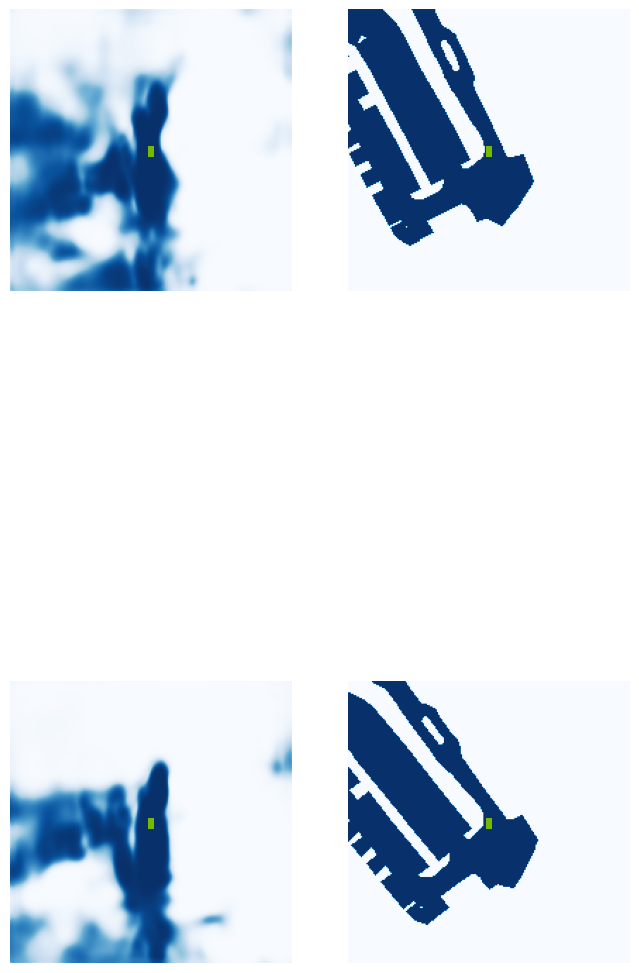

  5%|▌         | 2/40 [00:01<00:19,  1.97it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.32.jpg


 12%|█▎        | 5/40 [00:01<00:08,  4.27it/s]

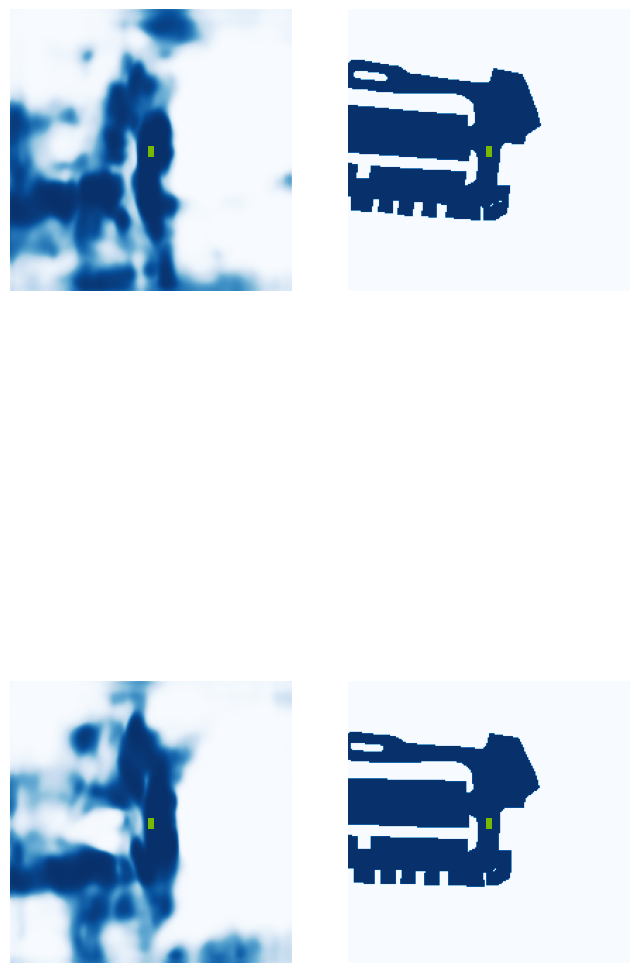

 18%|█▊        | 7/40 [00:02<00:07,  4.18it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.37.jpg


 22%|██▎       | 9/40 [00:02<00:06,  4.64it/s]

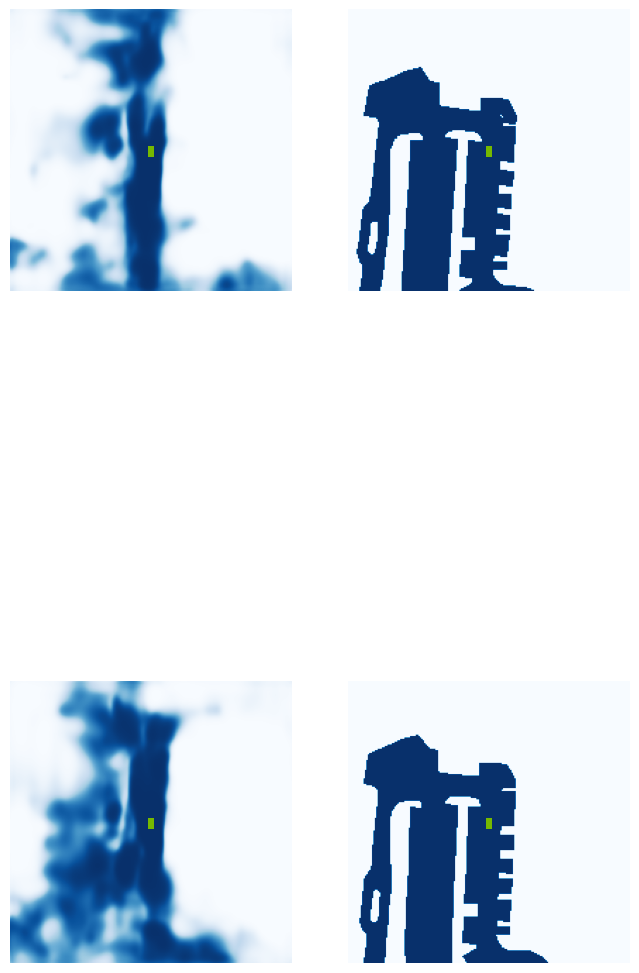

 32%|███▎      | 13/40 [00:03<00:05,  4.66it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.39.jpg


 38%|███▊      | 15/40 [00:03<00:05,  4.95it/s]

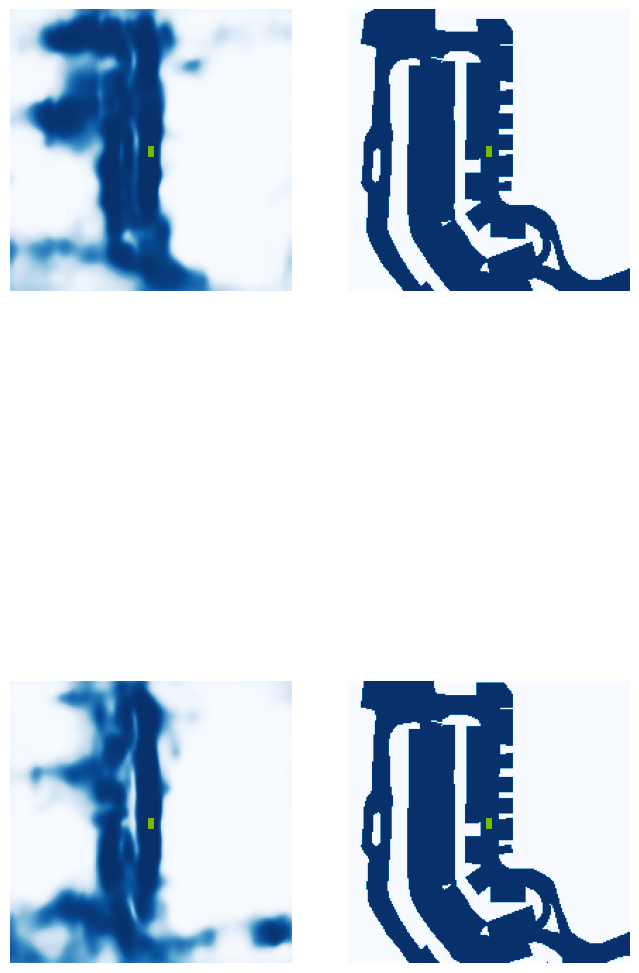

 42%|████▎     | 17/40 [00:04<00:05,  4.28it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.46.jpg


 48%|████▊     | 19/40 [00:04<00:04,  5.19it/s]

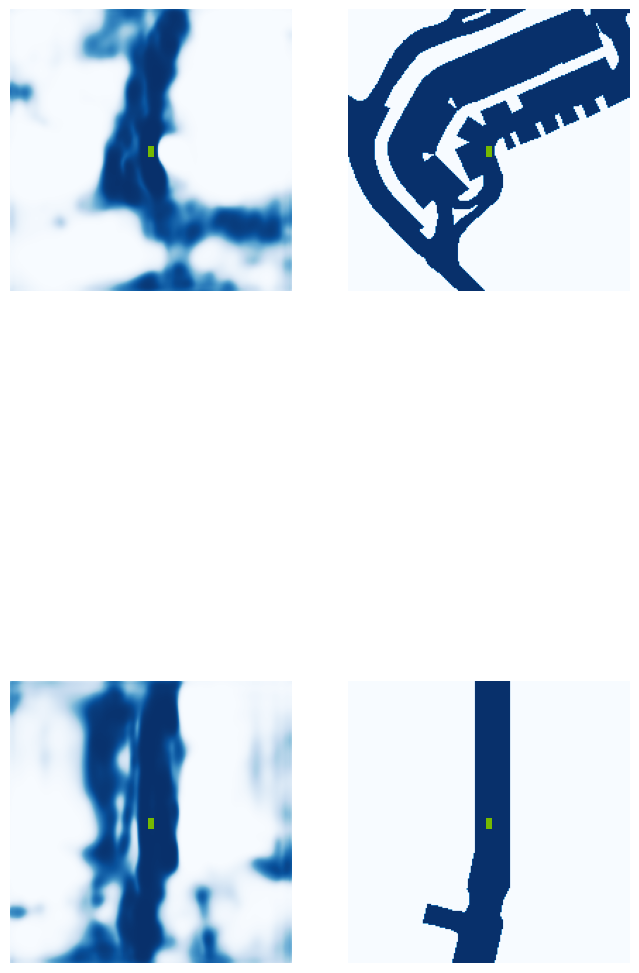

 57%|█████▊    | 23/40 [00:05<00:03,  4.85it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.27.jpg


 62%|██████▎   | 25/40 [00:06<00:02,  5.07it/s]

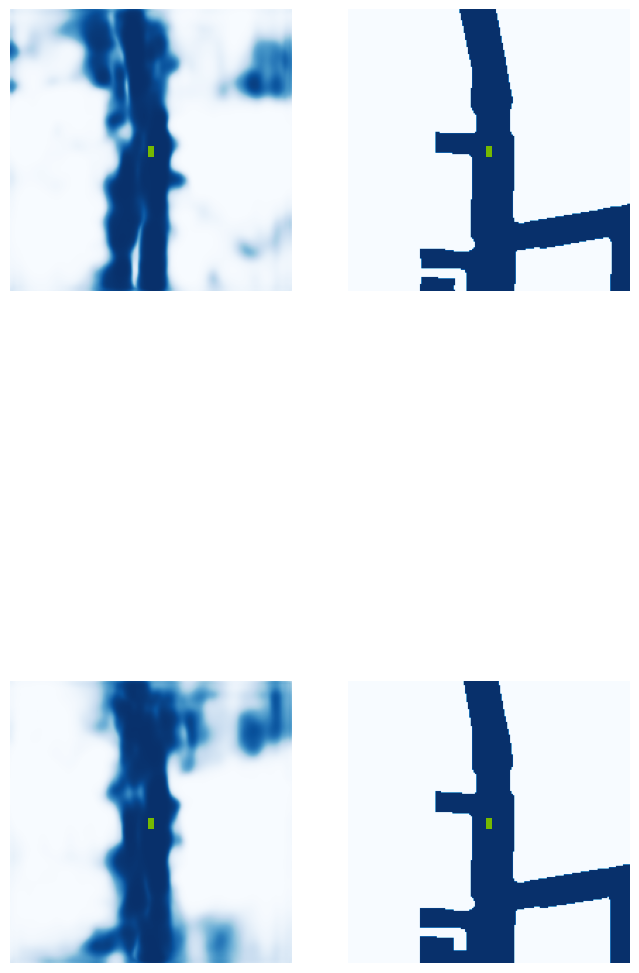

 68%|██████▊   | 27/40 [00:06<00:02,  4.42it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.40.jpg


 75%|███████▌  | 30/40 [00:07<00:01,  6.22it/s]

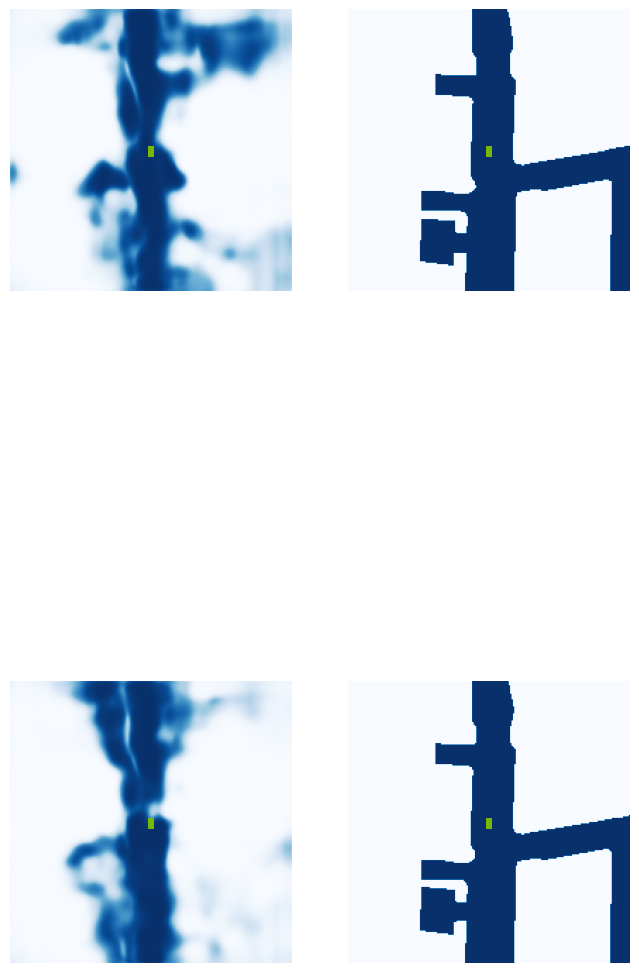

 80%|████████  | 32/40 [00:08<00:02,  3.20it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.41.jpg


 88%|████████▊ | 35/40 [00:08<00:00,  5.53it/s]

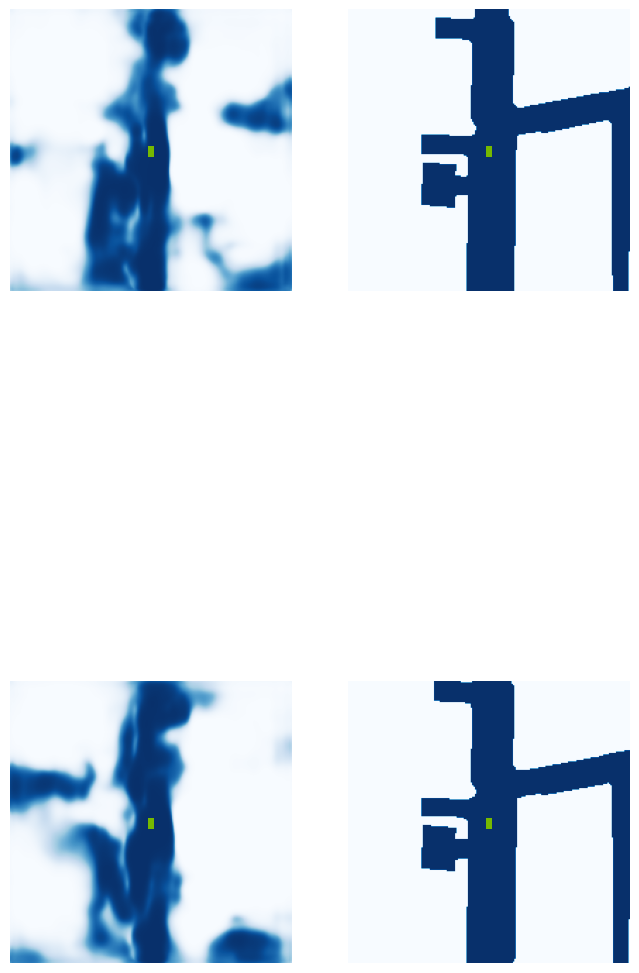

 92%|█████████▎| 37/40 [00:09<00:00,  4.51it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.45.jpg


100%|██████████| 40/40 [00:09<00:00,  4.25it/s]


VAL {'loss': 1.4036504957411025, 'iou': 0.3901143097506439}
saving ...  ./runs/model4000.pt
4010 0.23473992943763733
4020 0.18936659395694733
Epoch: 26/60
4030 0.22612860798835754
4040 0.24292701482772827
4050 0.15911103785037994
4060 0.08637966215610504
4070 0.2325887680053711
4080 0.21462538838386536
4090 0.1334230750799179
4100 0.09153091907501221
4110 0.17510604858398438
4120 0.23899371922016144
4130 0.17343659698963165
4140 0.13881415128707886
4150 0.09894511848688126
4160 0.20476973056793213
4170 0.19602231681346893
4180 0.15884873270988464
Epoch: 27/60
4190 0.11198903620243073
4200 0.07455359399318695
4210 0.16996070742607117
4220 0.22654972970485687
4230 0.29151976108551025
4240 0.0831214115023613
4250 0.09036707878112793
4260 0.17275846004486084
4270 0.20357392728328705
4280 0.39555710554122925
4290 0.13442909717559814
4300 0.25464382767677307
4310 0.11366618424654007
4320 0.13698332011699677
4330 0.24318134784698486
4340 0.17254772782325745
Epoch: 28/60
4350 0.118935406208038

  0%|          | 0/40 [00:00<?, ?it/s]

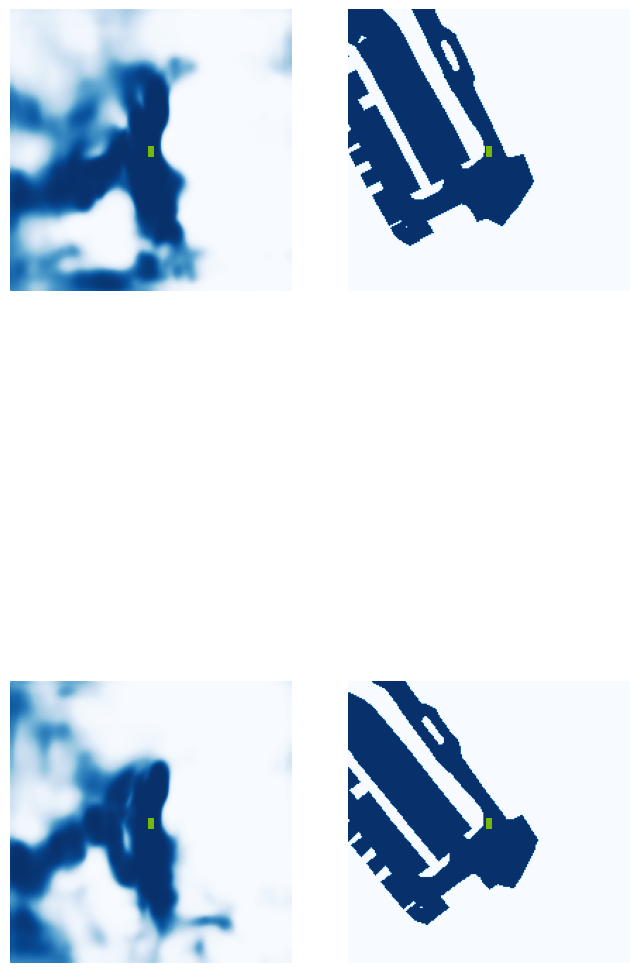

  5%|▌         | 2/40 [00:01<00:19,  1.95it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.34.jpg


 12%|█▎        | 5/40 [00:01<00:08,  4.13it/s]

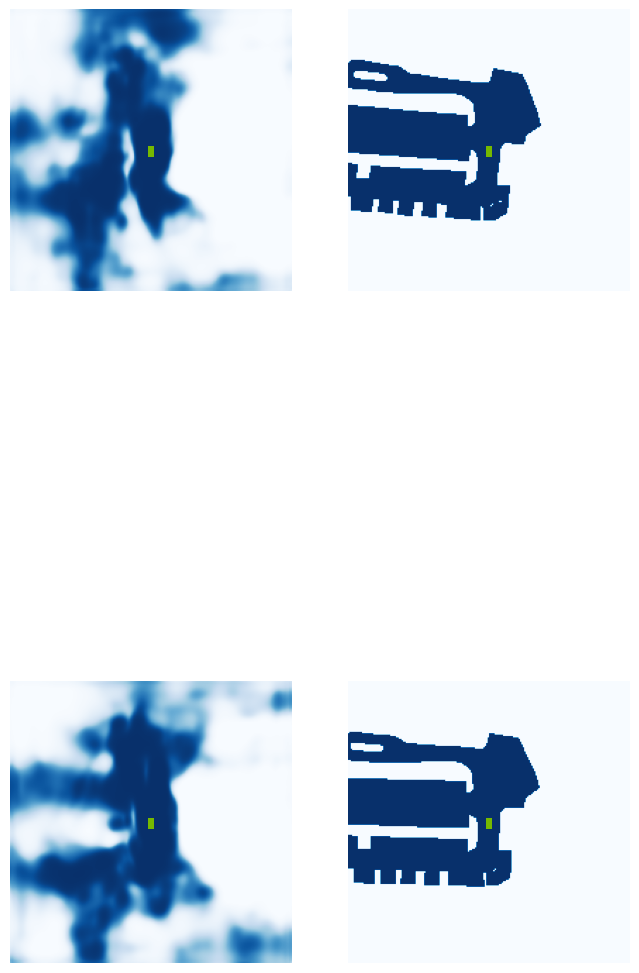

 18%|█▊        | 7/40 [00:02<00:08,  4.05it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.40.jpg


 25%|██▌       | 10/40 [00:02<00:05,  5.36it/s]

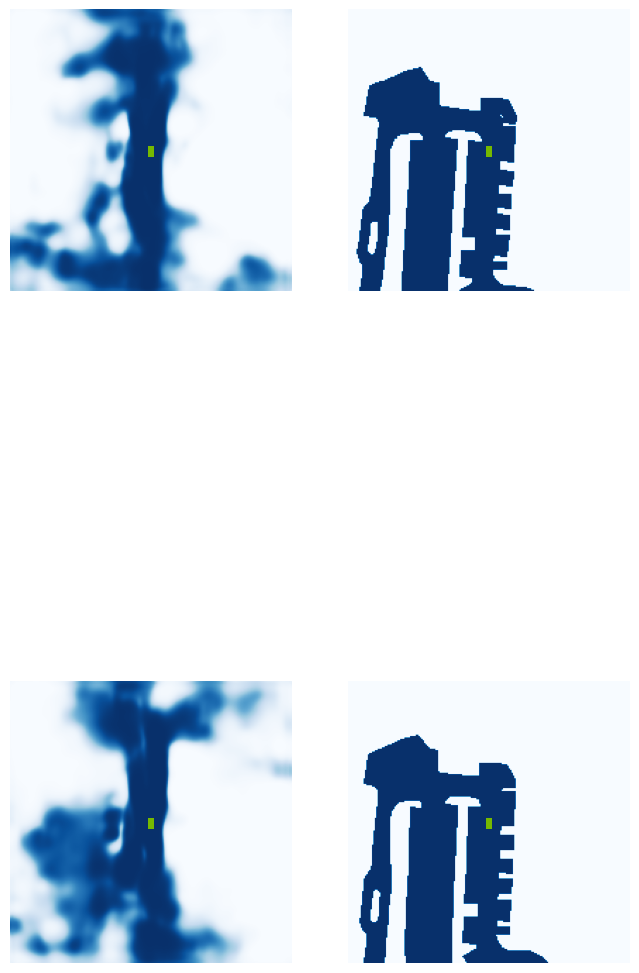

 30%|███       | 12/40 [00:03<00:07,  3.71it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.37.jpg


 38%|███▊      | 15/40 [00:04<00:05,  4.44it/s]

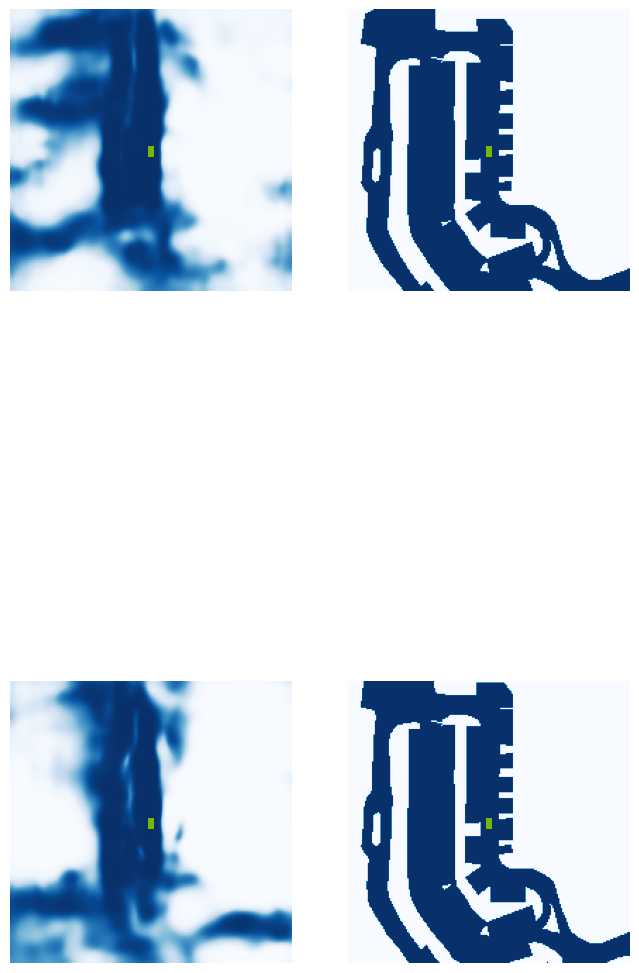

 42%|████▎     | 17/40 [00:04<00:05,  3.98it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.48.jpg


 50%|█████     | 20/40 [00:05<00:03,  5.92it/s]

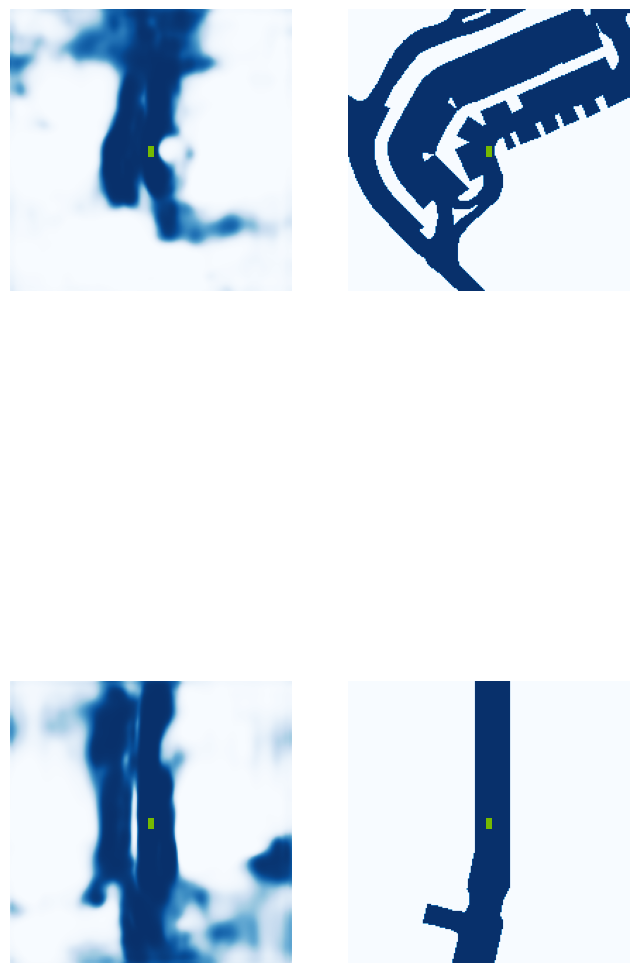

 55%|█████▌    | 22/40 [00:05<00:04,  3.88it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.30.jpg


 62%|██████▎   | 25/40 [00:06<00:02,  5.16it/s]

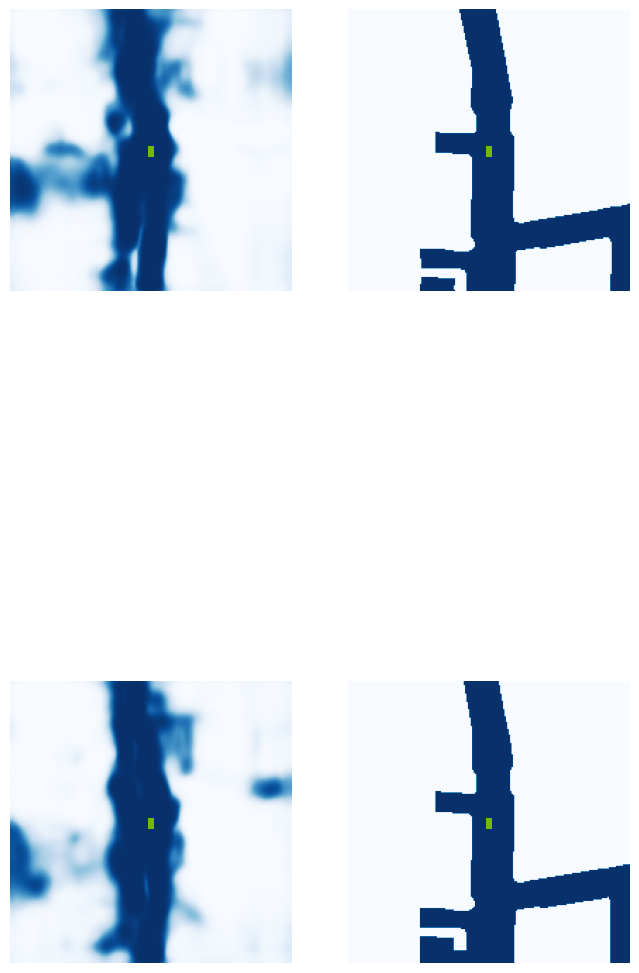

 68%|██████▊   | 27/40 [00:06<00:03,  4.29it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.41.jpg


 75%|███████▌  | 30/40 [00:07<00:01,  6.43it/s]

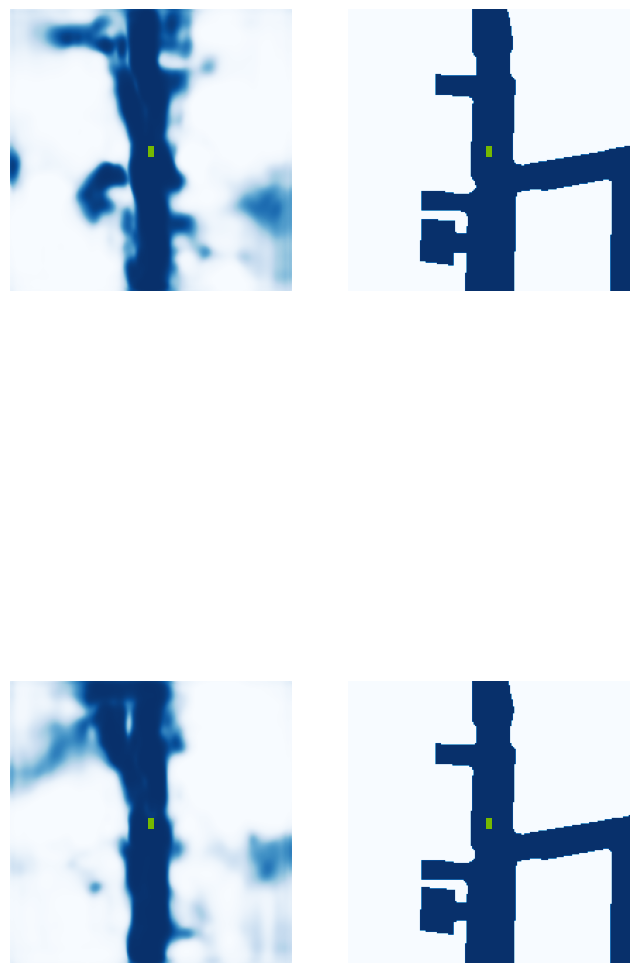

 82%|████████▎ | 33/40 [00:08<00:01,  4.79it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.46.jpg


 88%|████████▊ | 35/40 [00:08<00:00,  5.53it/s]

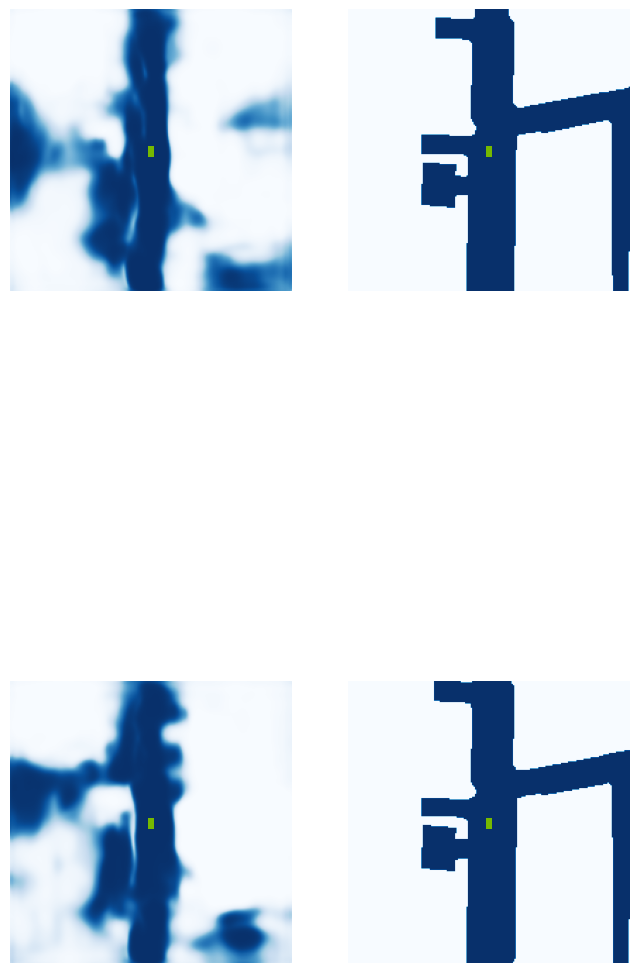

 90%|█████████ | 36/40 [00:08<00:00,  4.16it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.40.jpg


100%|██████████| 40/40 [00:09<00:00,  4.34it/s]


VAL {'loss': 1.3026007973117593, 'iou': 0.4155285301039563}
saving ...  ./runs/model4500.pt
Epoch: 29/60
4510 0.18176722526550293
4520 0.06866711378097534
4530 0.273244172334671
4540 0.08312735706567764
4550 0.30891379714012146
4560 0.2055337280035019
4570 0.1487477868795395
4580 0.08941414207220078
4590 0.19235901534557343
4600 0.15703925490379333
4610 0.21100124716758728
4620 0.15516366064548492
4630 0.12134499102830887
4640 0.09931611269712448
4650 0.15986599028110504
4660 0.17728087306022644
Epoch: 30/60
4670 0.16098058223724365
4680 0.15304267406463623
4690 0.10427118837833405
4700 0.17515282332897186
4710 0.09703638404607773
4720 0.23144999146461487
4730 0.12139937281608582
4740 0.12942664325237274
4750 0.1344040036201477
4760 0.18963515758514404
4770 0.18610842525959015
4780 0.10511401295661926
4790 0.12738056480884552
4800 0.08045831322669983
4810 0.0898481085896492
4820 0.20092900097370148
4830 0.137488454580307
Epoch: 31/60
4840 0.11277750134468079
4850 0.082652248442173
4860

  0%|          | 0/40 [00:00<?, ?it/s]

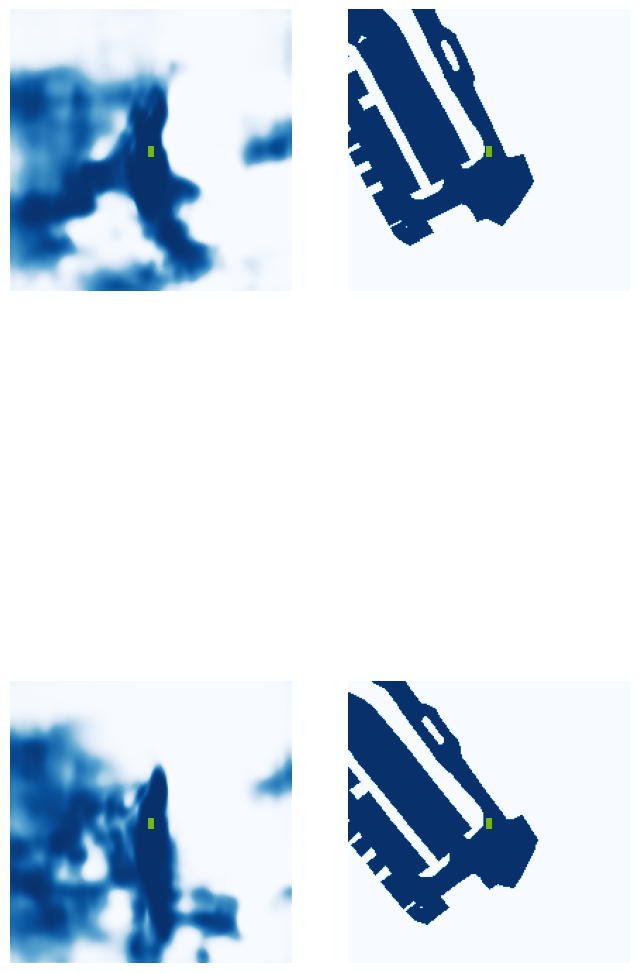

  5%|▌         | 2/40 [00:01<00:20,  1.86it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.43.jpg


 12%|█▎        | 5/40 [00:01<00:08,  4.14it/s]

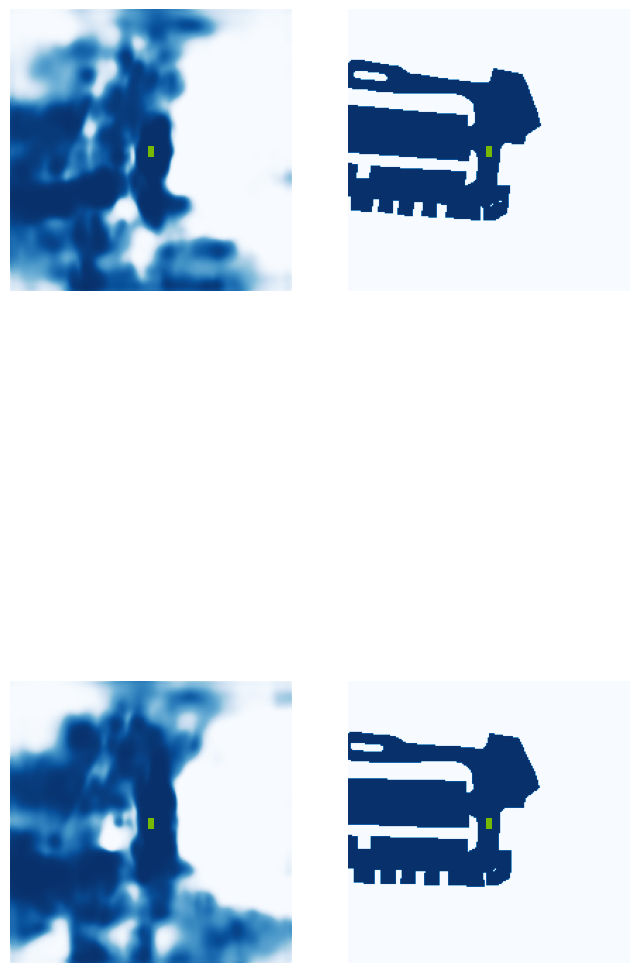

 18%|█▊        | 7/40 [00:02<00:07,  4.13it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.37.jpg


 25%|██▌       | 10/40 [00:02<00:05,  5.54it/s]

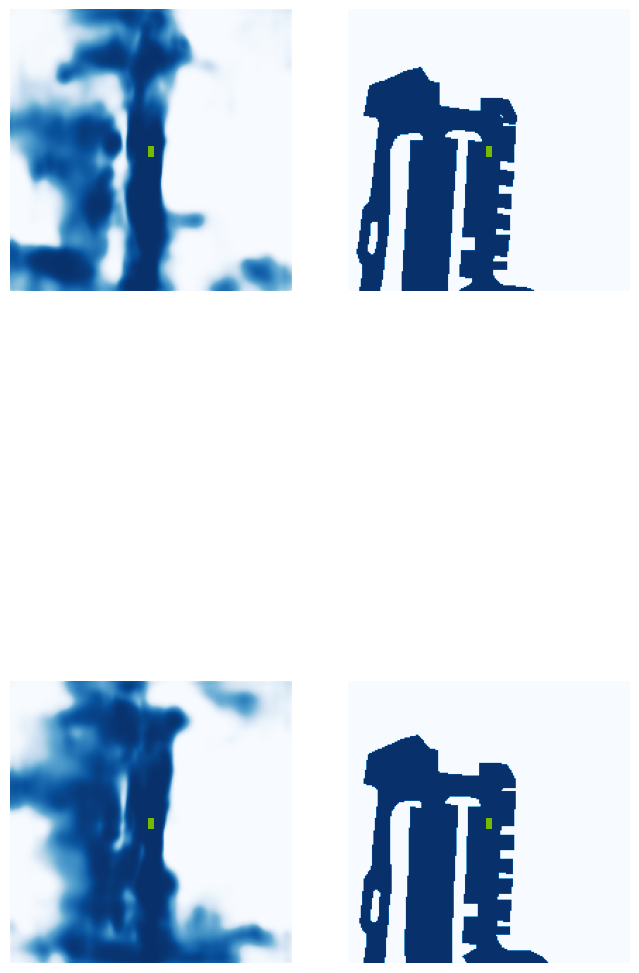

 30%|███       | 12/40 [00:03<00:07,  3.69it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.48.jpg


 38%|███▊      | 15/40 [00:04<00:06,  4.16it/s]

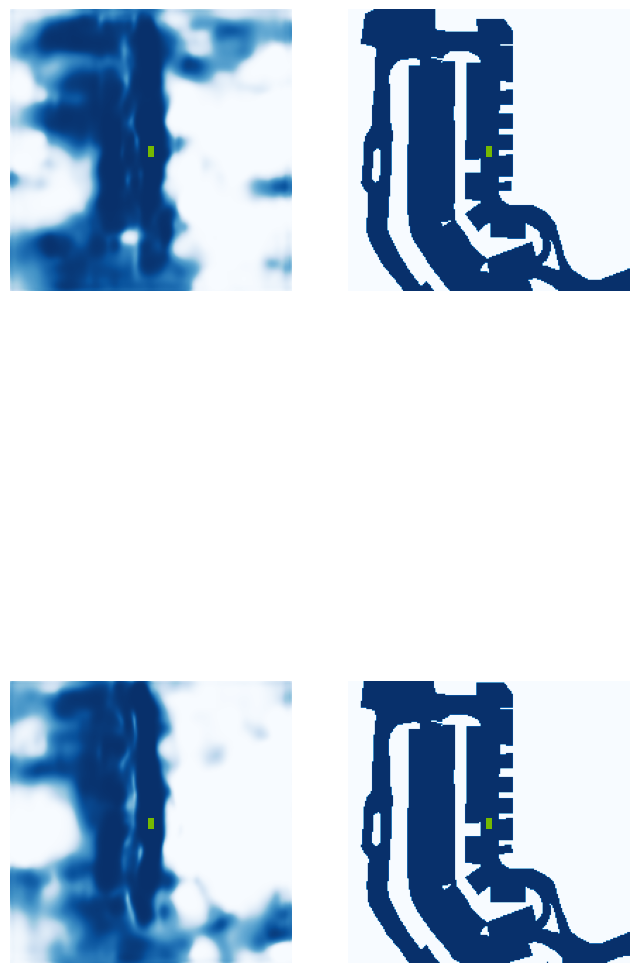

 42%|████▎     | 17/40 [00:04<00:05,  4.07it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.54.jpg


 50%|█████     | 20/40 [00:05<00:04,  4.85it/s]

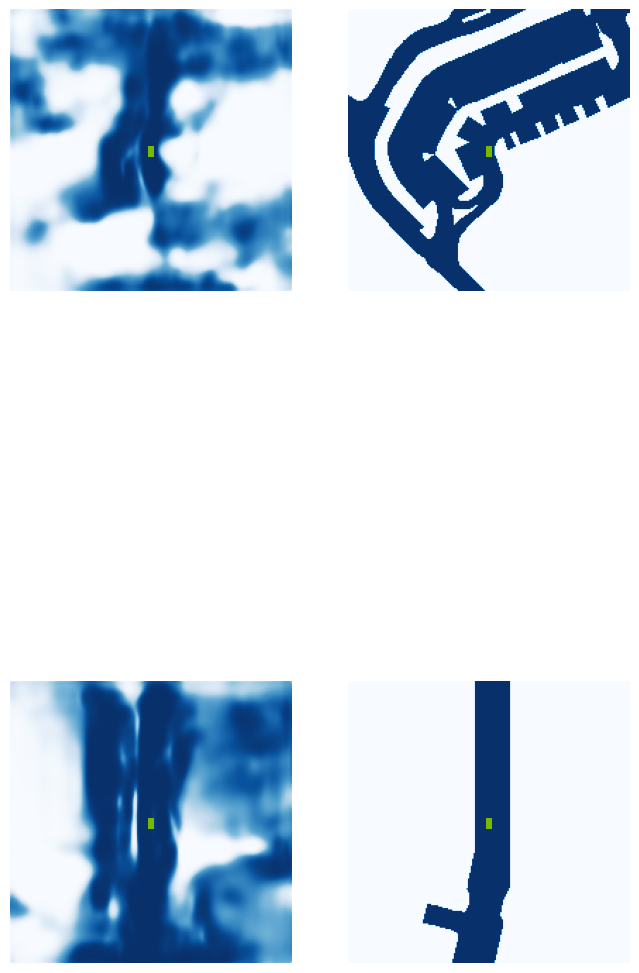

 57%|█████▊    | 23/40 [00:06<00:03,  4.45it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.27.jpg


 62%|██████▎   | 25/40 [00:06<00:03,  4.93it/s]

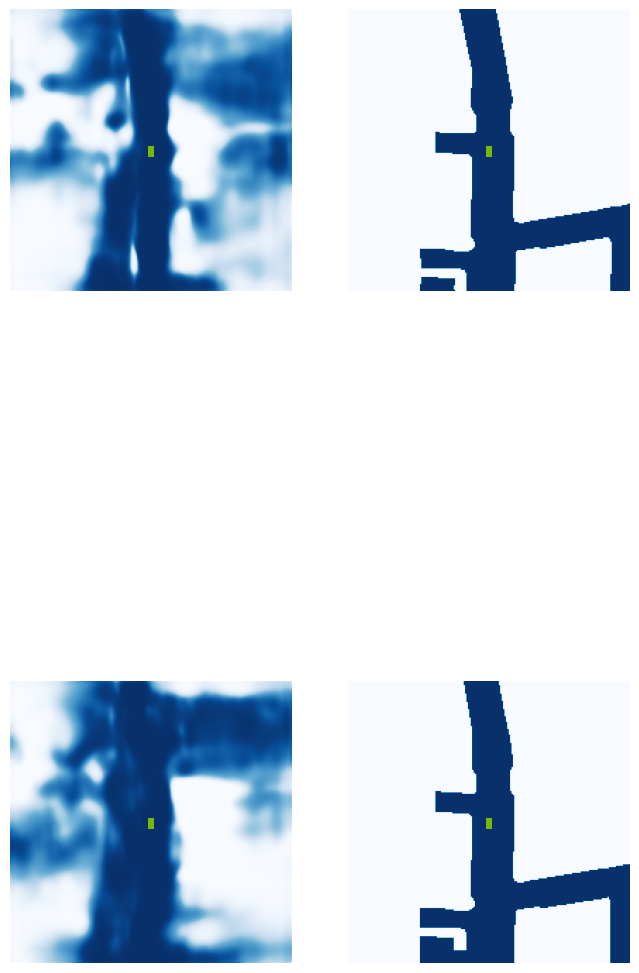

 68%|██████▊   | 27/40 [00:06<00:02,  4.58it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.28.jpg


 75%|███████▌  | 30/40 [00:07<00:01,  6.59it/s]

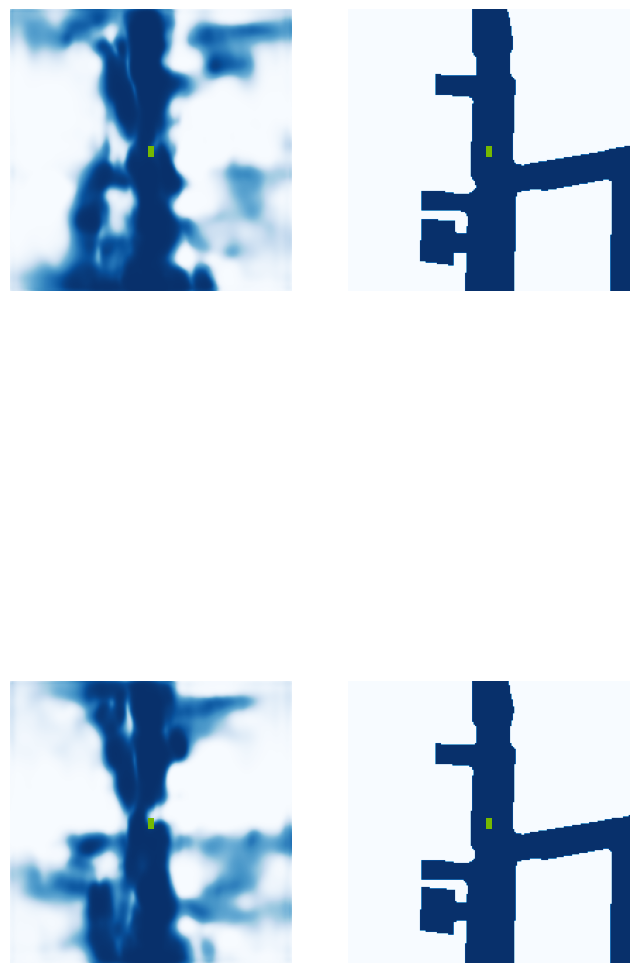

 80%|████████  | 32/40 [00:07<00:01,  4.27it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.41.jpg


 88%|████████▊ | 35/40 [00:08<00:00,  6.47it/s]

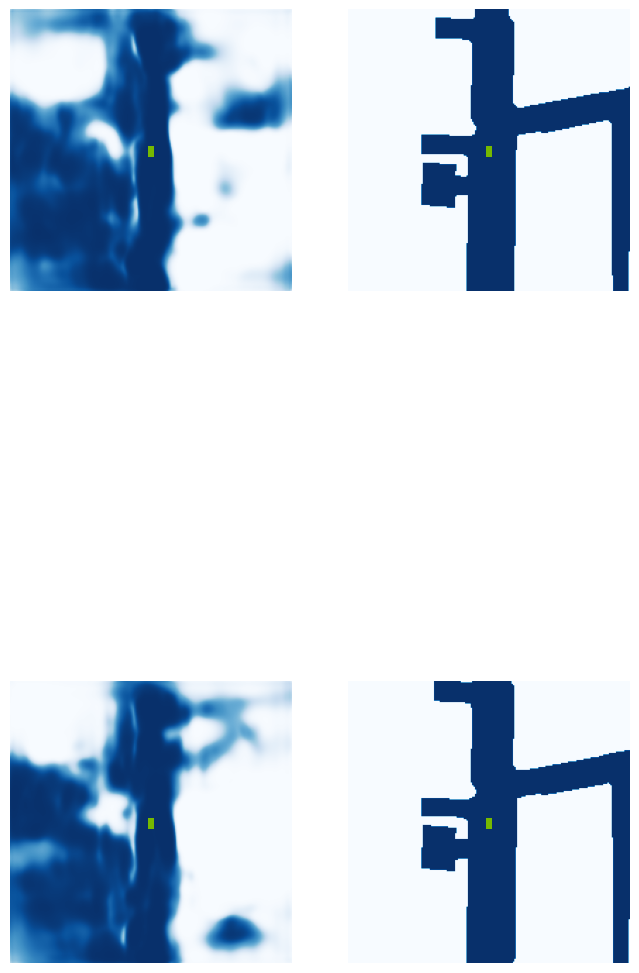

 92%|█████████▎| 37/40 [00:08<00:00,  5.01it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.33.jpg


100%|██████████| 40/40 [00:09<00:00,  4.37it/s]


VAL {'loss': 1.198012434406045, 'iou': 0.3941086034551975}
saving ...  ./runs/model5000.pt
5010 0.11531788110733032
5020 0.14309130609035492
5030 0.09971228986978531
5040 0.06698770076036453
5050 0.11563703417778015
5060 0.0853704959154129
5070 0.10790970176458359
5080 0.08522039651870728
5090 0.11888851970434189
5100 0.1183696836233139
5110 0.05661238729953766
5120 0.0884372889995575
5130 0.18369486927986145
5140 0.06424050778150558
5150 0.04984445124864578
Epoch: 33/60
5160 0.13073742389678955
5170 0.09968248754739761
5180 0.2630783021450043
5190 0.16277112066745758
5200 0.120904341340065
5210 0.06722083687782288
5220 0.1192251443862915
5230 0.10138023644685745
5240 0.10979097336530685
5250 0.1309061497449875
5260 0.10108118504285812
5270 0.07007201761007309
5280 0.17045722901821136
5290 0.13584394752979279
5300 0.13201534748077393
5310 0.11573891341686249
Epoch: 34/60
5320 0.1801486611366272
5330 0.06656993925571442
5340 0.07862979173660278
5350 0.15048789978027344
5360 0.0681877881

  0%|          | 0/40 [00:00<?, ?it/s]

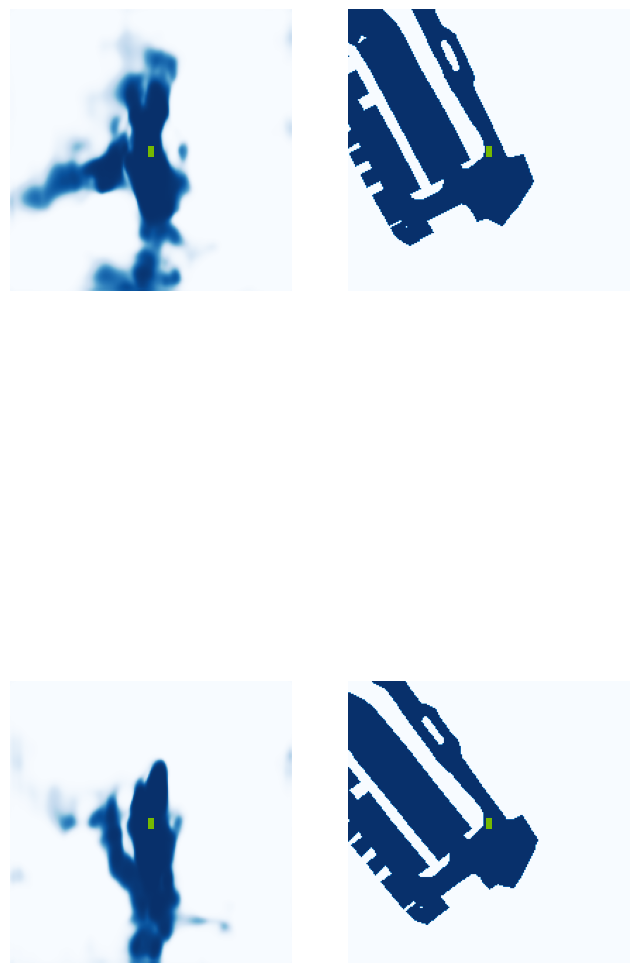

  5%|▌         | 2/40 [00:01<00:20,  1.86it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.22.jpg


 12%|█▎        | 5/40 [00:01<00:10,  3.39it/s]

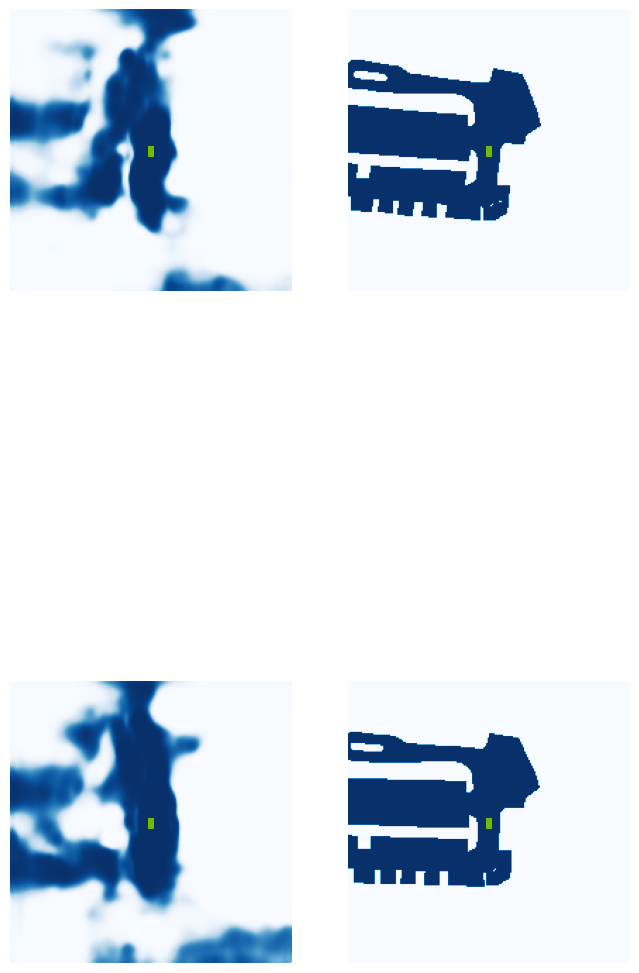

 18%|█▊        | 7/40 [00:02<00:08,  3.80it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.43.jpg


 25%|██▌       | 10/40 [00:02<00:05,  5.19it/s]

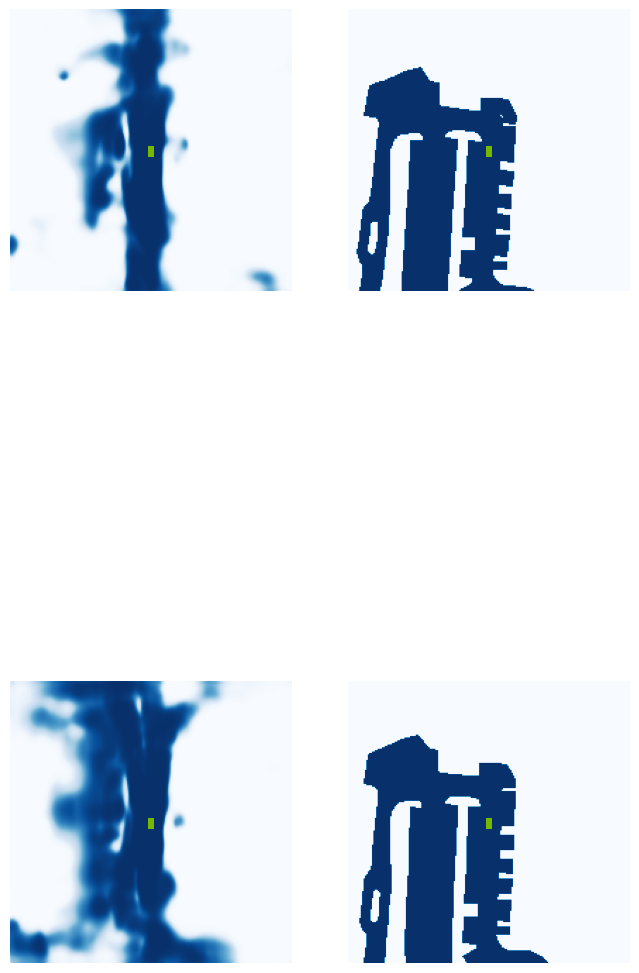

 30%|███       | 12/40 [00:03<00:07,  3.57it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.38.jpg


 38%|███▊      | 15/40 [00:04<00:05,  4.54it/s]

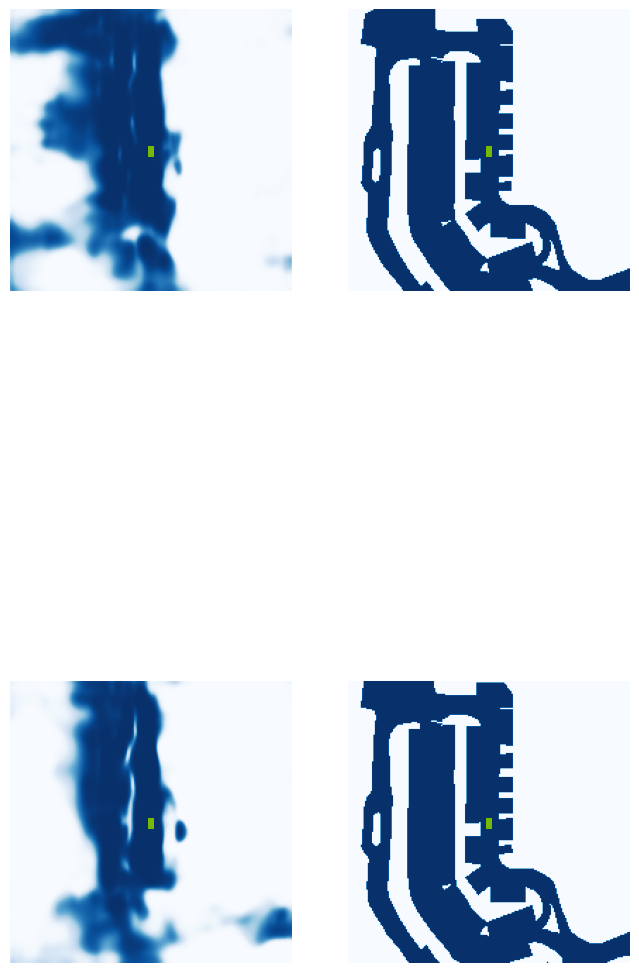

 42%|████▎     | 17/40 [00:04<00:05,  4.42it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.48.jpg


 50%|█████     | 20/40 [00:05<00:03,  5.38it/s]

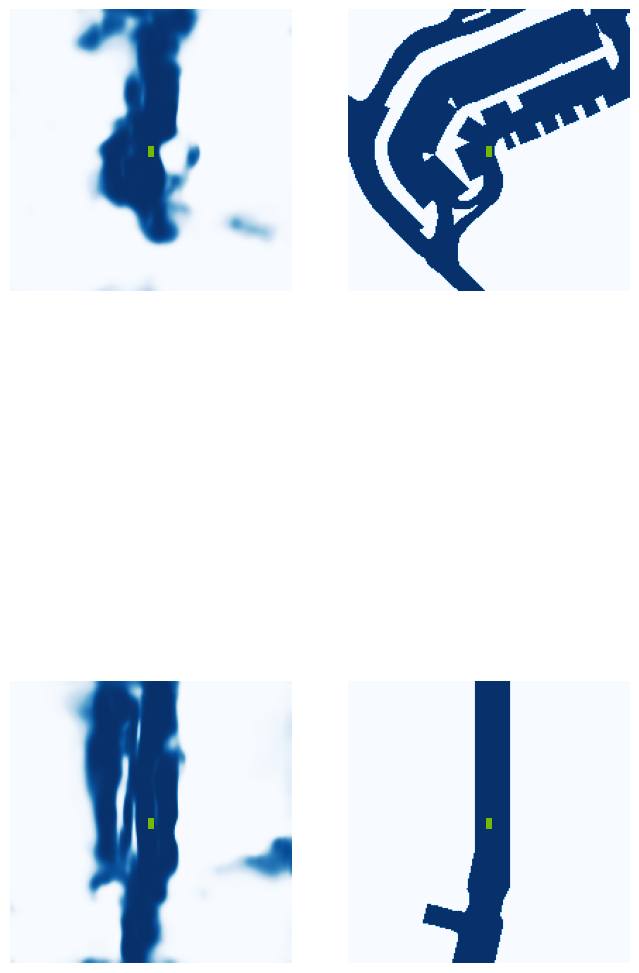

 52%|█████▎    | 21/40 [00:05<00:06,  3.00it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.30.jpg


 62%|██████▎   | 25/40 [00:06<00:02,  5.39it/s]

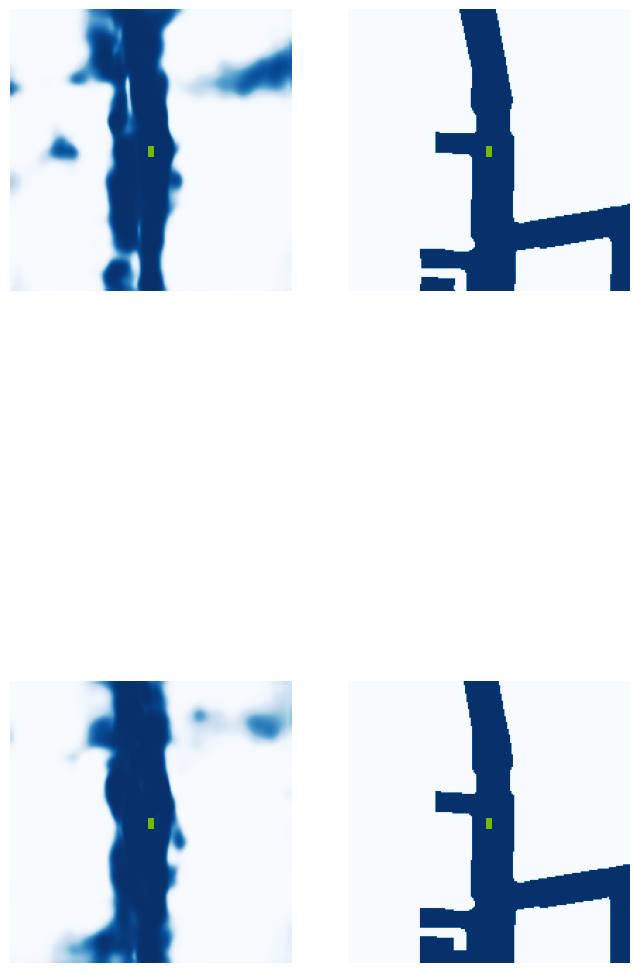

 68%|██████▊   | 27/40 [00:06<00:02,  4.92it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.43.jpg


 75%|███████▌  | 30/40 [00:07<00:01,  6.18it/s]

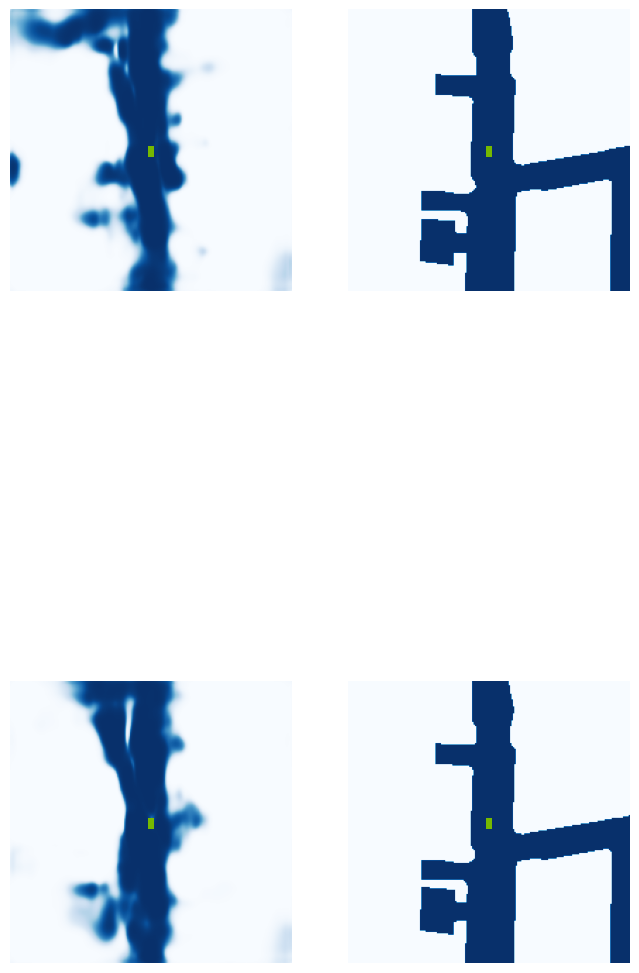

 80%|████████  | 32/40 [00:08<00:01,  4.08it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.44.jpg


 88%|████████▊ | 35/40 [00:08<00:00,  5.82it/s]

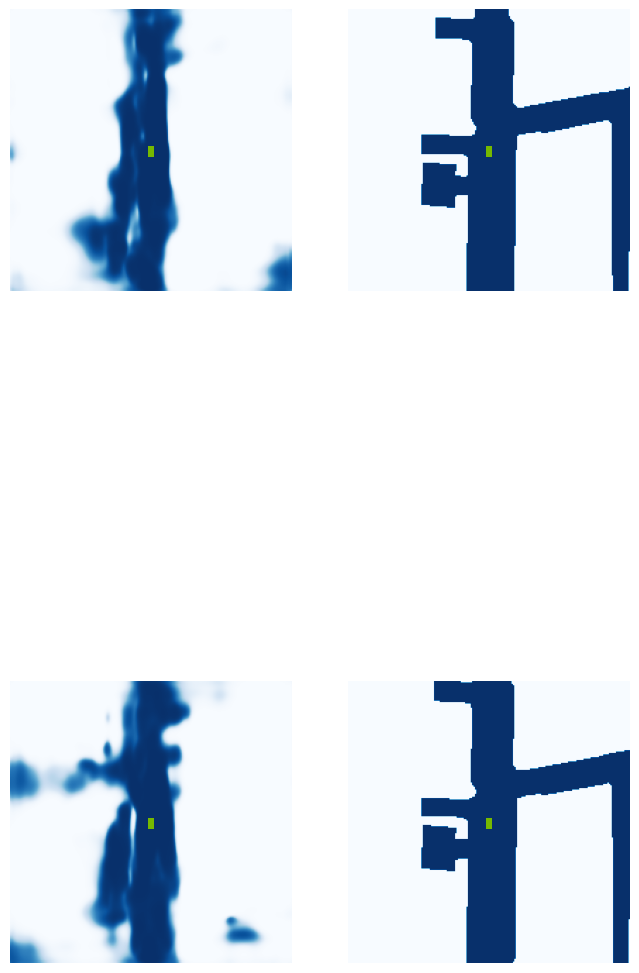

 95%|█████████▌| 38/40 [00:09<00:00,  5.80it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.44.jpg


100%|██████████| 40/40 [00:09<00:00,  4.30it/s]


VAL {'loss': 2.0300759077072144, 'iou': 0.4059560457676931}
saving ...  ./runs/model5500.pt
5510 0.12478364259004593
5520 0.1365586668252945
5530 0.18442364037036896
5540 0.07196983695030212
5550 0.19370543956756592
5560 0.06111276522278786
5570 0.06187238544225693
5580 0.16566340625286102
5590 0.13789479434490204
5600 0.049102116376161575
5610 0.21791961789131165
5620 0.23602694272994995
5630 0.12304223328828812
Epoch: 36/60
5640 0.2036668360233307
5650 0.14818330109119415
5660 0.1293158382177353
5670 0.04911007359623909
5680 0.09047375619411469
5690 0.10498408228158951
5700 0.1422450840473175
5710 0.09422899037599564
5720 0.04651886597275734
5730 0.11287284642457962
5740 0.08253628015518188
5750 0.08789251744747162
5760 0.20694716274738312
5770 0.14167752861976624
5780 0.18152569234371185
5790 0.1593119353055954
Epoch: 37/60
5800 0.16022416949272156
5810 0.07344090938568115
5820 0.24530377984046936
5830 0.13811874389648438
5840 0.06572375446557999
5850 0.0411982424557209
5860 0.09415

  0%|          | 0/40 [00:00<?, ?it/s]

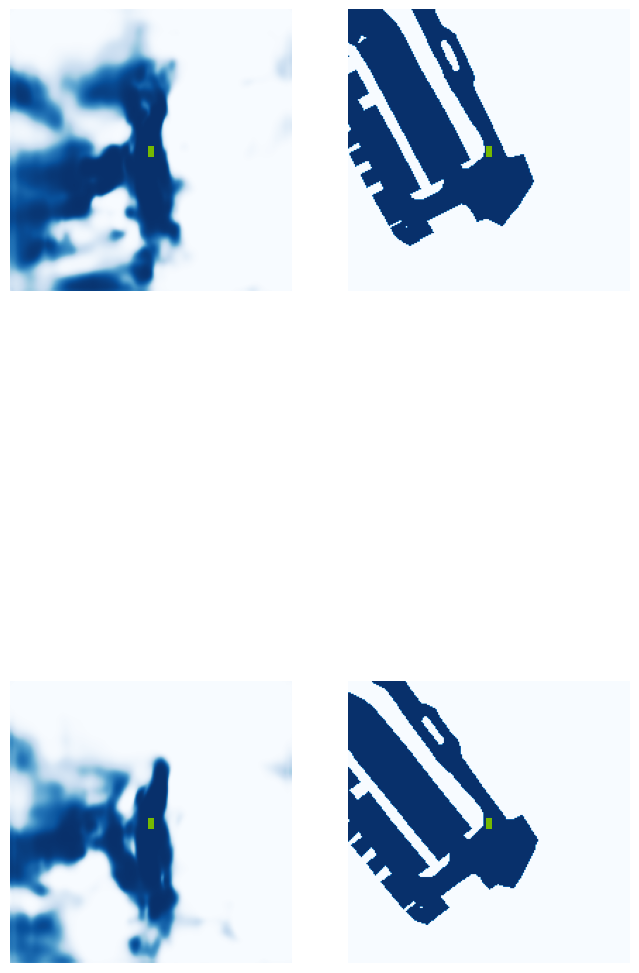

  5%|▌         | 2/40 [00:01<00:20,  1.89it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.33.jpg


 12%|█▎        | 5/40 [00:01<00:09,  3.75it/s]

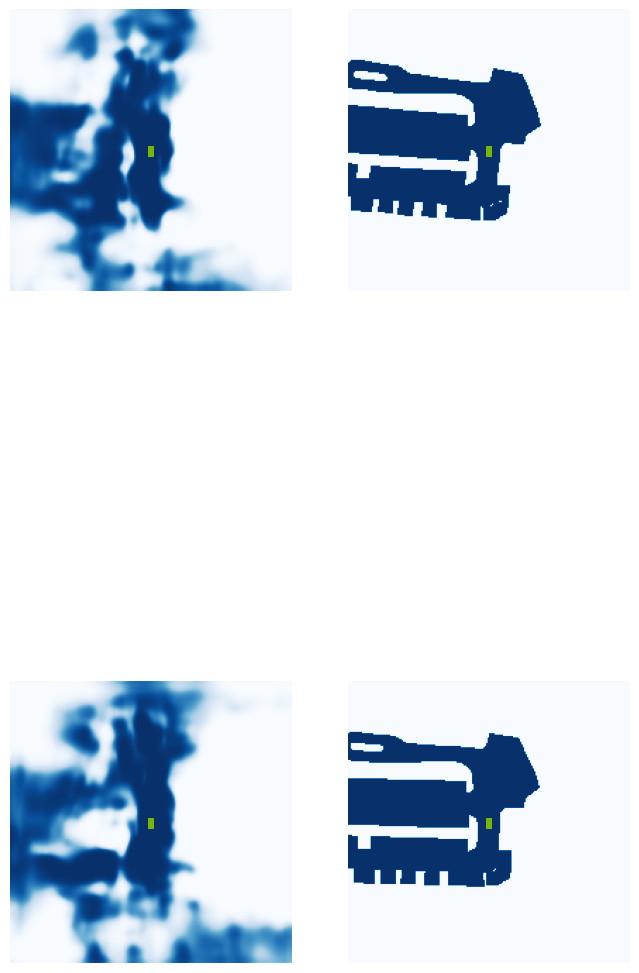

 18%|█▊        | 7/40 [00:02<00:08,  3.98it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.42.jpg


 22%|██▎       | 9/40 [00:02<00:07,  4.33it/s]

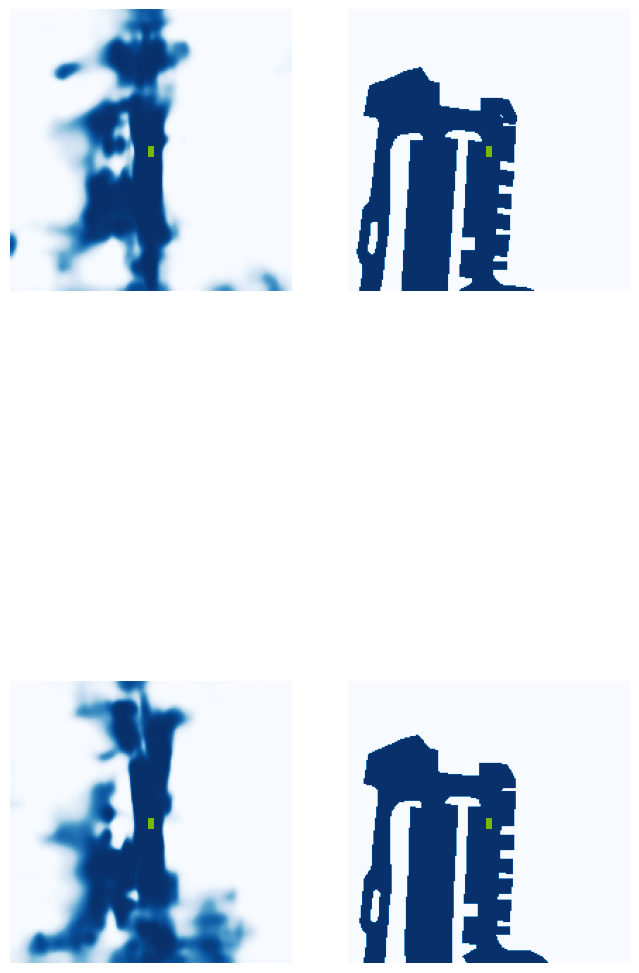

 30%|███       | 12/40 [00:03<00:06,  4.06it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.39.jpg


 38%|███▊      | 15/40 [00:04<00:05,  4.59it/s]

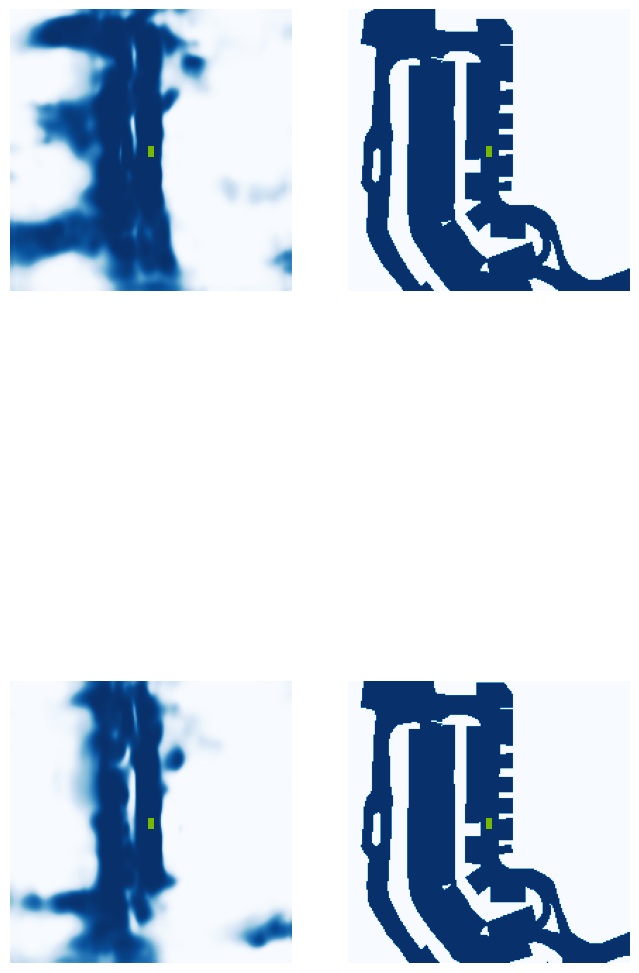

 42%|████▎     | 17/40 [00:04<00:05,  4.51it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.46.jpg


 50%|█████     | 20/40 [00:05<00:03,  5.15it/s]

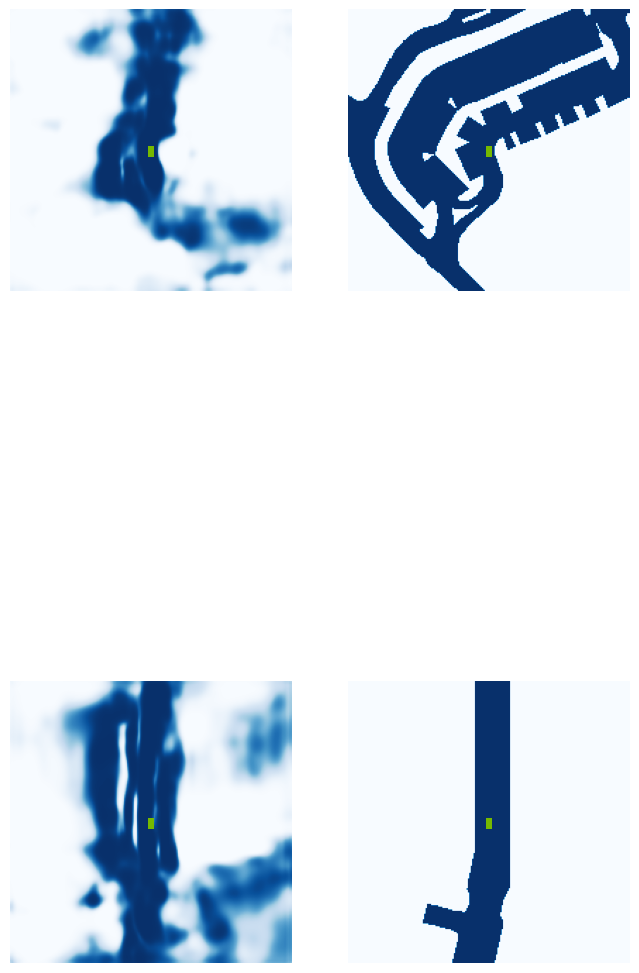

 52%|█████▎    | 21/40 [00:05<00:05,  3.36it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.26.jpg


 62%|██████▎   | 25/40 [00:06<00:02,  5.13it/s]

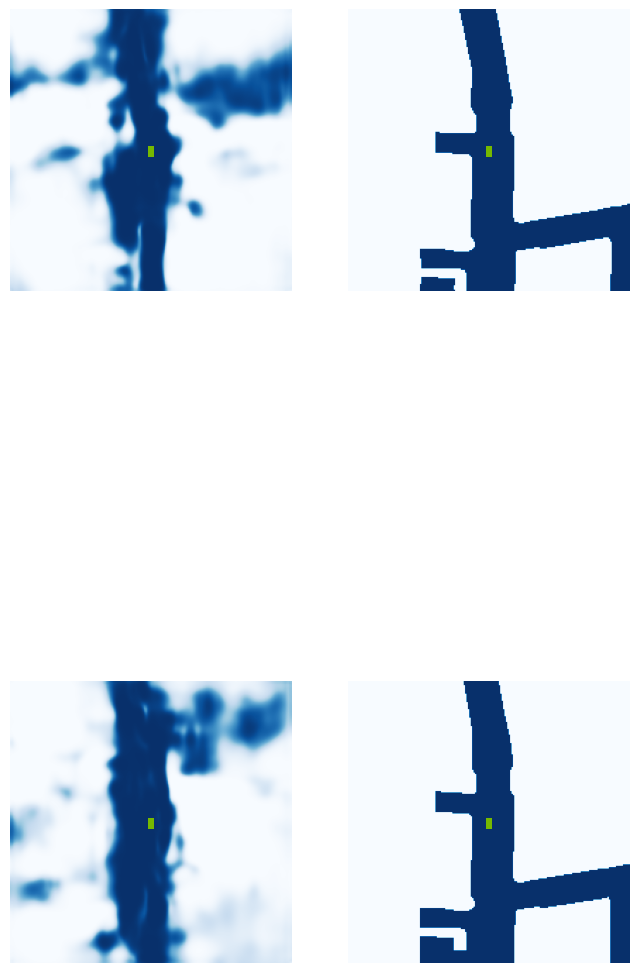

 68%|██████▊   | 27/40 [00:06<00:02,  4.89it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.35.jpg


 72%|███████▎  | 29/40 [00:07<00:01,  5.68it/s]

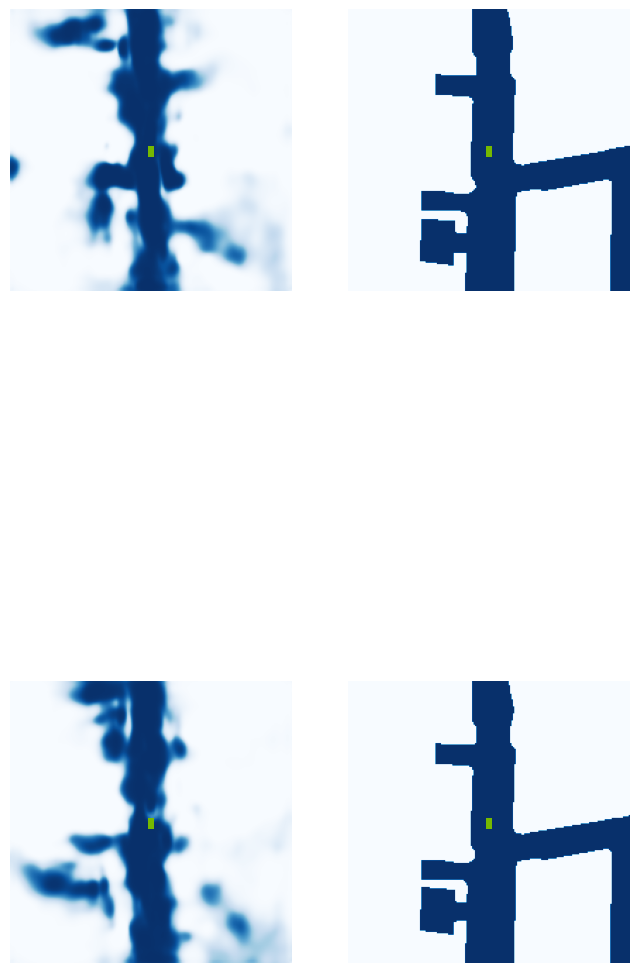

 82%|████████▎ | 33/40 [00:07<00:01,  5.36it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.42.jpg


 88%|████████▊ | 35/40 [00:08<00:00,  5.69it/s]

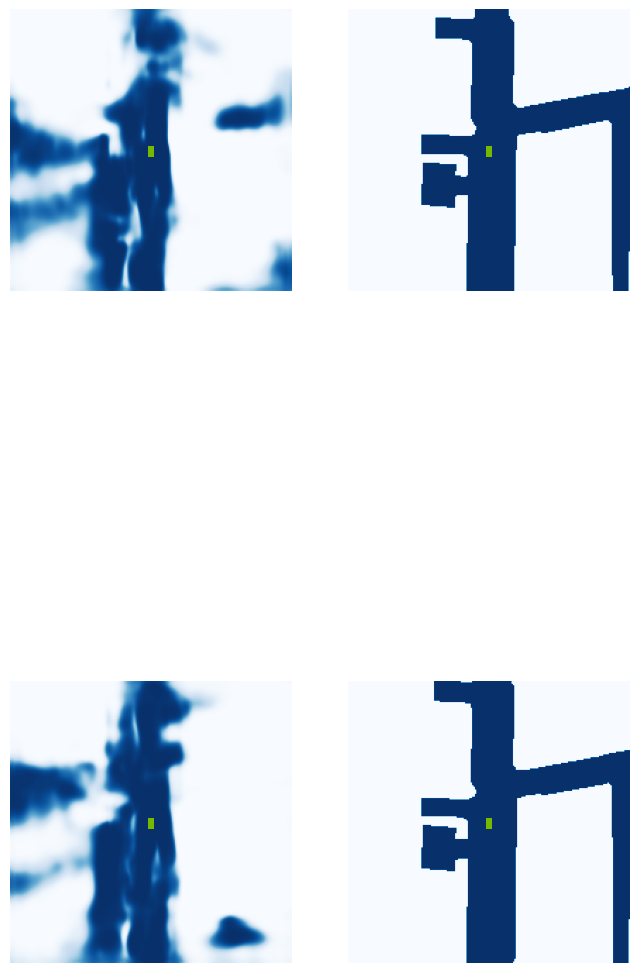

 92%|█████████▎| 37/40 [00:08<00:00,  4.87it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.41.jpg


100%|██████████| 40/40 [00:09<00:00,  4.38it/s]


VAL {'loss': 1.6374846682136441, 'iou': 0.40462511155412095}
saving ...  ./runs/model6000.pt
6010 0.16071611642837524
6020 0.14421547949314117
6030 0.15489725768566132
6040 0.10980435460805893
6050 0.06336763501167297
6060 0.04073236137628555
6070 0.15554799139499664
6080 0.07339325547218323
6090 0.11609333008527756
6100 0.05070602148771286
6110 0.042182885110378265
Epoch: 39/60
6120 0.06317044049501419
6130 0.0904875248670578
6140 0.07620631158351898
6150 0.14977432787418365
6160 0.14691706001758575
6170 0.15594036877155304
6180 0.13239681720733643
6190 0.10626208037137985
6200 0.07107051461935043
6210 0.13356684148311615
6220 0.048900529742240906
6230 0.2066618800163269
6240 0.08438632637262344
6250 0.16707463562488556
6260 0.08357398211956024
6270 0.066627636551857
Epoch: 40/60
6280 0.10062609612941742
6290 0.05052242428064346
6300 0.13249601423740387
6310 0.04019980877637863
6320 0.13076519966125488
6330 0.18551883101463318
6340 0.1306518167257309
6350 0.06292072683572769
6360 0.07

  0%|          | 0/40 [00:00<?, ?it/s]

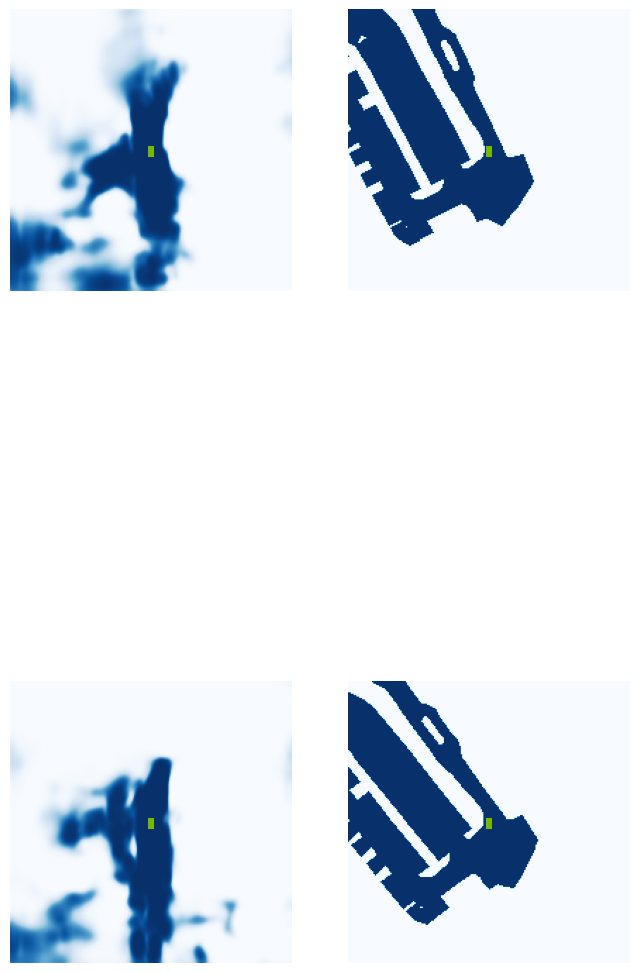

  5%|▌         | 2/40 [00:01<00:20,  1.86it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.20.jpg


 12%|█▎        | 5/40 [00:01<00:08,  4.37it/s]

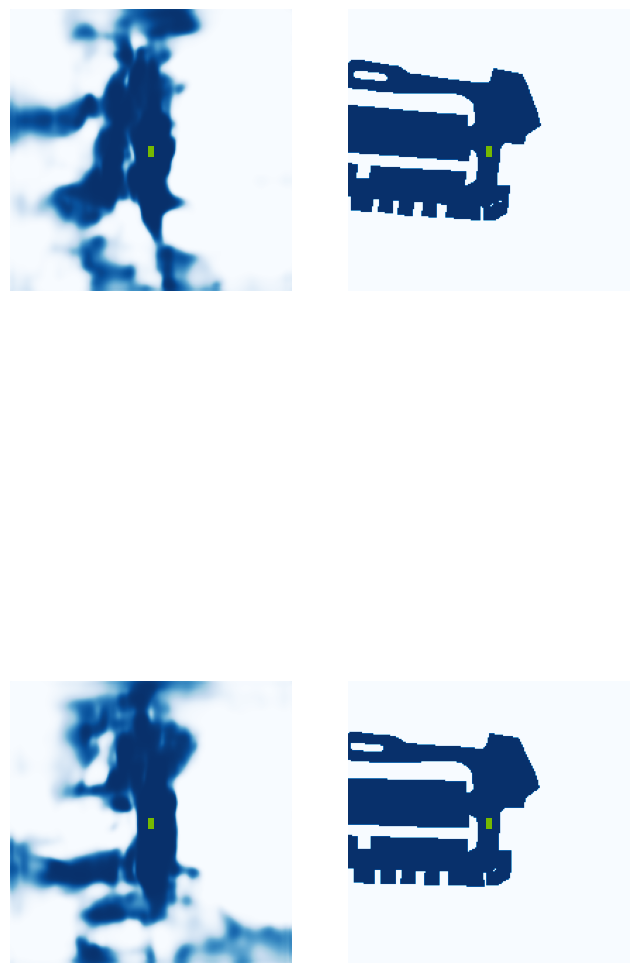

 18%|█▊        | 7/40 [00:02<00:10,  3.05it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.34.jpg


 25%|██▌       | 10/40 [00:02<00:05,  5.48it/s]

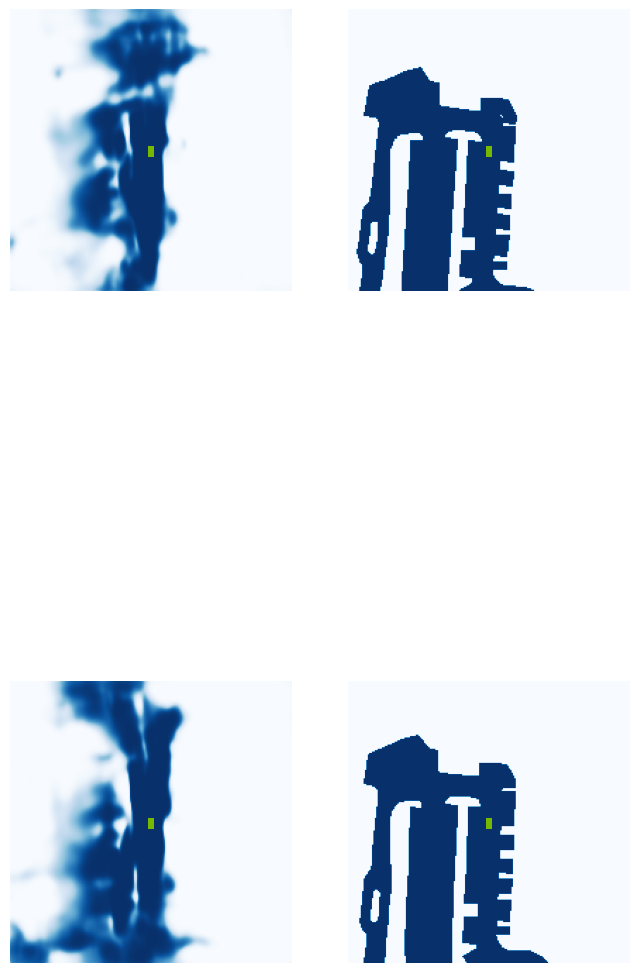

 28%|██▊       | 11/40 [00:03<00:07,  3.89it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.39.jpg


 38%|███▊      | 15/40 [00:04<00:05,  4.94it/s]

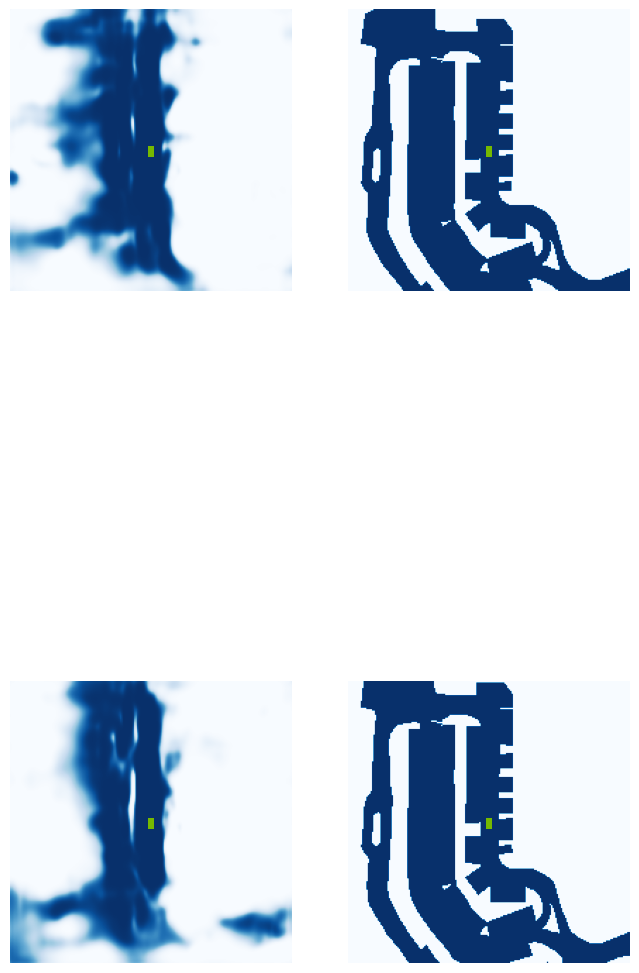

 42%|████▎     | 17/40 [00:04<00:04,  4.63it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.45.jpg


 48%|████▊     | 19/40 [00:04<00:04,  4.59it/s]

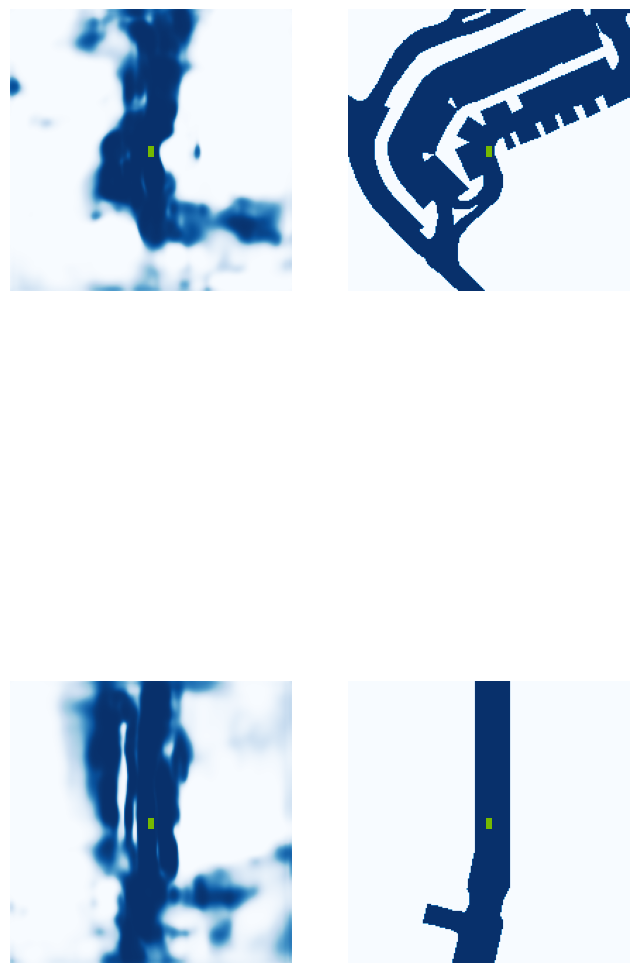

 57%|█████▊    | 23/40 [00:05<00:03,  4.79it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.29.jpg


 62%|██████▎   | 25/40 [00:06<00:02,  5.66it/s]

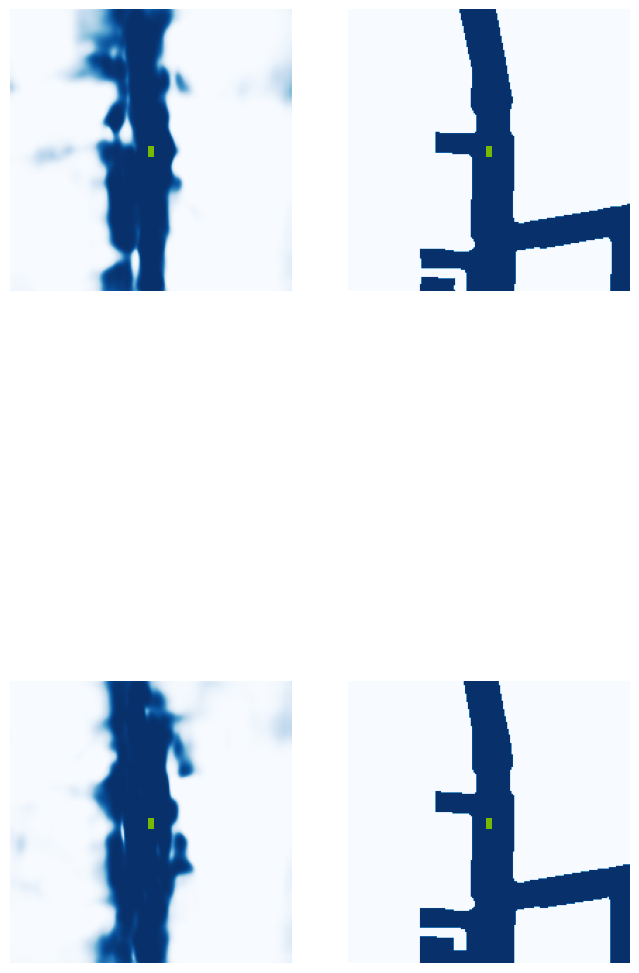

 68%|██████▊   | 27/40 [00:06<00:02,  4.86it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.45.jpg


 72%|███████▎  | 29/40 [00:06<00:02,  5.45it/s]

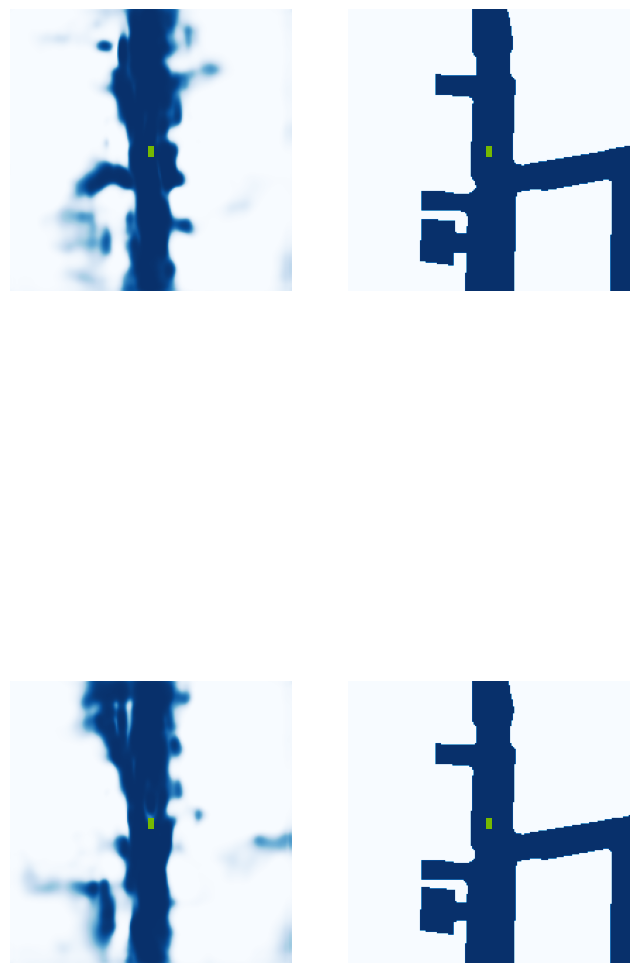

 80%|████████  | 32/40 [00:07<00:01,  4.63it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.49.jpg


 88%|████████▊ | 35/40 [00:08<00:00,  6.33it/s]

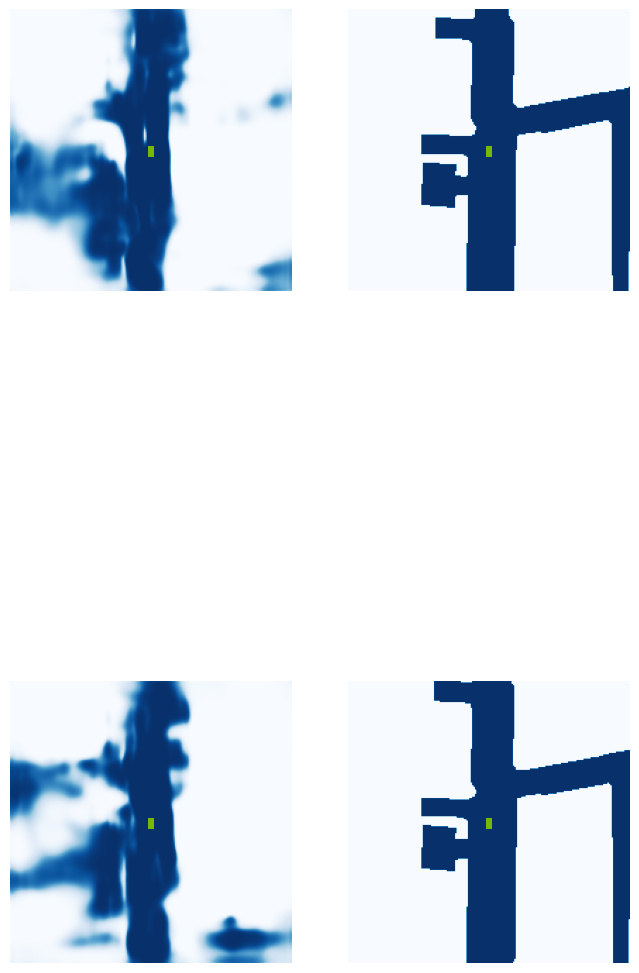

 92%|█████████▎| 37/40 [00:08<00:00,  4.86it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.40.jpg


100%|██████████| 40/40 [00:08<00:00,  4.45it/s]


VAL {'loss': 1.905226226206179, 'iou': 0.40377208118351987}
saving ...  ./runs/model6500.pt
6510 0.14452673494815826
6520 0.08191750198602676
6530 0.1020660325884819
6540 0.10549406707286835
6550 0.09069202840328217
6560 0.038558024913072586
6570 0.10820768773555756
6580 0.06942365318536758
6590 0.059104833751916885
6600 0.10884779691696167
Epoch: 42/60
6610 0.1202162429690361
6620 0.09960293024778366
6630 0.06772641092538834
6640 0.04781613498926163
6650 0.03356219455599785
6660 0.08173812925815582
6670 0.05114702135324478
6680 0.14655780792236328
6690 0.12834183871746063
6700 0.06470014154911041
6710 0.03850889950990677
6720 0.05645707994699478
6730 0.19981928169727325
6740 0.12594373524188995
6750 0.13144010305404663
6760 0.08416686952114105
Epoch: 43/60
6770 0.17673668265342712
6780 0.06291729211807251
6790 0.12032752484083176
6800 0.10144390910863876
6810 0.08066792786121368
6820 0.2299647331237793
6830 0.04648098722100258
6840 0.03777359426021576
6850 0.03002324141561985
6860 0.0

  0%|          | 0/40 [00:00<?, ?it/s]

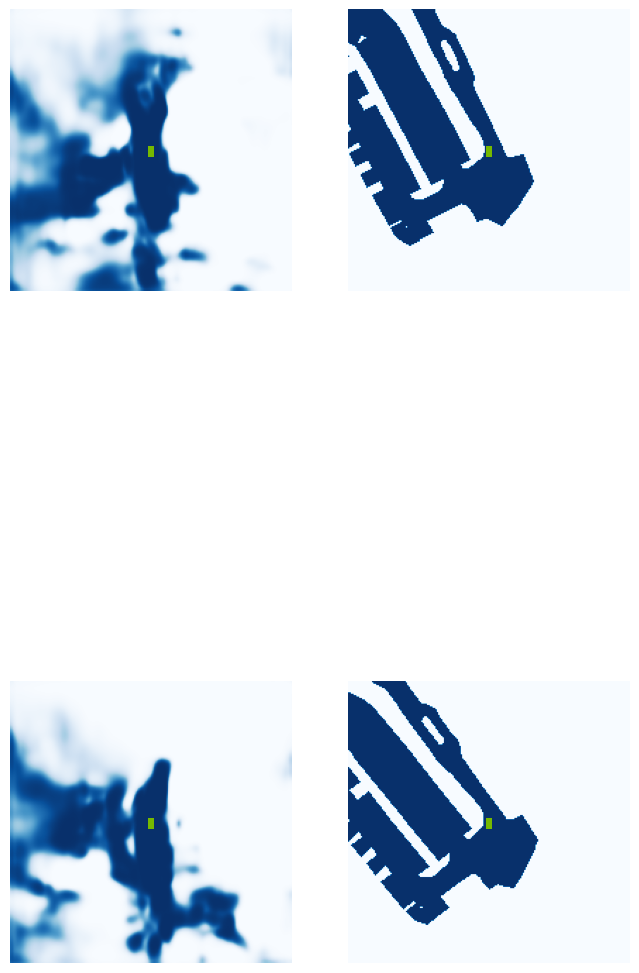

  5%|▌         | 2/40 [00:01<00:22,  1.72it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.33.jpg


 12%|█▎        | 5/40 [00:01<00:08,  4.14it/s]

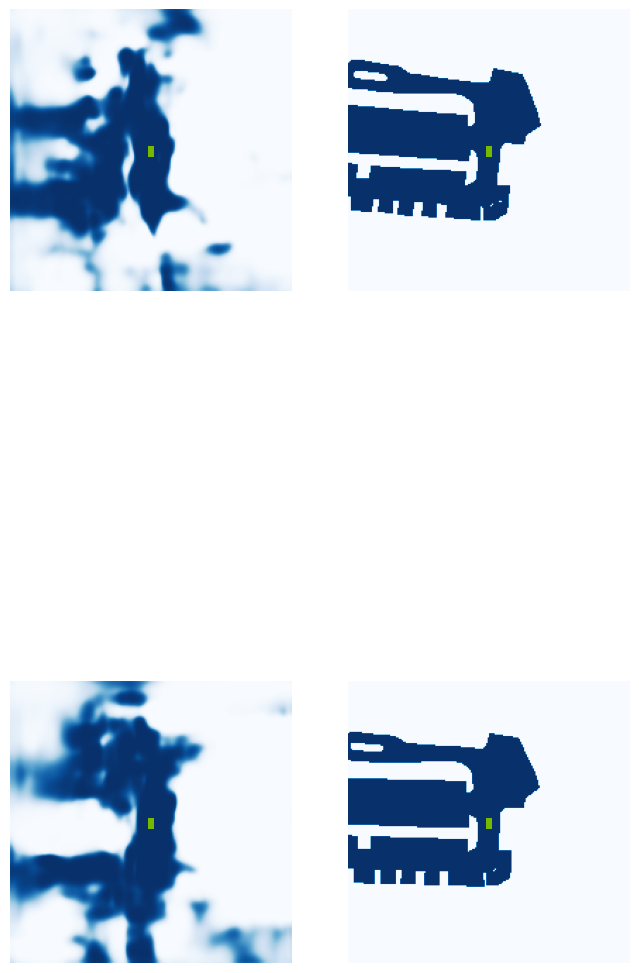

 18%|█▊        | 7/40 [00:02<00:08,  4.07it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.42.jpg


 25%|██▌       | 10/40 [00:02<00:05,  5.06it/s]

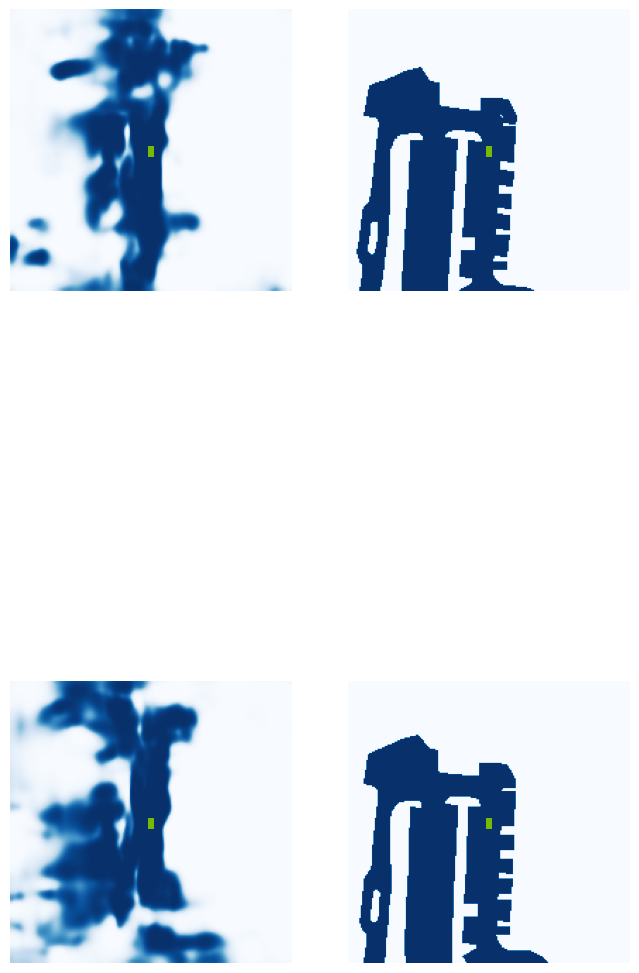

 30%|███       | 12/40 [00:03<00:07,  3.84it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.36.jpg


 38%|███▊      | 15/40 [00:04<00:05,  4.37it/s]

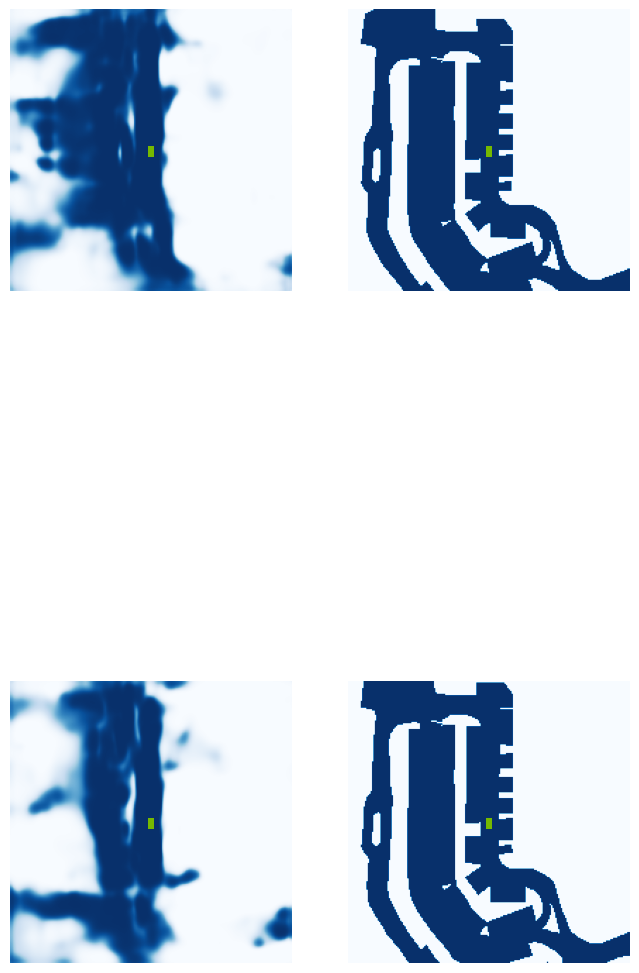

 42%|████▎     | 17/40 [00:04<00:05,  4.07it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.50.jpg


 50%|█████     | 20/40 [00:05<00:03,  5.19it/s]

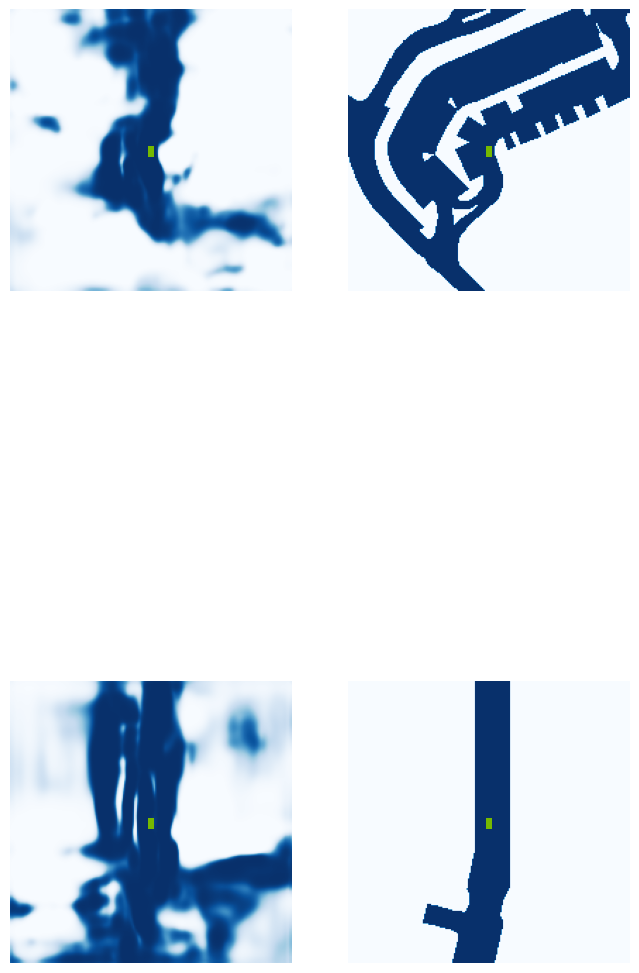

 55%|█████▌    | 22/40 [00:05<00:04,  3.92it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.27.jpg


 62%|██████▎   | 25/40 [00:06<00:02,  5.91it/s]

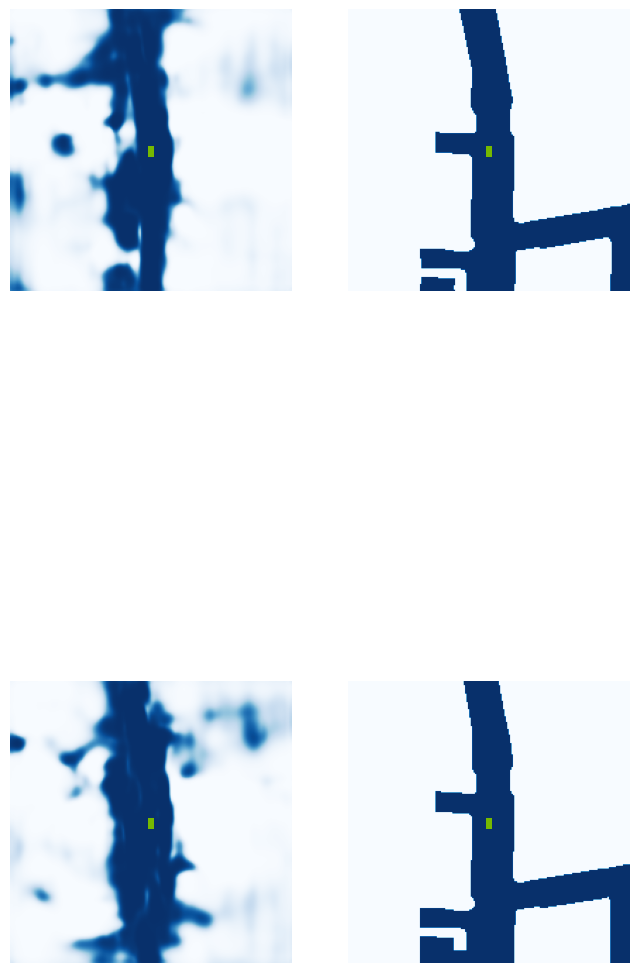

 68%|██████▊   | 27/40 [00:06<00:02,  4.82it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.41.jpg


 75%|███████▌  | 30/40 [00:07<00:01,  6.40it/s]

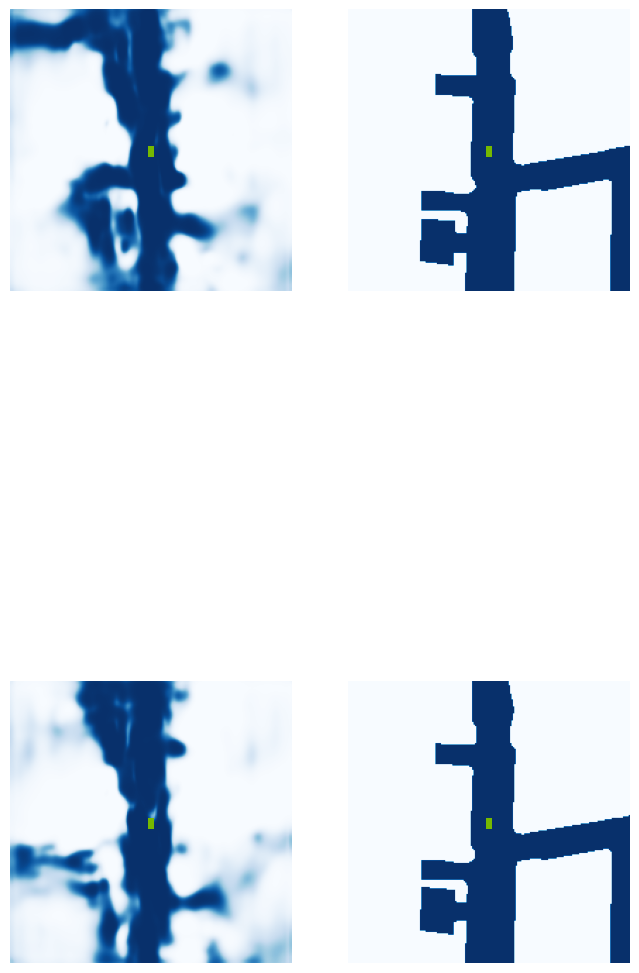

 78%|███████▊  | 31/40 [00:07<00:02,  3.62it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.43.jpg


 88%|████████▊ | 35/40 [00:08<00:00,  6.19it/s]

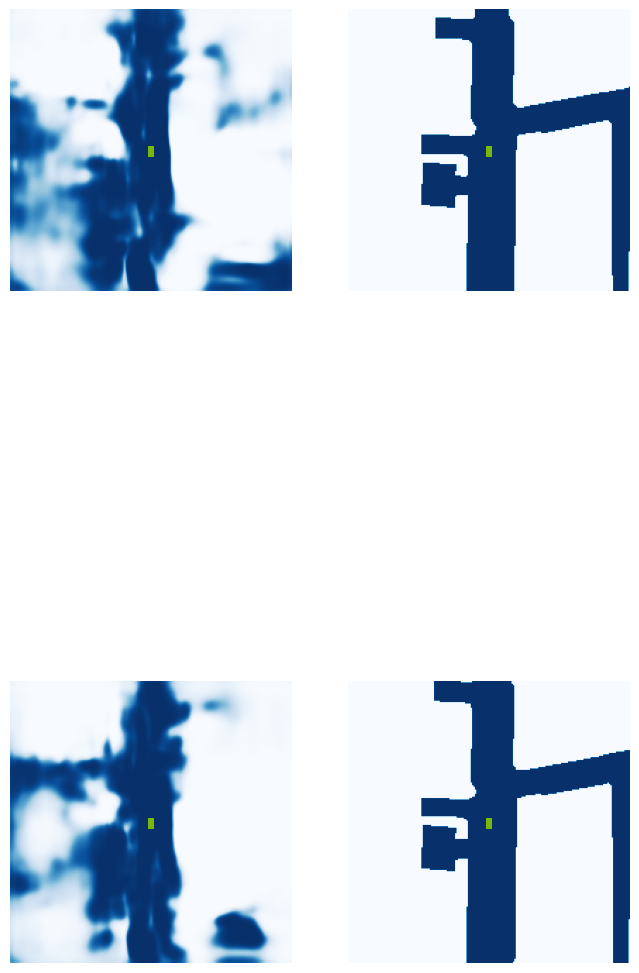

 92%|█████████▎| 37/40 [00:08<00:00,  5.04it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.39.jpg


100%|██████████| 40/40 [00:09<00:00,  4.36it/s]


VAL {'loss': 1.7054308270230705, 'iou': 0.404037942451709}
saving ...  ./runs/model7000.pt
7010 0.026061955839395523
7020 0.07983750104904175
7030 0.03372950851917267
7040 0.10604371130466461
7050 0.13446731865406036
7060 0.12064874917268753
7070 0.11148709803819656
7080 0.0724482610821724
Epoch: 45/60
7090 0.06670967489480972
7100 0.10734318941831589
7110 0.11326435208320618
7120 0.08433633297681808
7130 0.04764891043305397
7140 0.07493546605110168
7150 0.04580221325159073
7160 0.07572788000106812
7170 0.06395725905895233
7180 0.03380504995584488
7190 0.03678305447101593
7200 0.08023224025964737
7210 0.07178518176078796
7220 0.031287893652915955
7230 0.04368861764669418
7240 0.11605639010667801
Epoch: 46/60
7250 0.10895055532455444
7260 0.07426813244819641
7270 0.08575351536273956
7280 0.2750357389450073
7290 0.04619188979268074
7300 0.1298011988401413
7310 0.17101457715034485
7320 0.10921059548854828
7330 0.07820058614015579
7340 0.1182132437825203
7350 0.13126447796821594
7360 0.053

  0%|          | 0/40 [00:00<?, ?it/s]

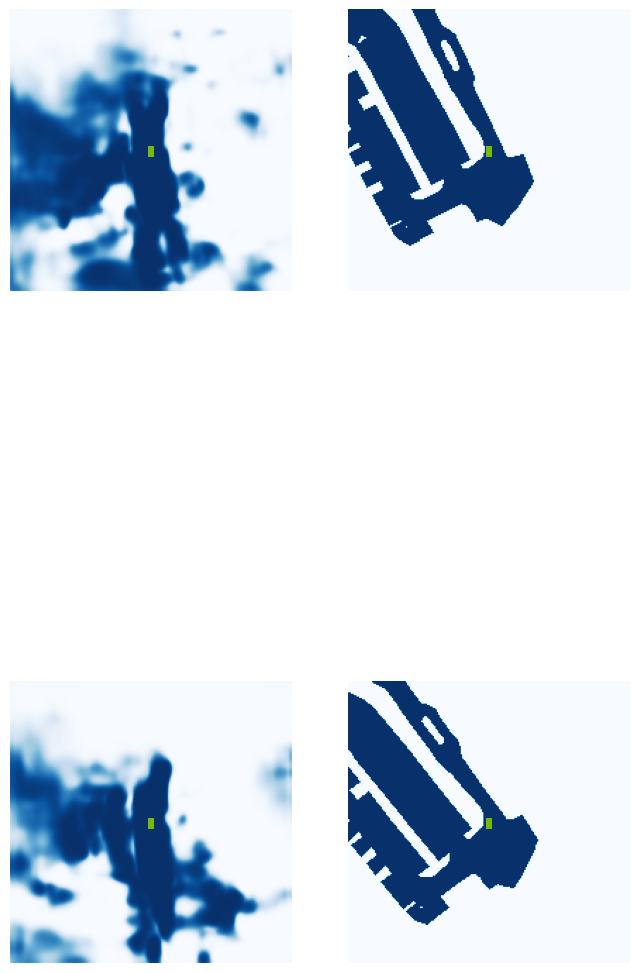

  5%|▌         | 2/40 [00:01<00:21,  1.78it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.36.jpg


 12%|█▎        | 5/40 [00:01<00:09,  3.78it/s]

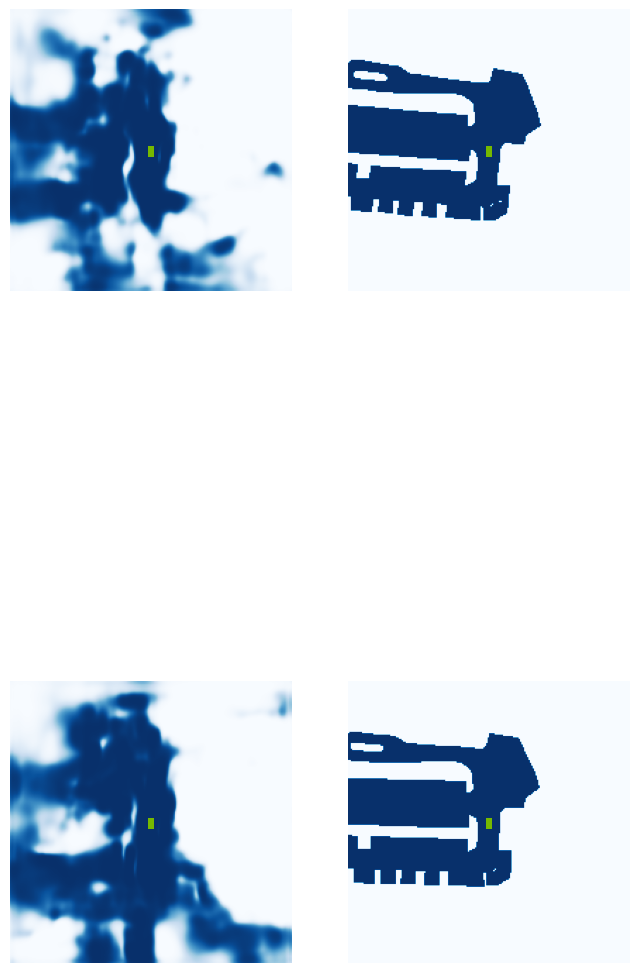

 18%|█▊        | 7/40 [00:02<00:08,  4.05it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.39.jpg


 25%|██▌       | 10/40 [00:02<00:06,  4.83it/s]

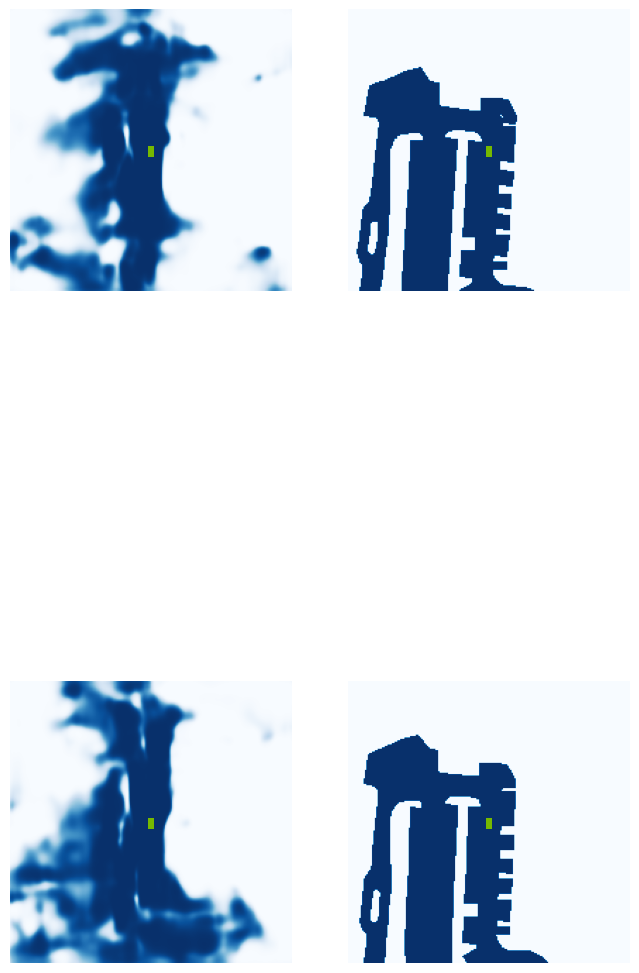

 30%|███       | 12/40 [00:03<00:07,  3.80it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.41.jpg


 38%|███▊      | 15/40 [00:04<00:05,  4.34it/s]

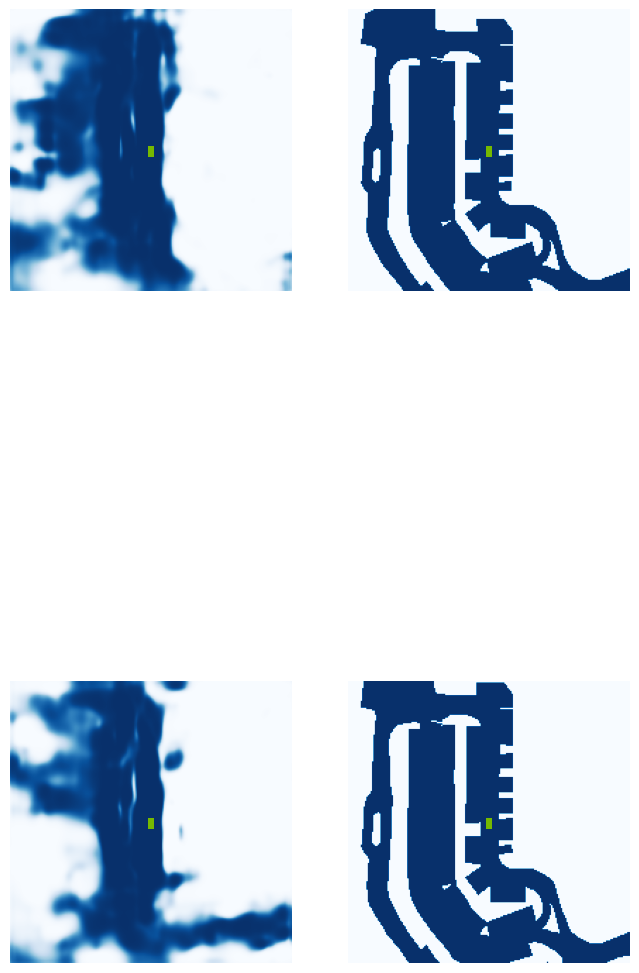

 42%|████▎     | 17/40 [00:04<00:05,  4.29it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.53.jpg


 50%|█████     | 20/40 [00:05<00:03,  5.09it/s]

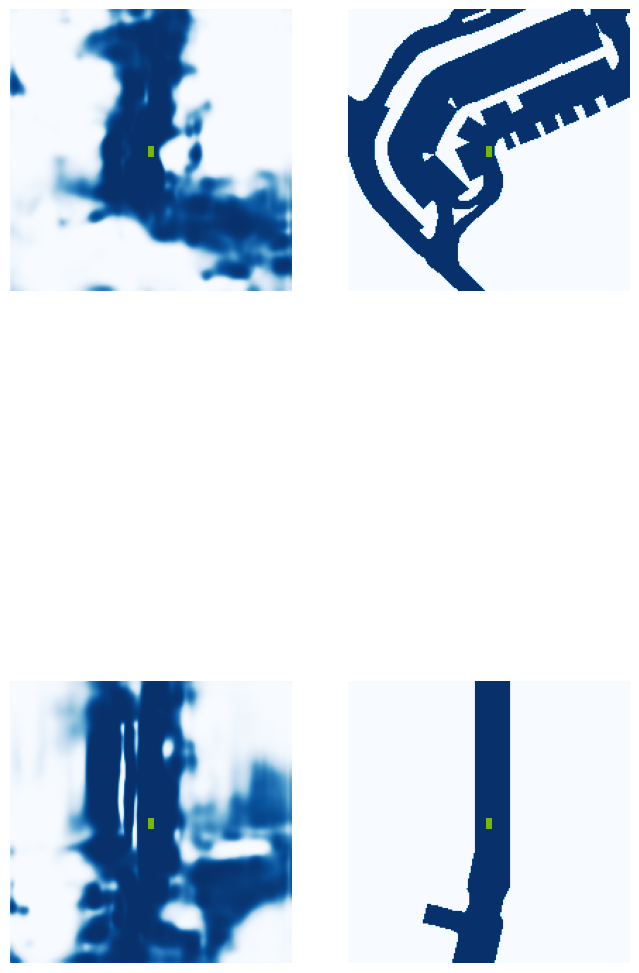

 55%|█████▌    | 22/40 [00:05<00:04,  3.85it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.24.jpg


 62%|██████▎   | 25/40 [00:06<00:02,  5.78it/s]

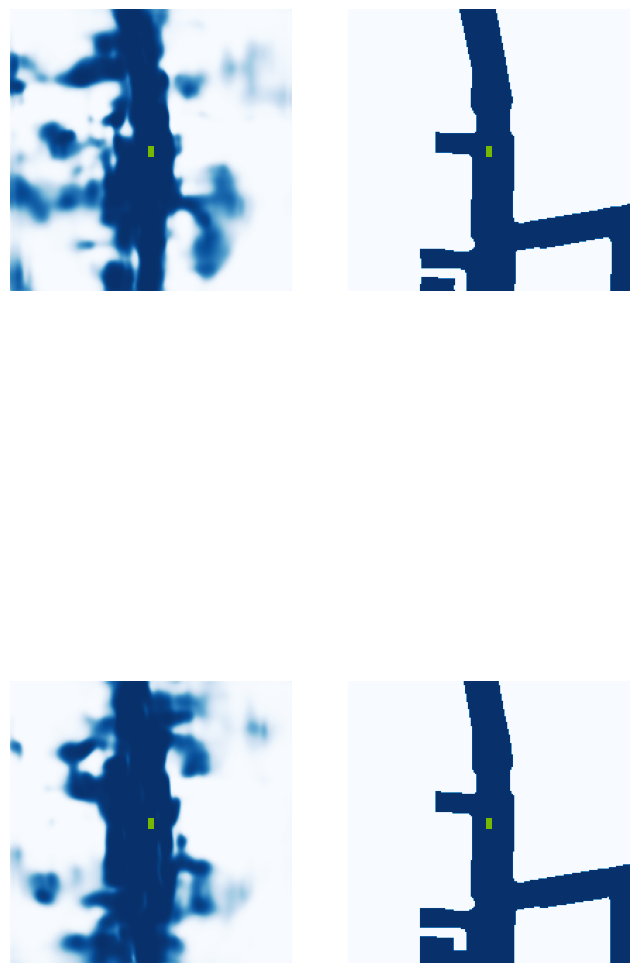

 68%|██████▊   | 27/40 [00:06<00:02,  5.02it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.40.jpg


 75%|███████▌  | 30/40 [00:07<00:01,  6.55it/s]

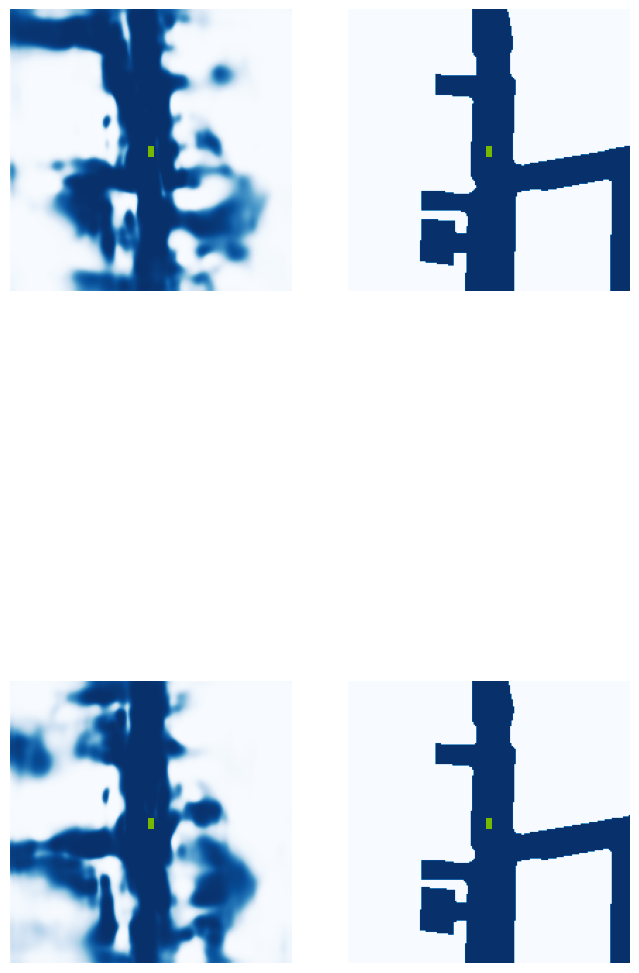

 80%|████████  | 32/40 [00:07<00:01,  4.33it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.37.jpg


 88%|████████▊ | 35/40 [00:08<00:00,  6.03it/s]

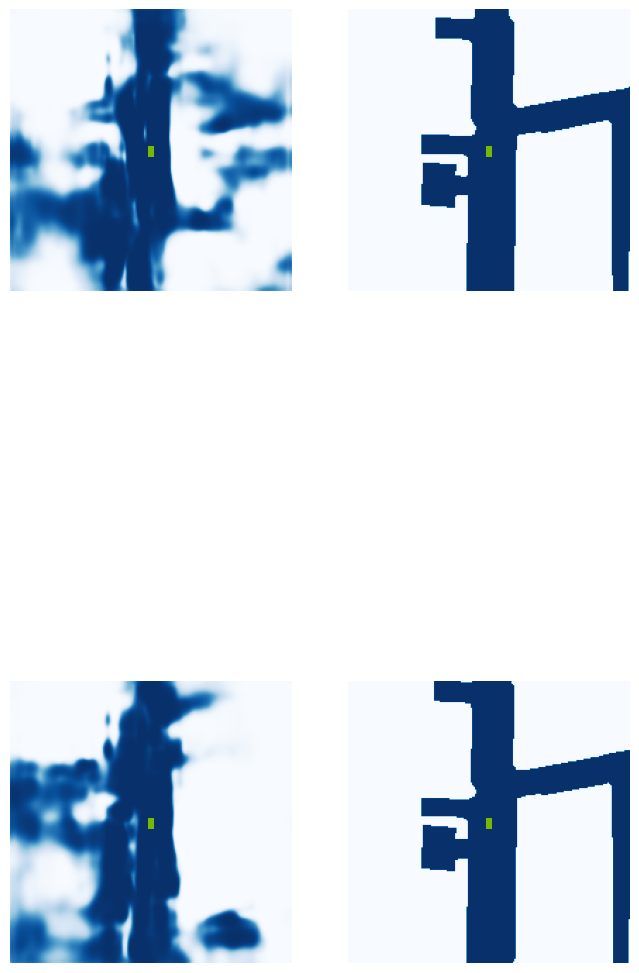

 92%|█████████▎| 37/40 [00:08<00:00,  5.17it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.38.jpg


100%|██████████| 40/40 [00:09<00:00,  4.35it/s]


VAL {'loss': 1.622157370602643, 'iou': 0.3989671649720724}
saving ...  ./runs/model7500.pt
7510 0.1515055149793625
7520 0.05466972663998604
7530 0.09958627820014954
7540 0.08405338227748871
7550 0.04485583305358887
7560 0.08864285796880722
Epoch: 48/60
7570 0.08565619587898254
7580 0.03923772647976875
7590 0.05713867023587227
7600 0.03545486181974411
7610 0.036304622888565063
7620 0.13618995249271393
7630 0.09512072056531906
7640 0.07099416106939316
7650 0.05678616836667061
7660 0.12034443020820618
7670 0.07688077539205551
7680 0.10715319216251373
7690 0.0671159029006958
7700 0.05966963246464729
7710 0.08462637662887573
7720 0.029572853818535805
Epoch: 49/60
7730 0.09063190966844559
7740 0.04924558475613594
7750 0.04114995524287224
7760 0.13068334758281708
7770 0.05792797729372978
7780 0.05162348598241806
7790 0.050894975662231445
7800 0.11024811863899231
7810 0.06471362709999084
7820 0.11679650843143463
7830 0.03699978440999985
7840 0.08239030092954636
7850 0.10981591790914536
7860 0.

  0%|          | 0/40 [00:00<?, ?it/s]

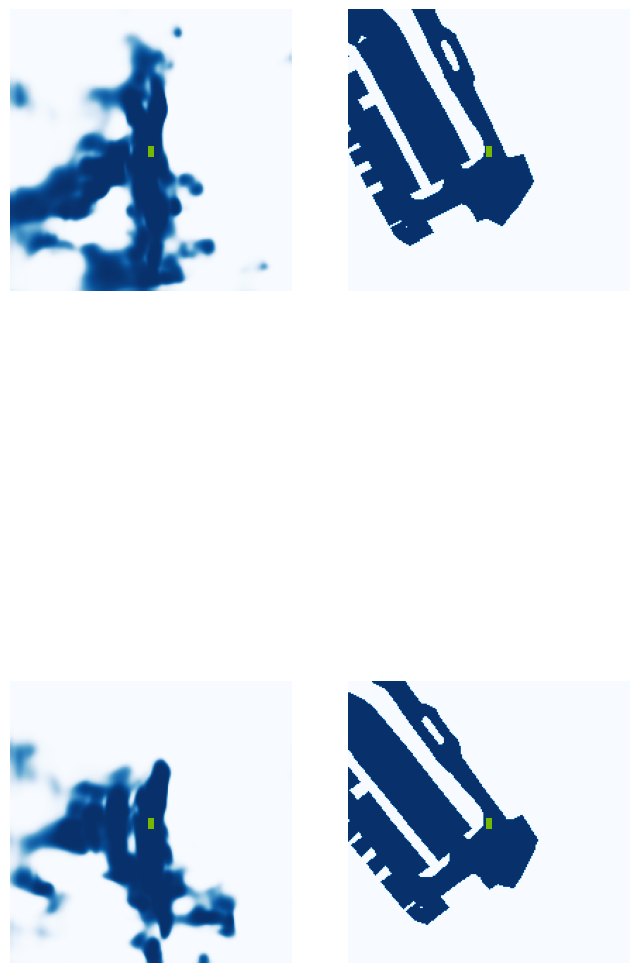

  5%|▌         | 2/40 [00:01<00:20,  1.86it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.27.jpg


 12%|█▎        | 5/40 [00:01<00:08,  4.00it/s]

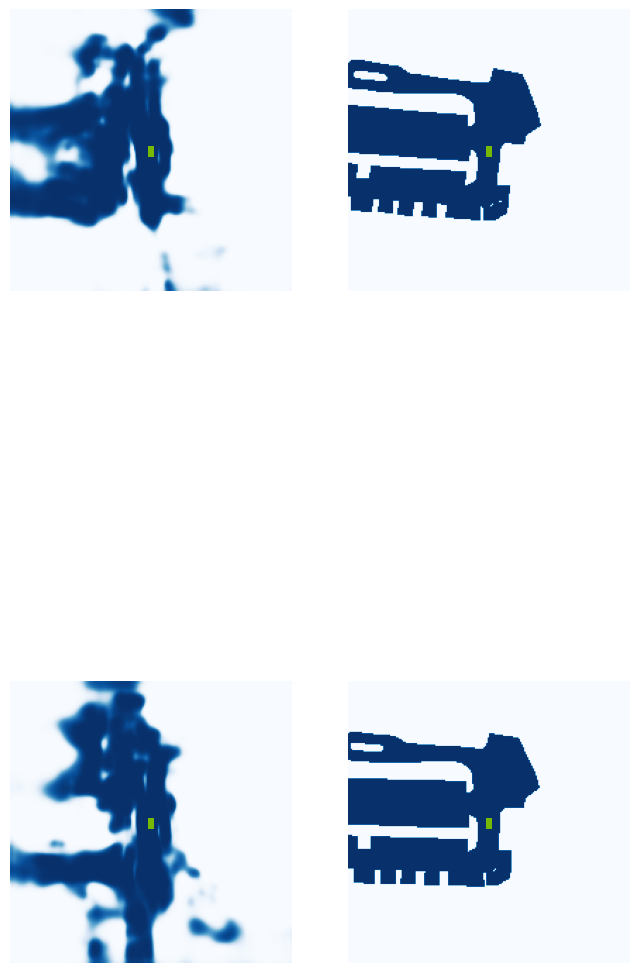

 18%|█▊        | 7/40 [00:02<00:08,  4.08it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.44.jpg


 25%|██▌       | 10/40 [00:02<00:06,  4.97it/s]

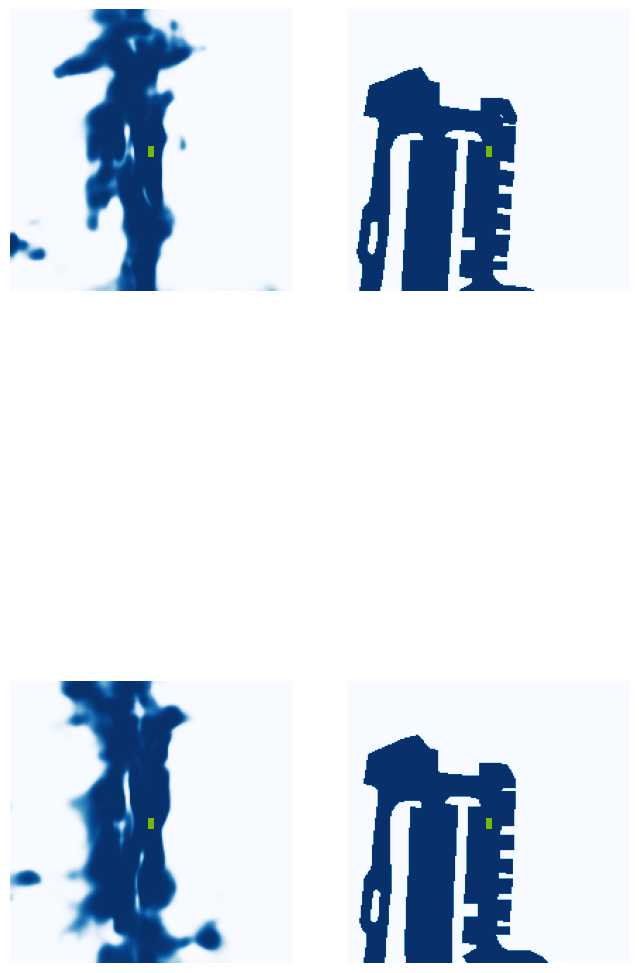

 30%|███       | 12/40 [00:03<00:07,  3.60it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.34.jpg


 38%|███▊      | 15/40 [00:04<00:05,  4.63it/s]

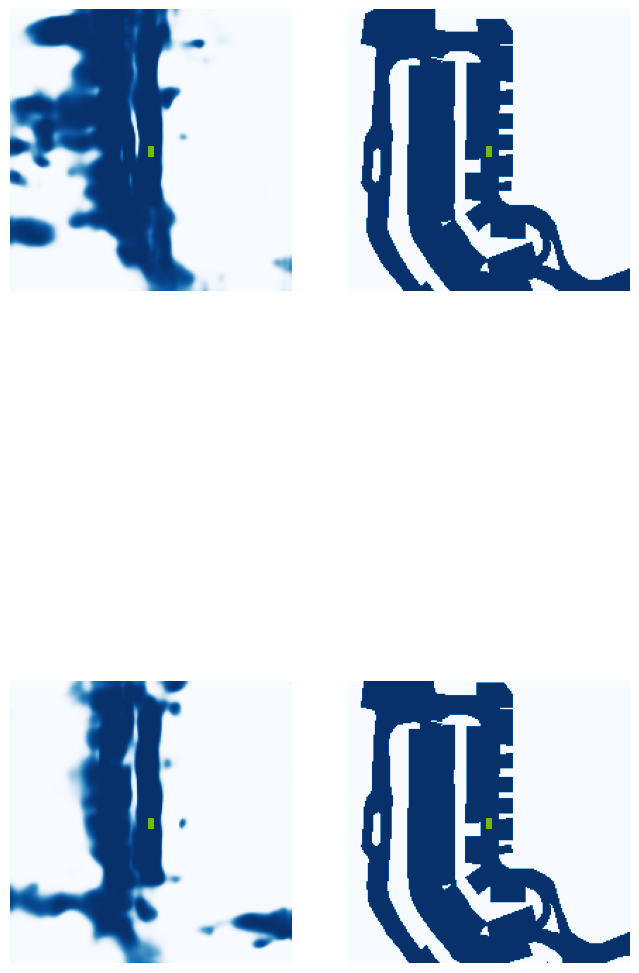

 42%|████▎     | 17/40 [00:04<00:05,  4.57it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.44.jpg


 48%|████▊     | 19/40 [00:04<00:04,  4.77it/s]

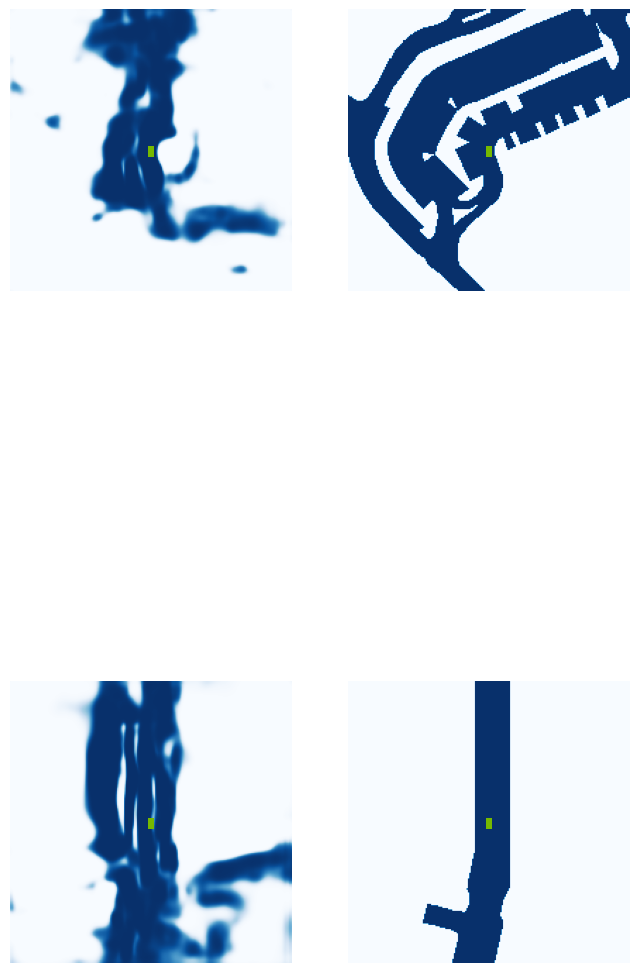

 55%|█████▌    | 22/40 [00:05<00:04,  4.29it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.29.jpg


 62%|██████▎   | 25/40 [00:06<00:02,  6.26it/s]

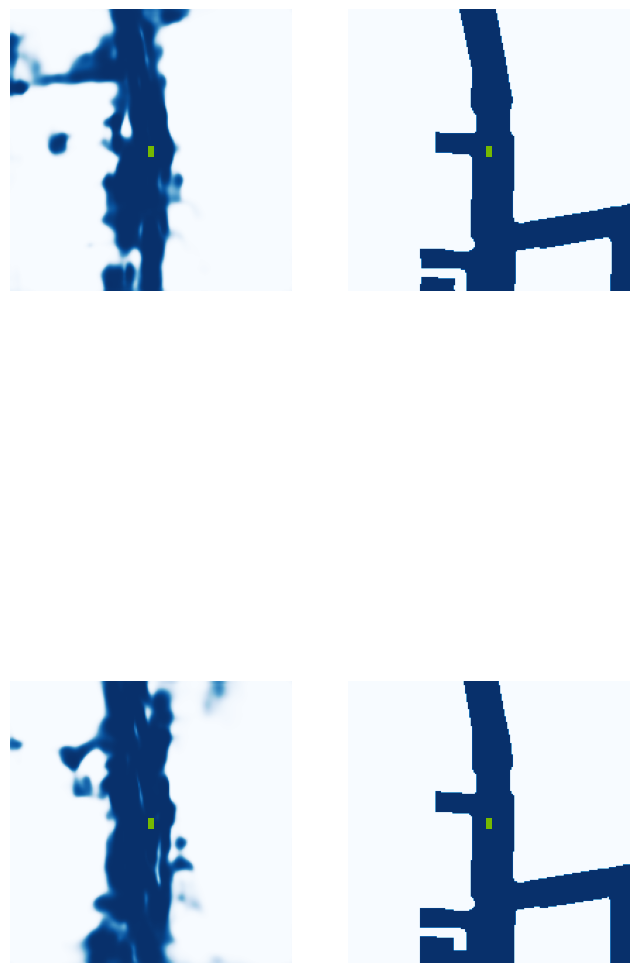

 70%|███████   | 28/40 [00:06<00:02,  5.87it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.42.jpg


 72%|███████▎  | 29/40 [00:06<00:01,  5.58it/s]

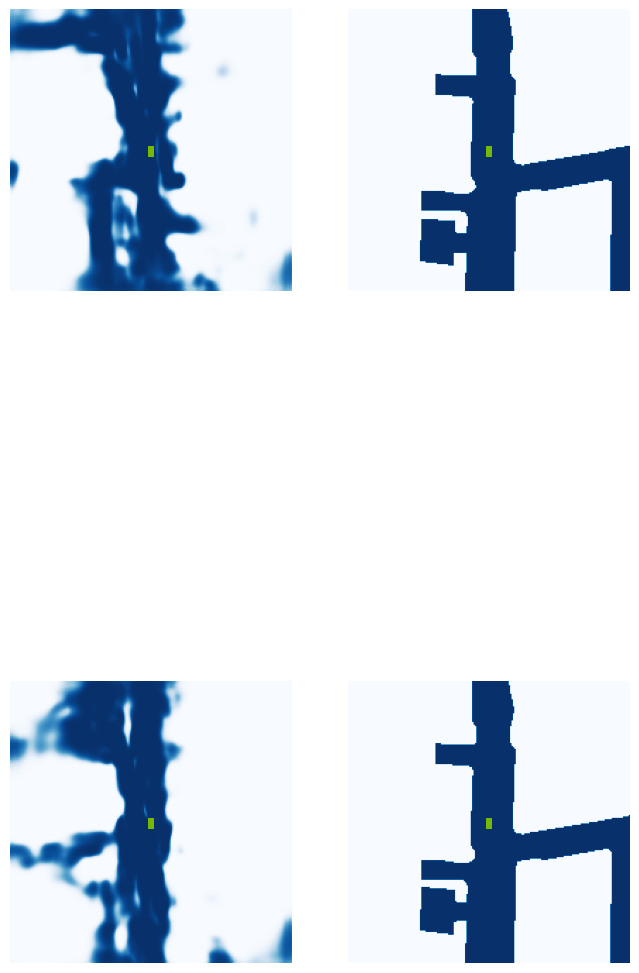

 80%|████████  | 32/40 [00:07<00:01,  4.79it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.41.jpg


 88%|████████▊ | 35/40 [00:08<00:00,  6.23it/s]

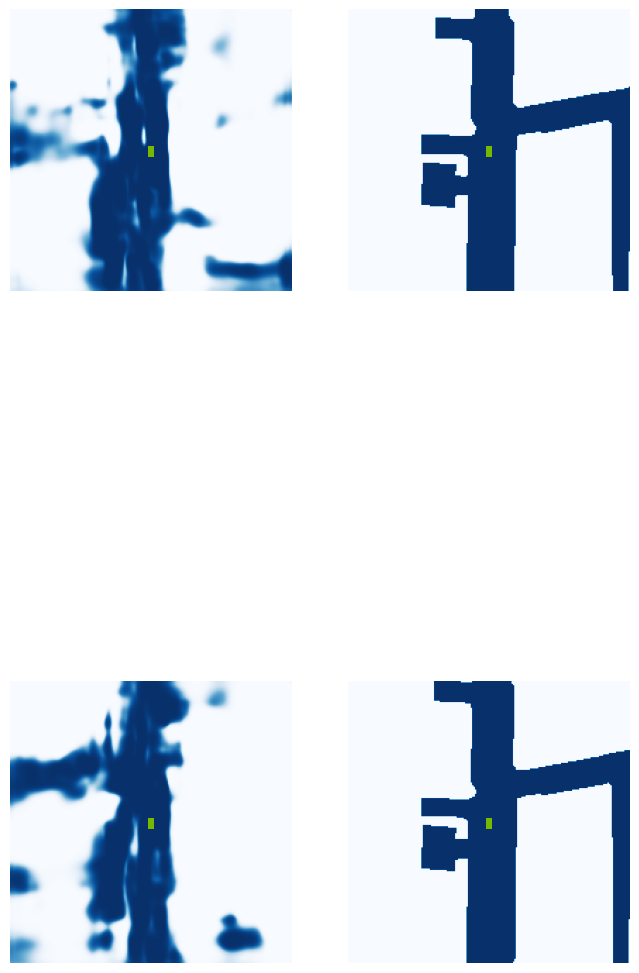

 92%|█████████▎| 37/40 [00:08<00:00,  4.86it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.40.jpg


100%|██████████| 40/40 [00:09<00:00,  4.43it/s]


VAL {'loss': 2.532811919848124, 'iou': 0.3906478246942319}
saving ...  ./runs/model8000.pt
8010 0.10995082557201385
8020 0.16005268692970276
8030 0.04608885943889618
8040 0.0644911453127861
8050 0.055640000849962234
Epoch: 51/60
8060 0.09009943902492523
8070 0.06500844657421112
8080 0.08404358476400375
8090 0.13882213830947876
8100 0.10297854989767075
8110 0.046186212450265884
8120 0.08085869252681732
8130 0.1071581020951271
8140 0.14418937265872955
8150 0.047271110117435455
8160 0.14927144348621368
8170 0.047011759132146835
8180 0.18210379779338837
8190 0.04749084264039993
8200 0.06738996505737305
8210 0.04654313996434212
Epoch: 52/60
8220 0.07139729708433151
8230 0.04701817408204079
8240 0.027710573747754097
8250 0.056309472769498825
8260 0.15959778428077698
8270 0.08724410086870193
8280 0.12367897480726242
8290 0.023261958733201027
8300 0.04356333985924721
8310 0.07239978015422821
8320 0.04181899130344391
8330 0.14508527517318726
8340 0.03651973605155945
8350 0.08134911209344864
836

  0%|          | 0/40 [00:00<?, ?it/s]

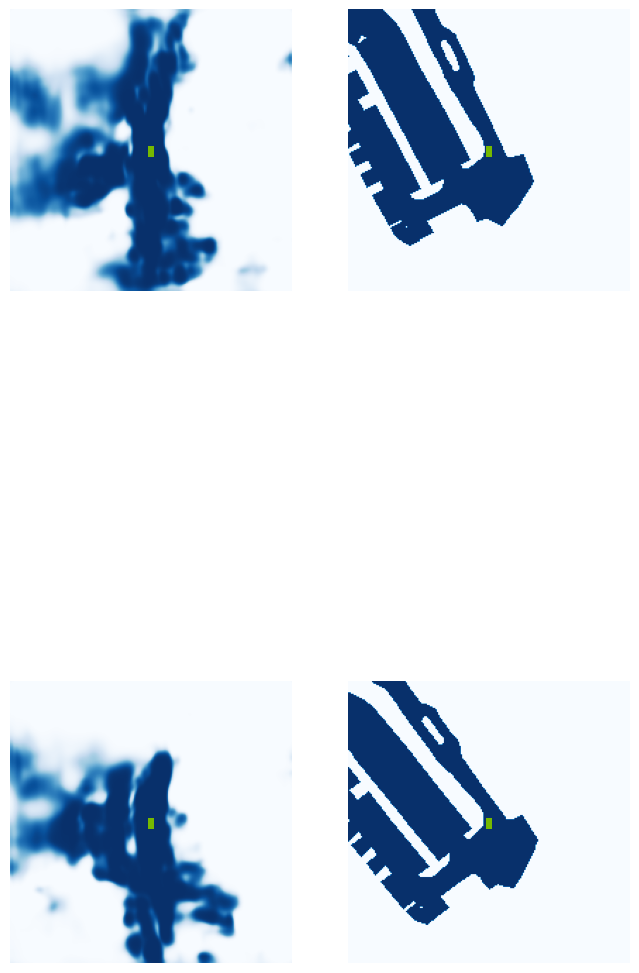

  5%|▌         | 2/40 [00:01<00:20,  1.87it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.33.jpg


 12%|█▎        | 5/40 [00:01<00:07,  4.38it/s]

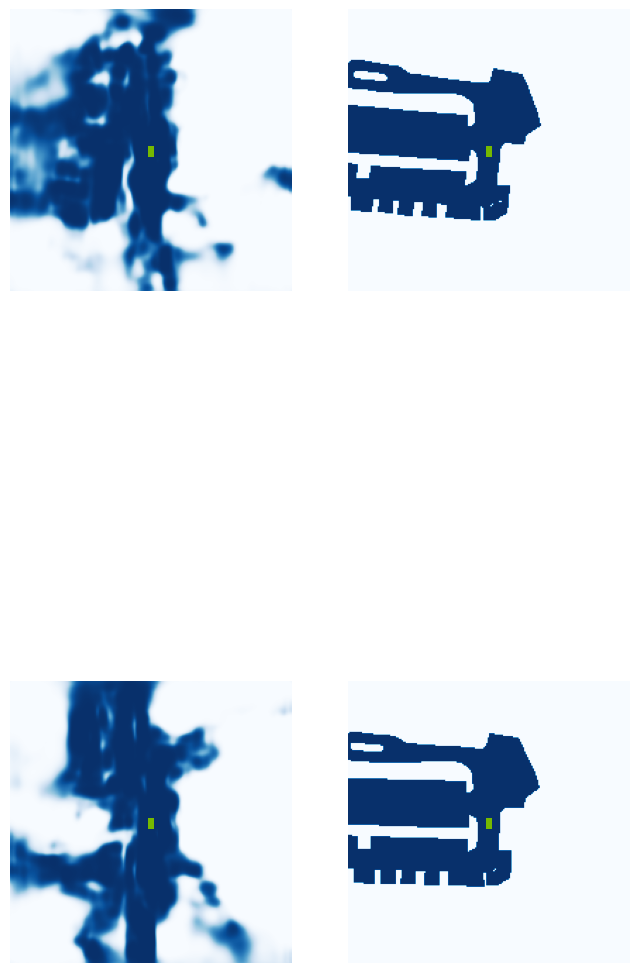

 18%|█▊        | 7/40 [00:02<00:07,  4.15it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.41.jpg


 25%|██▌       | 10/40 [00:02<00:05,  5.43it/s]

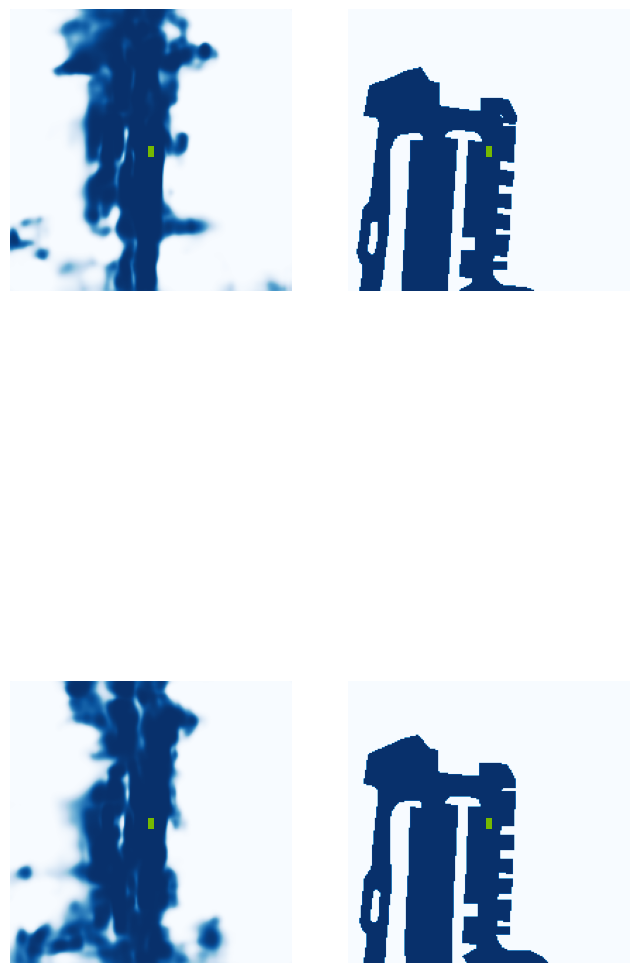

 32%|███▎      | 13/40 [00:03<00:05,  4.68it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.37.jpg


 38%|███▊      | 15/40 [00:03<00:05,  4.61it/s]

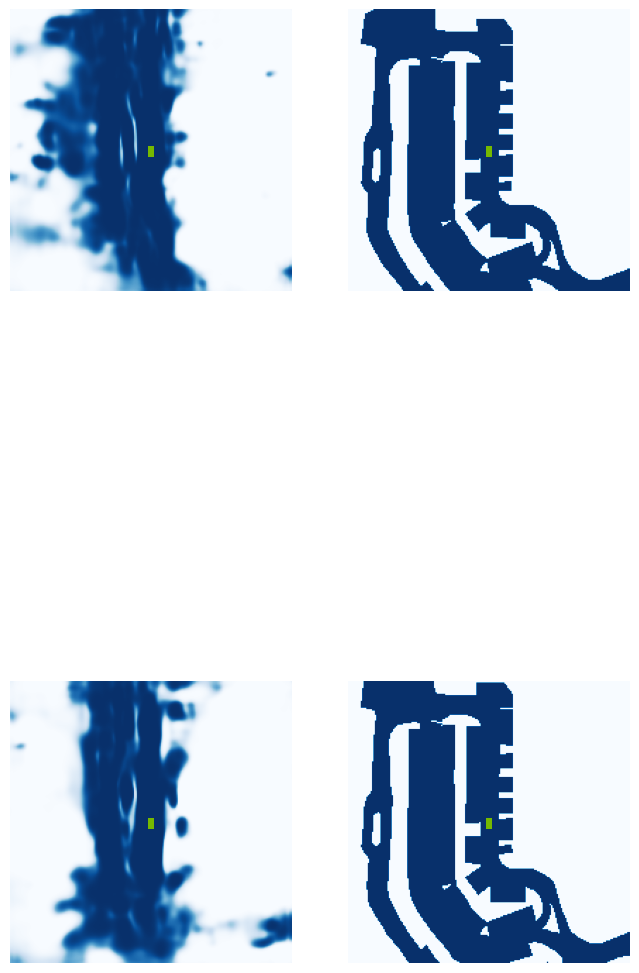

 42%|████▎     | 17/40 [00:04<00:05,  3.97it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.53.jpg


 50%|█████     | 20/40 [00:05<00:04,  4.36it/s]

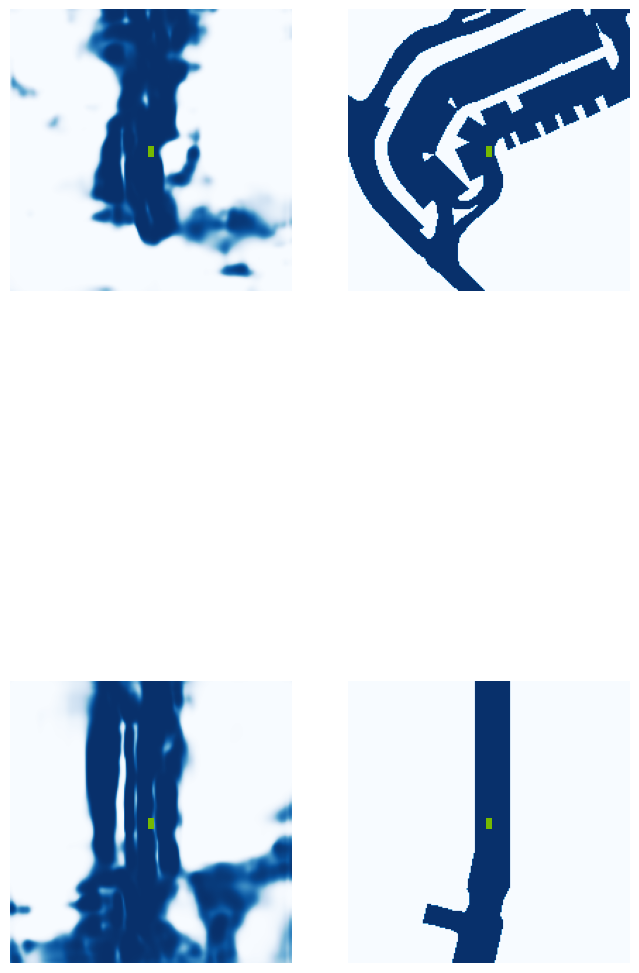

 55%|█████▌    | 22/40 [00:05<00:04,  4.02it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.28.jpg


 62%|██████▎   | 25/40 [00:06<00:02,  5.49it/s]

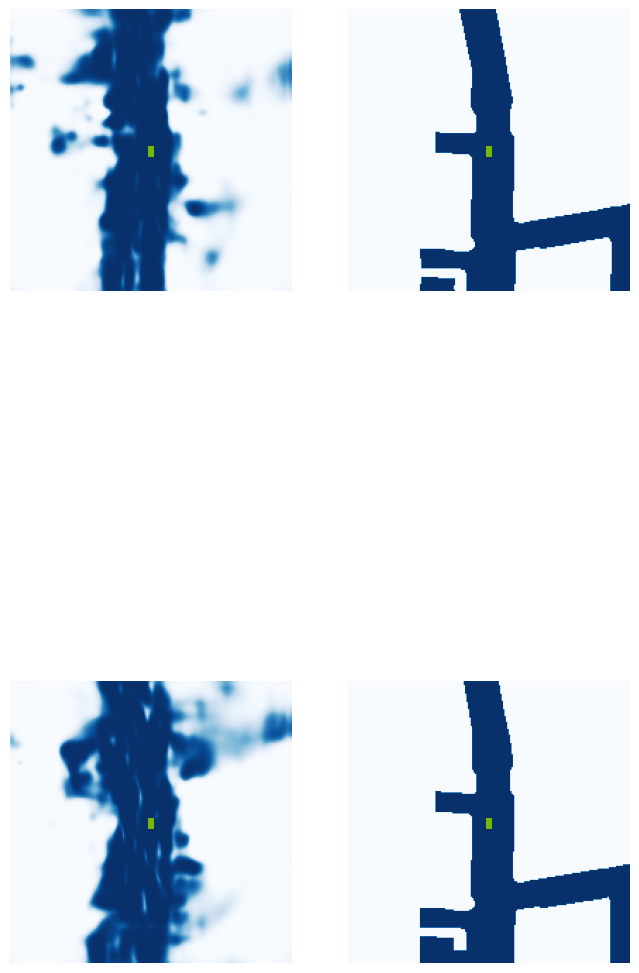

 68%|██████▊   | 27/40 [00:06<00:03,  4.12it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.42.jpg


 75%|███████▌  | 30/40 [00:07<00:01,  5.56it/s]

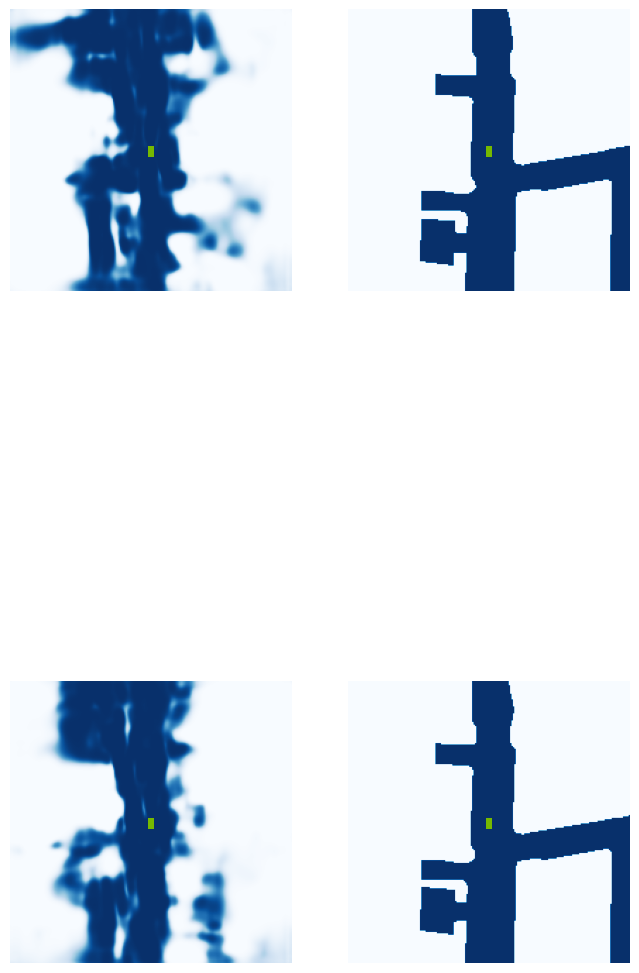

 80%|████████  | 32/40 [00:07<00:01,  4.49it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.40.jpg


 88%|████████▊ | 35/40 [00:08<00:00,  5.96it/s]

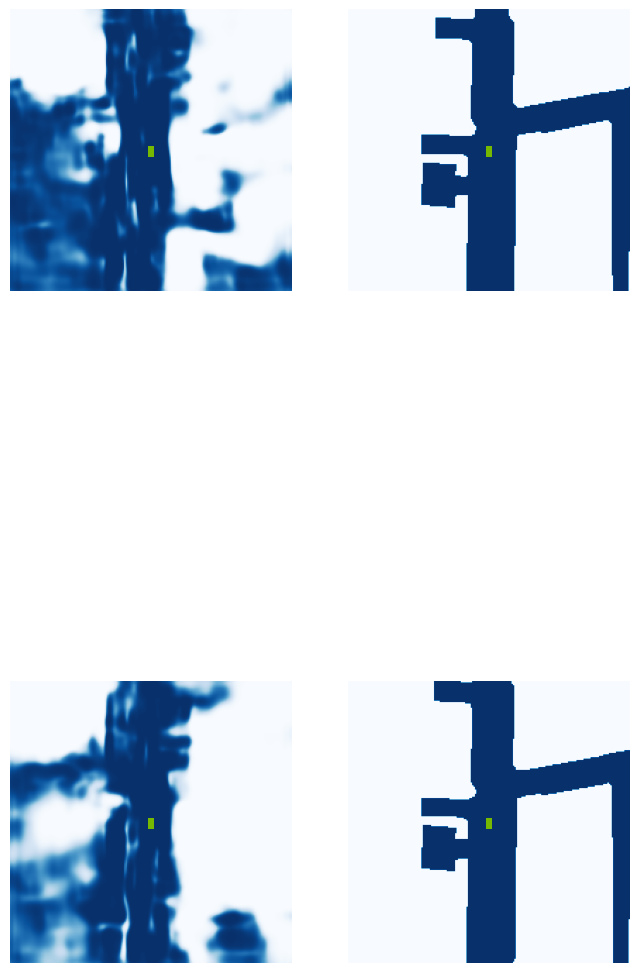

 92%|█████████▎| 37/40 [00:08<00:00,  4.46it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.31.jpg


100%|██████████| 40/40 [00:09<00:00,  4.34it/s]


VAL {'loss': 2.010449594921536, 'iou': 0.40156895609787147}
saving ...  ./runs/model8500.pt
8510 0.042786773294210434
8520 0.054180730134248734
8530 0.06983131170272827
Epoch: 54/60
8540 0.06968020647764206
8550 0.06720656901597977
8560 0.05444316938519478
8570 0.030573656782507896
8580 0.08604127913713455
8590 0.042718902230262756
8600 0.057398442178964615
8610 0.05962356925010681
8620 0.045383404940366745
8630 0.05416620522737503
8640 0.07965438067913055
8650 0.044381625950336456
8660 0.14510776102542877
8670 0.074563167989254
8680 0.03908664360642433
8690 0.050382018089294434
Epoch: 55/60
8700 0.06368594616651535
8710 0.046638548374176025
8720 0.029239049181342125
8730 0.04158778116106987
8740 0.06403834372758865
8750 0.1170358881354332
8760 0.05643702298402786
8770 0.06536142528057098
8780 0.05920640751719475
8790 0.0497889444231987
8800 0.05855698138475418
8810 0.044082045555114746
8820 0.039435967803001404
8830 0.04043101146817207
8840 0.08530690521001816
8850 0.13044078648090363

  0%|          | 0/40 [00:00<?, ?it/s]

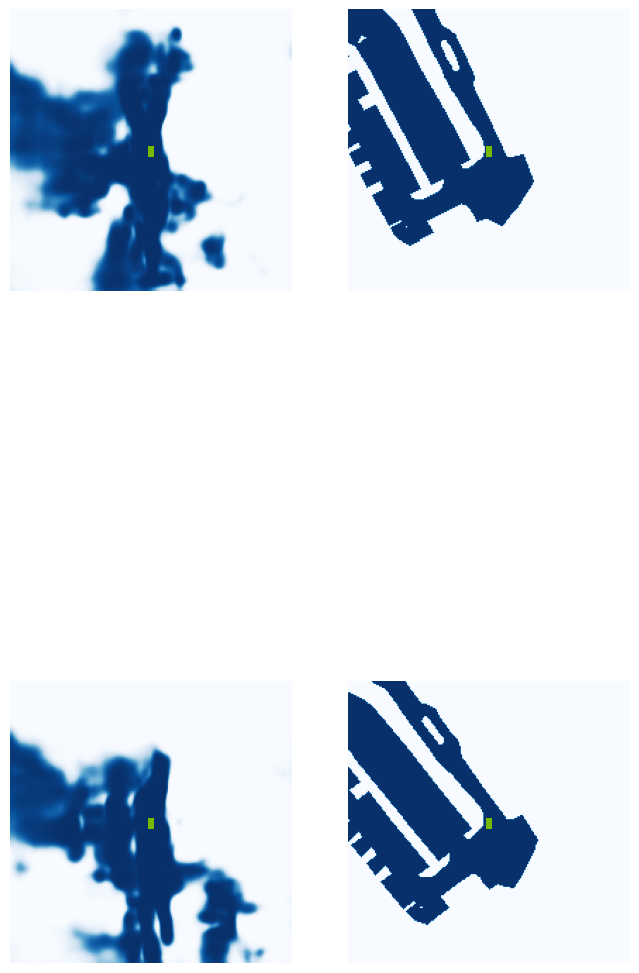

  5%|▌         | 2/40 [00:01<00:20,  1.89it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.39.jpg


 12%|█▎        | 5/40 [00:01<00:08,  3.99it/s]

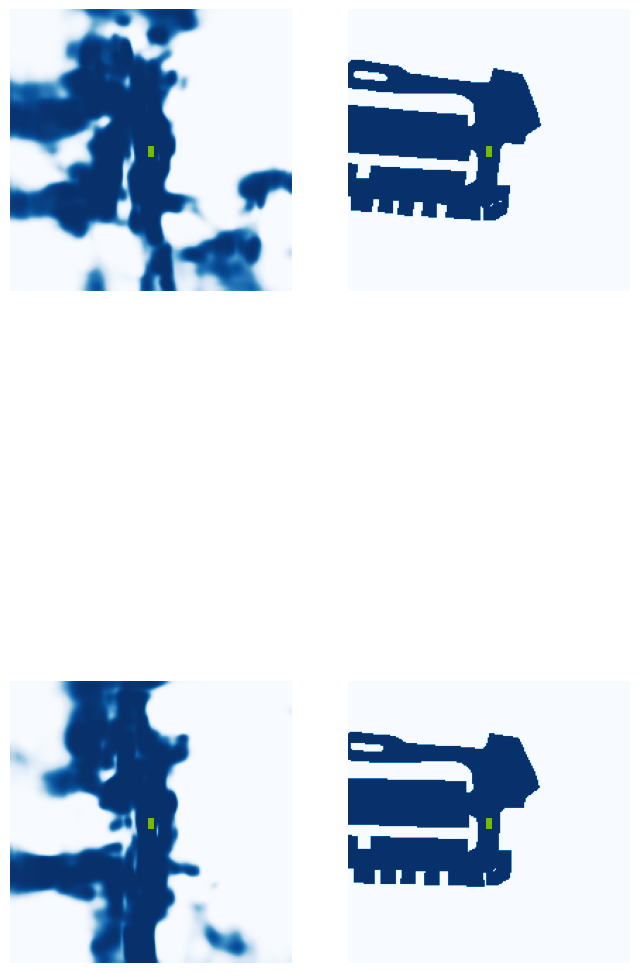

 18%|█▊        | 7/40 [00:02<00:10,  3.08it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.37.jpg


 22%|██▎       | 9/40 [00:02<00:06,  4.54it/s]

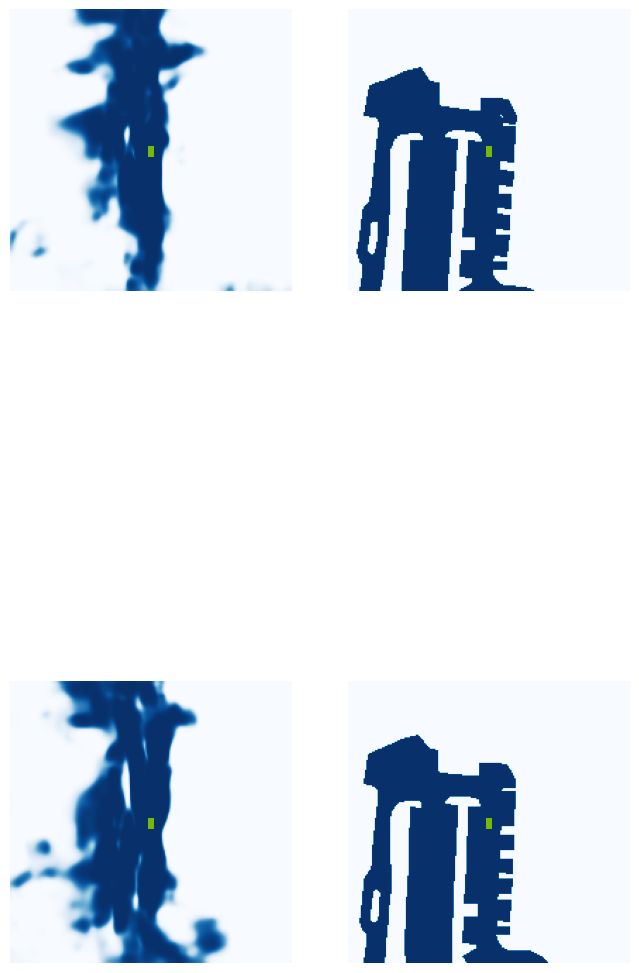

 30%|███       | 12/40 [00:03<00:05,  4.74it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.35.jpg


 38%|███▊      | 15/40 [00:04<00:05,  4.65it/s]

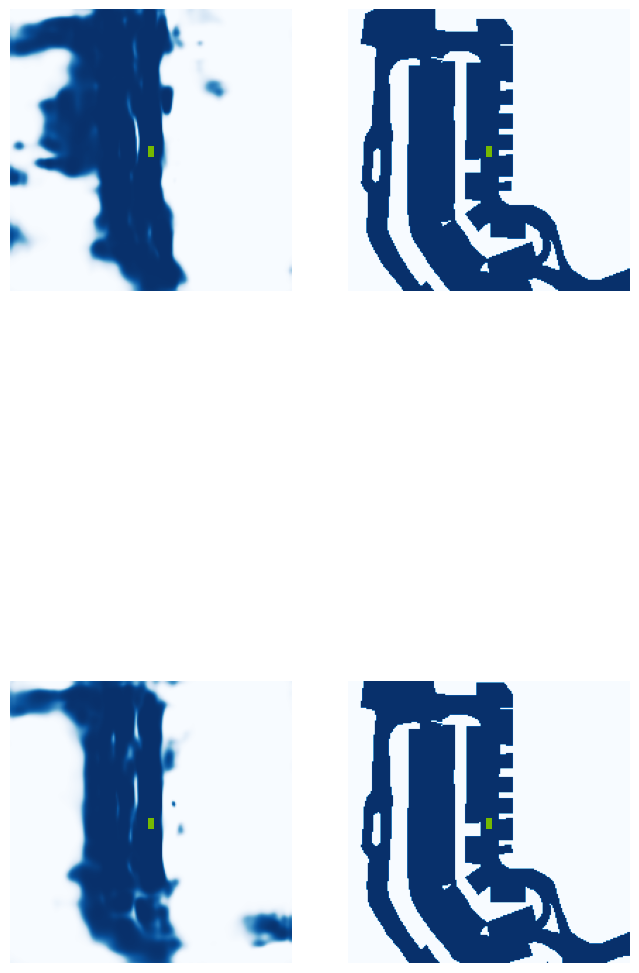

 42%|████▎     | 17/40 [00:04<00:05,  4.41it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.50.jpg


 50%|█████     | 20/40 [00:05<00:03,  5.06it/s]

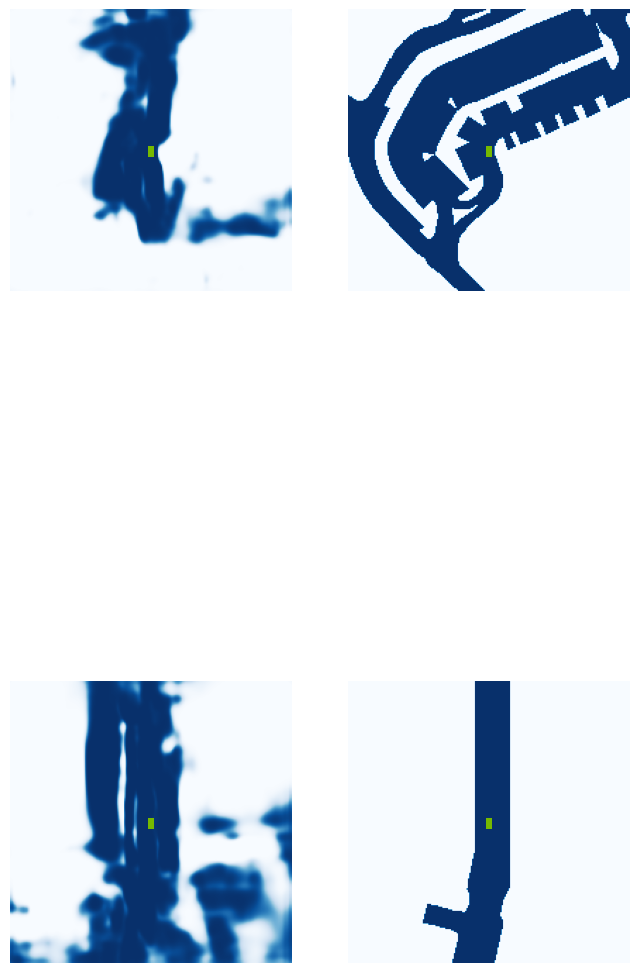

 55%|█████▌    | 22/40 [00:05<00:04,  3.94it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.27.jpg


 62%|██████▎   | 25/40 [00:06<00:02,  5.44it/s]

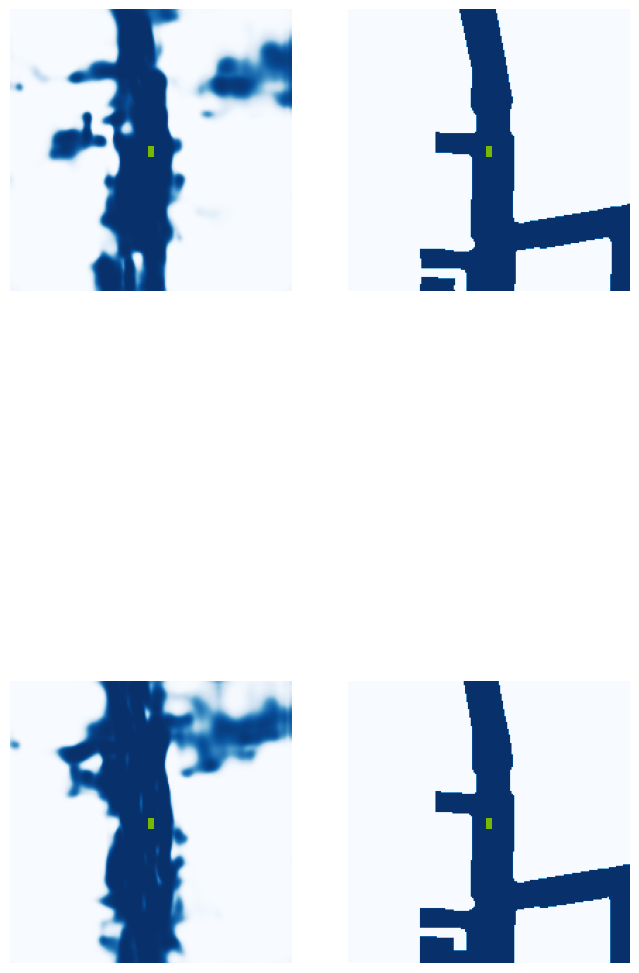

 68%|██████▊   | 27/40 [00:06<00:02,  4.89it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.38.jpg


 72%|███████▎  | 29/40 [00:07<00:01,  5.55it/s]

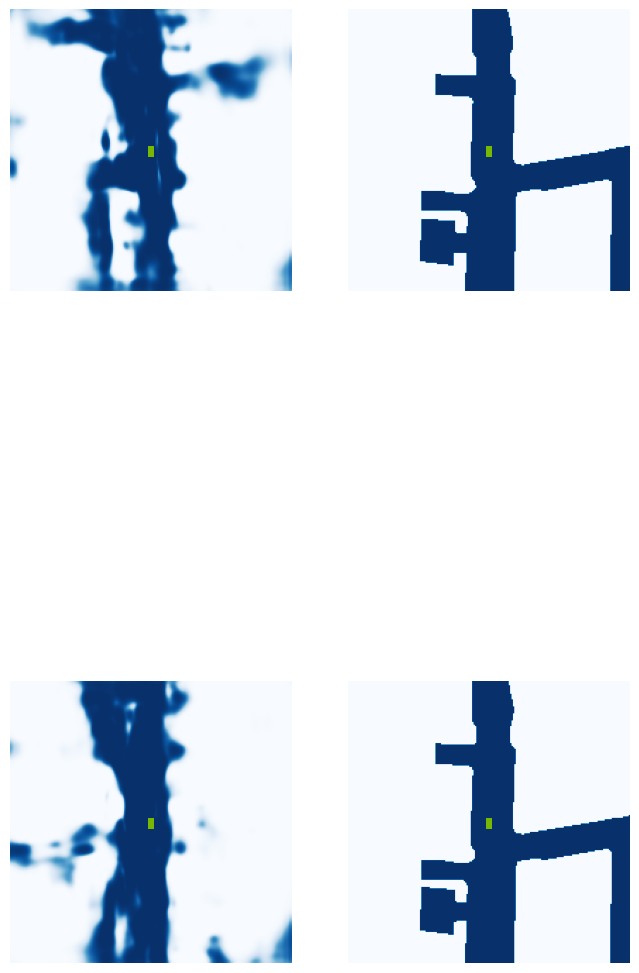

 80%|████████  | 32/40 [00:07<00:01,  4.61it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.43.jpg


 88%|████████▊ | 35/40 [00:08<00:00,  5.94it/s]

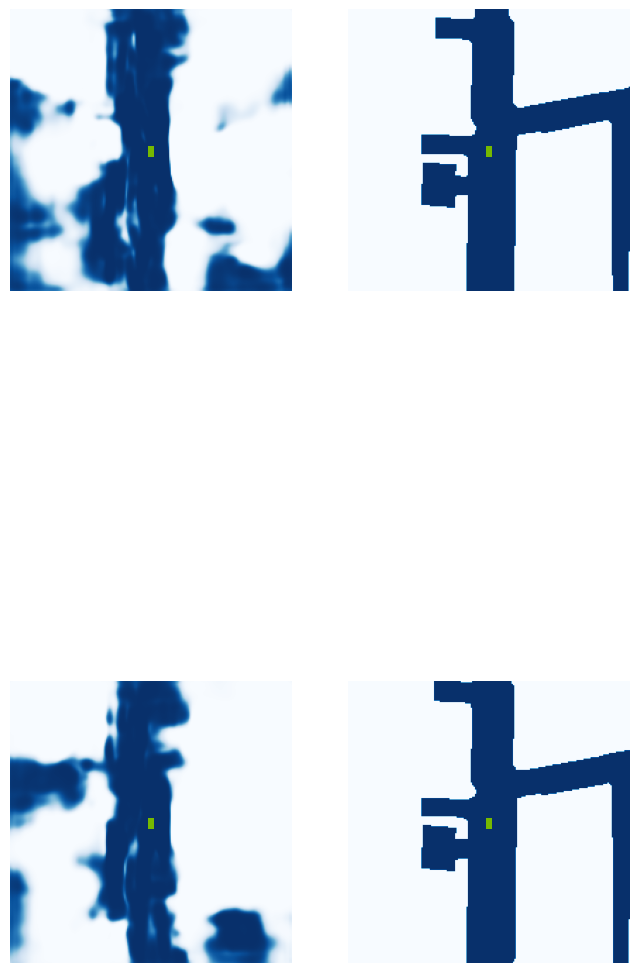

 92%|█████████▎| 37/40 [00:08<00:00,  5.16it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.37.jpg


100%|██████████| 40/40 [00:09<00:00,  4.37it/s]


VAL {'loss': 2.3642841297903177, 'iou': 0.38940319676669405}
saving ...  ./runs/model9000.pt
9010 0.04349545016884804
Epoch: 57/60
9020 0.11691182851791382
9030 0.09655249118804932
9040 0.11263816803693771
9050 0.05267917364835739
9060 0.04897398501634598
9070 0.07236582040786743
9080 0.048826031386852264
9090 0.06744301319122314
9100 0.09731297194957733
9110 0.08332822471857071
9120 0.06283137202262878
9130 0.06626225262880325
9140 0.0746074840426445
9150 0.08020970225334167
9160 0.1015654131770134
9170 0.08122953027486801
Epoch: 58/60
9180 0.030923375859856606
9190 0.042484793812036514
9200 0.04427802190184593
9210 0.057974930852651596
9220 0.03782438114285469
9230 0.04804905503988266
9240 0.025148561224341393
9250 0.05641816928982735
9260 0.042554620653390884
9270 0.04504242539405823
9280 0.04587879031896591
9290 0.021764321252703667
9300 0.06832611560821533
9310 0.0671139508485794
9320 0.058481521904468536
9330 0.06041084975004196
Epoch: 59/60
9340 0.08351854234933853
9350 0.028379

  0%|          | 0/40 [00:00<?, ?it/s]

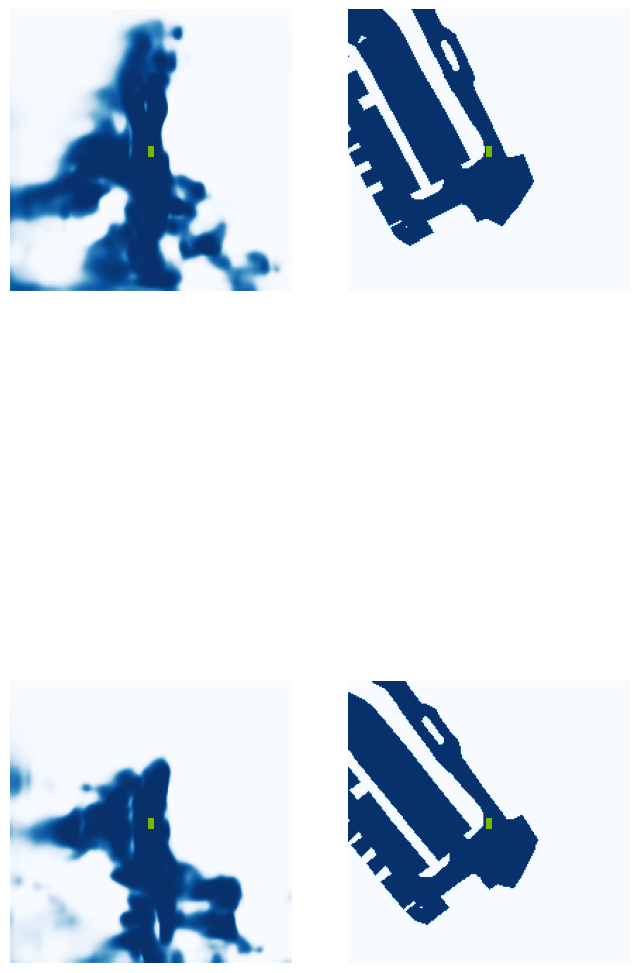

  5%|▌         | 2/40 [00:01<00:20,  1.85it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.25.jpg


 12%|█▎        | 5/40 [00:01<00:07,  4.44it/s]

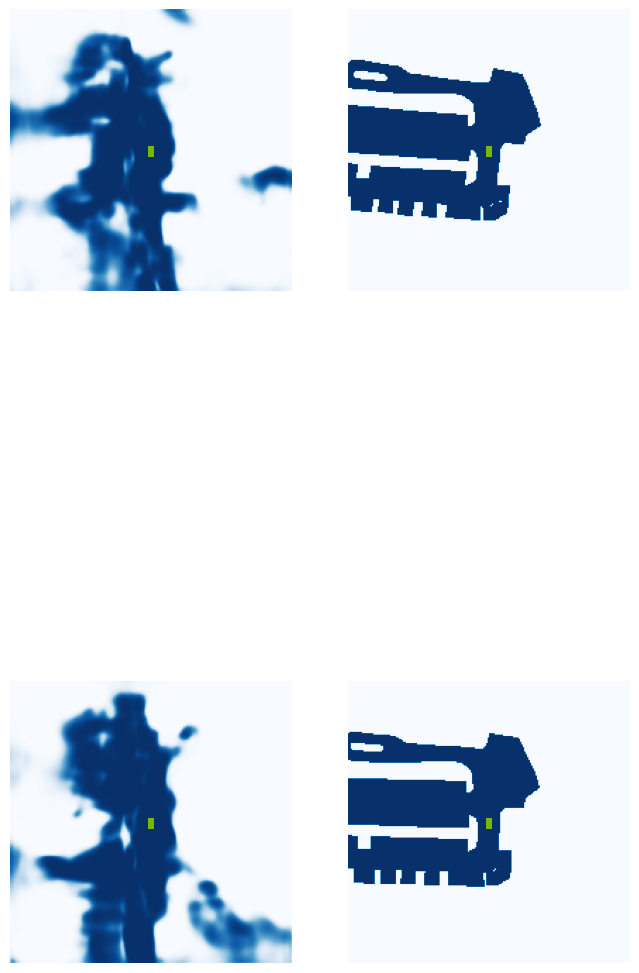

 18%|█▊        | 7/40 [00:02<00:07,  4.40it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.34.jpg


 25%|██▌       | 10/40 [00:02<00:05,  5.46it/s]

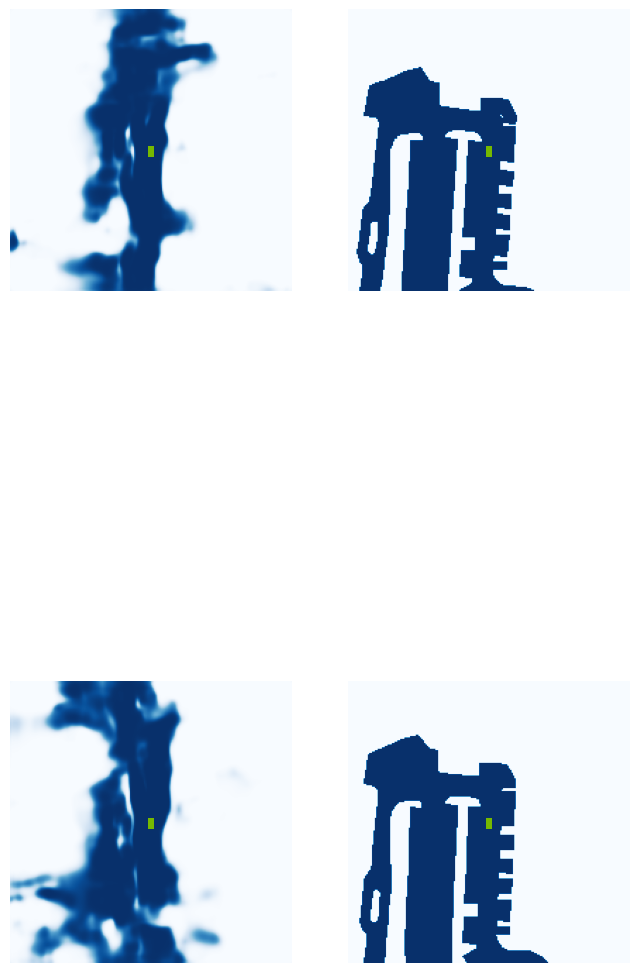

 32%|███▎      | 13/40 [00:03<00:05,  4.66it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.37.jpg


 38%|███▊      | 15/40 [00:03<00:05,  4.36it/s]

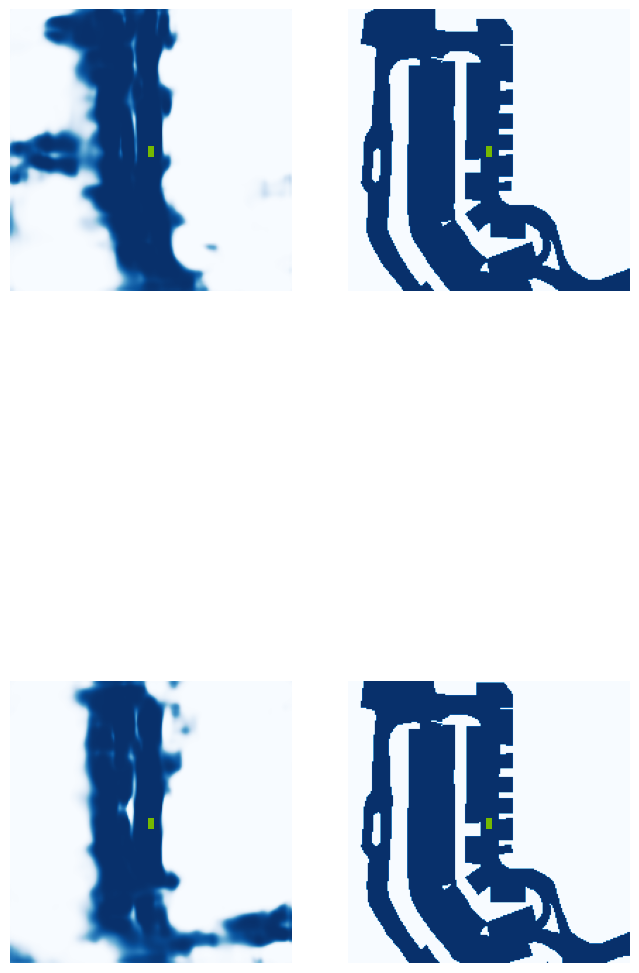

 42%|████▎     | 17/40 [00:04<00:05,  4.45it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.46.jpg


 50%|█████     | 20/40 [00:04<00:03,  5.32it/s]

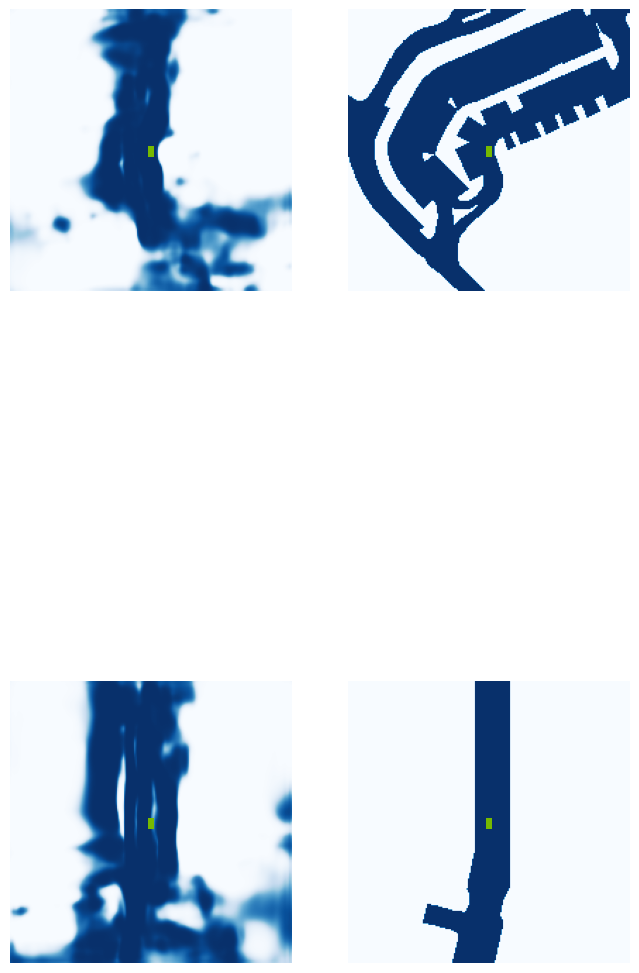

 55%|█████▌    | 22/40 [00:05<00:04,  4.04it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.26.jpg


 62%|██████▎   | 25/40 [00:06<00:02,  6.09it/s]

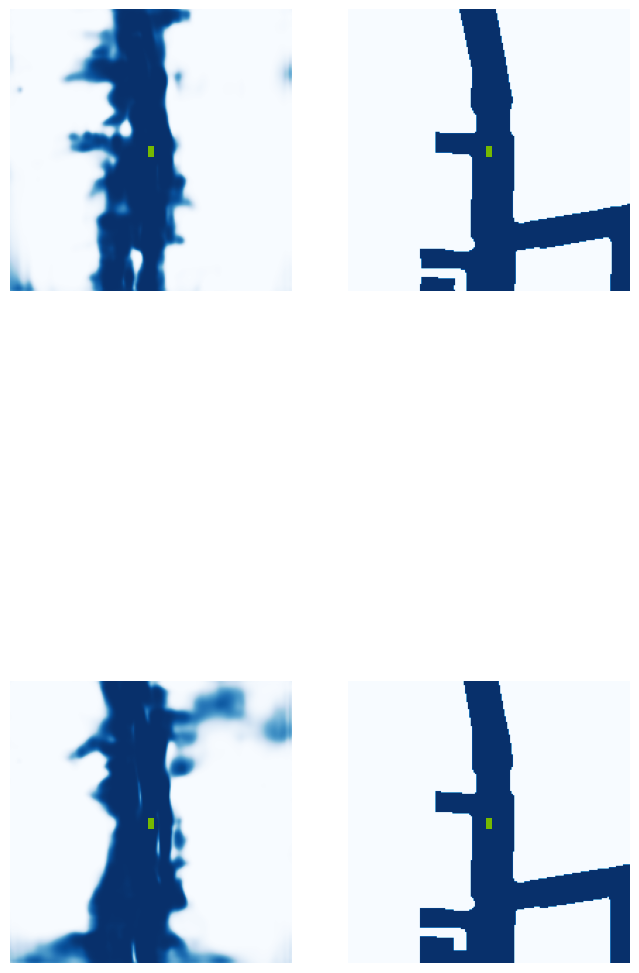

 70%|███████   | 28/40 [00:06<00:02,  5.87it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.44.jpg


 72%|███████▎  | 29/40 [00:06<00:02,  5.47it/s]

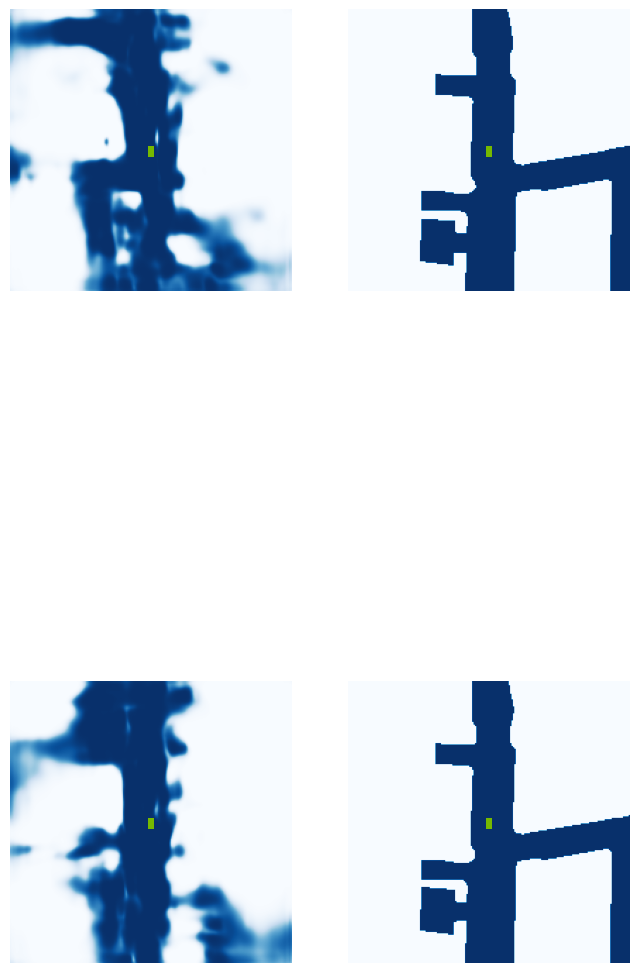

 80%|████████  | 32/40 [00:07<00:01,  4.48it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.40.jpg


 88%|████████▊ | 35/40 [00:07<00:00,  6.23it/s]

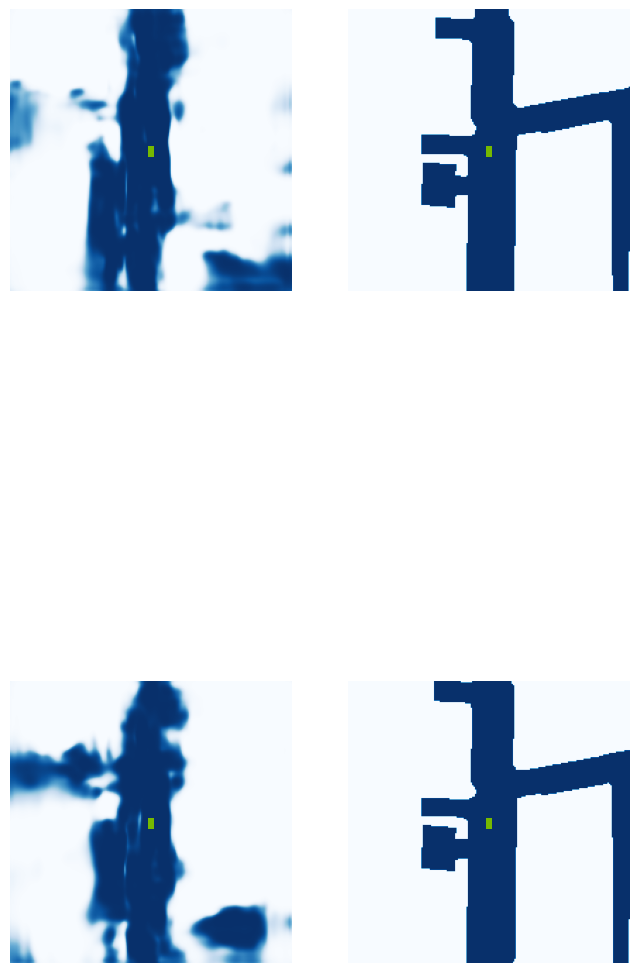

 92%|█████████▎| 37/40 [00:08<00:00,  3.70it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.41.jpg


100%|██████████| 40/40 [00:09<00:00,  4.32it/s]


VAL {'loss': 2.3829007060439498, 'iou': 0.39339770093922605}
saving ...  ./runs/model9500.pt
9510 0.14865612983703613
9520 0.02762901596724987
9530 0.0829448327422142
9540 0.05485310032963753
9550 0.11276977509260178
9560 0.06989632546901703
9570 0.07847001403570175
9580 0.05877276510000229
9590 0.016782525926828384
9600 0.025415509939193726
9610 0.03480030968785286
9620 0.026433782652020454
9630 0.04013924300670624
9640 0.06447185575962067
9650 0.026201726868748665
9660 0.07759957760572433


In [ ]:

#Now we want to actually call this function
train(train_label=train_label,
  version = version,
  dataroot= dataroot,
  nepochs = nepochs, #60 for full runs
  gpuid = gpuid, #since only one GPU is available and we start counting from 0
  H = H,
  W = W,
  resize_lim = resize_lim,
  final_dim = final_dim,
  bot_pct_lim = bot_pct_lim,
  rot_lim = rot_lim,
  rand_flip = rand_flip,
  ncams = ncams,
  max_grad_norm = max_grad_norm,
  pos_weight = pos_weight,
  logdir = logdir,
  xbound = xbound,
  ybound = ybound,
  zbound = zbound,
  dbound = dbound,
  decoder_mode = decoder_mode,

  bsz = bsz,
  nworkers = nworkers,
  lr = lr,
  weight_decay = weight_decay,
  num_points = num_points,
  n_points = n_points,

  max_points_voxel = max_points_voxel,
  max_voxels = max_voxels,
  input_features = input_features,
  use_norm = use_norm,
  vfe_filters = vfe_filters,
  with_distance = with_distance
      )

###Show loss and IOU statistics for train and val inline through Tensorboard

In [ ]:
%load_ext tensorboard
%tensorboard --logdir=runs

<IPython.core.display.Javascript object>

###Define helper functions for visualisations (as per "explore.py" in TF Grid)

In [ ]:
#All of the below is effectively taken from the explore.py file - want to run tests to make sure this works

import torch
import matplotlib as mpl
mpl.use('Agg')
import matplotlib.pyplot as plt
from PIL import Image
import matplotlib.patches as mpatches

#fixing relative imports - due to change made in __init__.py
from data import compile_data
from tools import (ego_to_cam, get_only_in_img_mask, denormalize_img,
                    SimpleLoss, get_val_info, add_ego, gen_dx_bx,
                    get_nusc_maps, plot_nusc_map, points_to_voxel_loop) #NB CHANGE FROM LSS CODE - NEED points_to_voxel_loop to be able to assign
                                                                        #voxels, coors, num_points to be able to pass this in forward pass of model
                                                                        #same as in train.py
from models_base import compile_model

#This is a visual check on input/output data - see Lift Splat Shoot GitHub home page
#We want to check that inputs/outputs are being parsed correctly
#passing viz_train = True allows us to see data augmentation
def lidar_check(train_label = train_label,
                version = version,
                dataroot = dataroot,
                show_lidar = show_lidar, #want to see lidar scans
                viz_train = viz_train, #set this to True to see data augmentation and visualise train data rather than val data
                nepochs=1, #SET THIS EXPLICITLY IN FUNCTION DEF - only want to train for a single epoch - just to visualise

                H = H, W = W,
                resize_lim = resize_lim,
                final_dim = final_dim,
                bot_pct_lim = bot_pct_lim,
                rot_lim = rot_lim,
                rand_flip = rand_flip,

                xbound = xbound,
                ybound = ybound,
                zbound = zbound,
                dbound = dbound,
                decoder_mode = decoder_mode, #new param to control encoder setup

                bsz = bsz,
                nworkers = nworkers,
                num_classes = num_classes,
                num_points = num_points,
                n_points = n_points,

                max_points_voxel = max_points_voxel,
                max_voxels = max_voxels,
                input_features = input_features,
                use_norm = use_norm,
                vfe_filters = vfe_filters,
                with_distance = with_distance
                ):
  #set up param dicts based on passed params
    grid_conf = {
        'xbound': xbound,
        'ybound': ybound,
        'zbound': zbound,
        'dbound': dbound,
        'decoder_mode':decoder_mode #new parameter for decoder_mode to be passed as part of grid_conf
    } #set grid_conf
    cams = ['CAM_FRONT_LEFT', 'CAM_FRONT', 'CAM_FRONT_RIGHT',
                             'CAM_BACK_LEFT', 'CAM_BACK', 'CAM_BACK_RIGHT'] #specify names of cams
    data_aug_conf = {
                    'resize_lim': resize_lim,
                    'final_dim': final_dim,
                    'rot_lim': rot_lim,
                    'H': H, 'W': W,
                    'rand_flip': rand_flip,
                    'bot_pct_lim': bot_pct_lim,
                    'cams': cams,
                    'Ncams': 5, #HERE THIS IS BASED ON LSS AND IS PASSED EXPLICITLY
                } #set up data_aug_conf - NB THE REASON FOR ONLY 5 CAMS IS THIS WAS SHOWN TO INCREASE ROBUSTNESS IN TRAINING WHEN
                  #ONE CAMERA WAS RANDONLY DROPPED

    #NB - NEED TO FIX THIS IN MY OWN EXPLORE.PY FILE - Crucial difference with LSS is we also need cfg_pp to be defined, to be passed to compile_model
    cfg_pp = {
    'num_classes':num_classes,
    'num_points': num_points,
    'pc_range': [xbound[0],ybound[0],-4,xbound[1],ybound[1],4],
    'voxel_size' : [xbound[2],ybound[2],8],
    'max_points_voxel' : max_points_voxel,
    'max_voxels': max_voxels,
    'input_features': input_features,
    'batch_size': bsz,
    'use_norm': use_norm,
    'vfe_filters': vfe_filters,
    'with_distance': with_distance,
    'n_points': n_points,
  }

    #compile the data to set up data loaders
    trainloader, valloader = compile_data(version, dataroot, data_aug_conf=data_aug_conf,
                                          grid_conf=grid_conf, bsz=bsz, nworkers=nworkers,
                                          parser_name='vizdata', cfg_pp = cfg_pp, train_label=train_label) #Note: parser can be 'vizdata' or 'segmentationdata'
                                                                 #the difference being in (see data.py) whether
                                                                 #get_lidar_data or get_point_cloud is used for the
                                                                 #lidar information - see commented data.py file for the difference
                                                                 #NB DON'T FORGET TO INCLUDE TRAIN_LABEL AND CFG_PP - THESE ARE NOT IN LSS

    loader = trainloader if viz_train else valloader #viz_train effectively selects which data loader to use

    model = compile_model(grid_conf, data_aug_conf, outC=1, cfg_pp=cfg_pp) #compile the model - need cfg_pp here - unlike LSS

    rat = H / W #set up parameters for outputting visualisations
    val = 10.1
    fig = plt.figure(figsize=(val + val/3*2*rat*3, val/3*2*rat))
    gs = mpl.gridspec.GridSpec(2, 6, width_ratios=(1, 1, 1, 2*rat, 2*rat, 2*rat))
    gs.update(wspace=0.0, hspace=0.0, left=0.0, right=1.0, top=1.0, bottom=0.0)

    for epoch in range(nepochs): #want to just run the model for a small number of epochs - nepochs = 1 above
        for batchi, (imgs, rots, trans, intrins, post_rots, post_trans, pts, binimgs) in enumerate(loader):

            img_pts = model.get_geometry(rots, trans, intrins, post_rots, post_trans)
            #for every batch we want to get the image points and plot them
            for si in range(imgs.shape[0]):
                plt.clf()
                final_ax = plt.subplot(gs[:, 5:6])
                for imgi, img in enumerate(imgs[si]):
                    ego_pts = ego_to_cam(pts[si], rots[si, imgi], trans[si, imgi], intrins[si, imgi])
                    mask = get_only_in_img_mask(ego_pts, H, W)
                    plot_pts = post_rots[si, imgi].matmul(ego_pts) + post_trans[si, imgi].unsqueeze(1)

                    ax = plt.subplot(gs[imgi // 3, imgi % 3])
                    showimg = denormalize_img(img)
                    plt.imshow(showimg)
                    if show_lidar: #also gets lidar points
                        plt.scatter(plot_pts[0, mask], plot_pts[1, mask], c=ego_pts[2, mask],
                                s=5, alpha=0.1, cmap='jet')
                    # plot_pts = post_rots[si, imgi].matmul(img_pts[si, imgi].view(-1, 3).t()) + post_trans[si, imgi].unsqueeze(1)
                    # plt.scatter(img_pts[:, :, :, 0].view(-1), img_pts[:, :, :, 1].view(-1), s=1)
                    plt.axis('off')

                    plt.sca(final_ax)
                    plt.plot(img_pts[si, imgi, :, :, :, 0].view(-1), img_pts[si, imgi, :, :, :, 1].view(-1), '.', label=cams[imgi].replace('_', ' '))

                plt.legend(loc='upper right')
                final_ax.set_aspect('equal')
                plt.xlim((-50, 50))
                plt.ylim((-50, 50))

                ax = plt.subplot(gs[:, 3:4])
                plt.scatter(pts[si, 0], pts[si, 1], c=pts[si, 2], vmin=-5, vmax=5, s=5)
                plt.xlim((-50, 50))
                plt.ylim((-50, 50))
                ax.set_aspect('equal')

                ax = plt.subplot(gs[:, 4:5])
                plt.imshow(binimgs[si].squeeze(0).T, origin='lower', cmap='Greys', vmin=0, vmax=1) #displays output

                imname = f'lcheck{epoch:03}_{batchi:05}_{si:02}.jpg'
                print('saving', imname)
                plt.savefig(imname) #saves output display to a file for that particular epoch and batch

#As far as I understand this is just a check to make sure that the result of autograd with and without
#the cumulative sum trick, match so that we can check that the cumsum trick is working properly
def cumsum_check(train_label = train_label,
                version = version,
                dataroot = dataroot,
                gpuid = gpuid,

                H = H, W = W,
                resize_lim = resize_lim,
                final_dim = final_dim,
                bot_pct_lim = bot_pct_lim,
                rot_lim = rot_lim,
                rand_flip = rand_flip,

                xbound = xbound,
                ybound = ybound,
                zbound = zbound,
                dbound = dbound,
                decoder_mode = decoder_mode,

                bsz = bsz,
                nworkers = nworkers,

                num_classes = num_classes,
                num_points = num_points,
                n_points = n_points,

                max_points_voxel = max_points_voxel,
                max_voxels = max_voxels,
                input_features = input_features,
                use_norm = use_norm,
                vfe_filters = vfe_filters,
                with_distance = with_distance
                ):
    #set up dicts based on above param values
    grid_conf = {
        'xbound': xbound,
        'ybound': ybound,
        'zbound': zbound,
        'dbound': dbound,
        'decoder_mode':decoder_mode #new parameter for decoder_mode to be passed as part of grid_conf
    }
    data_aug_conf = {
                    'resize_lim': resize_lim,
                    'final_dim': final_dim,
                    'rot_lim': rot_lim,
                    'H': H, 'W': W,
                    'rand_flip': rand_flip,
                    'bot_pct_lim': bot_pct_lim,
                    'cams': ['CAM_FRONT_LEFT', 'CAM_FRONT', 'CAM_FRONT_RIGHT',
                             'CAM_BACK_LEFT', 'CAM_BACK', 'CAM_BACK_RIGHT'],
                    'Ncams': 5, #THIS IS SET EXPLICITLY HERE BASED ON Lift Splat Shoot
                }
    #need cfg_pp to pass as an argument to compile_data - don't have this in LSS as it doesn't use PointPillars config
    cfg_pp = {
    'num_classes':num_classes,
    'num_points': num_points,
    'pc_range': [xbound[0],ybound[0],-4,xbound[1],ybound[1],4],
    'voxel_size' : [xbound[2],ybound[2],8],
    'max_points_voxel' : max_points_voxel,
    'max_voxels': max_voxels,
    'input_features': input_features,
    'batch_size': bsz,
    'use_norm': use_norm,
    'vfe_filters': vfe_filters,
    'with_distance': with_distance,
    'n_points': n_points,
  }
    #compile the data - with segmentation data
    trainloader, valloader = compile_data(version, dataroot, data_aug_conf=data_aug_conf,
                                          grid_conf=grid_conf, bsz=bsz, nworkers=nworkers,
                                          parser_name='segmentationdata', cfg_pp=cfg_pp, train_label=train_label) #other default arguments defined from data.py - but we need
                                                                                                                  #cfg_pp and train_label

    device = torch.device('cpu') if gpuid < 0 else torch.device(f'cuda:{gpuid}')
    loader = trainloader #want to load training data

    model = compile_model(grid_conf, data_aug_conf, outC=1, cfg_pp=cfg_pp) #compile the model - need cfg_pp here
    model.to(device)

    model.eval()
    #effectively just run for a single epoch - we only want to do a backward pass and check autograd matches
    for batchi, (imgs, rots, trans, intrins, post_rots, post_trans, binimgs, points) in enumerate(loader):

        model.use_quickcumsum = False #this is without using quickcumsum - see model.py for how it handles when use_quickcumsum=False
        model.zero_grad()
        #NB - NOTE - IN ORDER TO ACTUALLY RUN THE FORWARD PASS OF OUR MODEL WE NEED voxels, coors and num_points
        #and these come from points_to_voxel_loop - see train.py - there it calls this to get these assigned before then passing these to actually do a forward pass of the model
        voxels, coors, num_points = points_to_voxel_loop(points, cfg_pp)

        out = model(imgs.to(device),
                rots.to(device),
                trans.to(device),
                intrins.to(device),
                post_rots.to(device),
                post_trans.to(device),
                voxels.to(device), #need voxels, coors and num_points - different to LSS code
                coors.to(device),
                num_points.to(device)
                )
        out.mean().backward()
        print('autograd:    ', out.mean().detach().item(), model.camencode.depthnet.weight.grad.mean().item())

        model.use_quickcumsum = True #this is with using quickcumsum - see model.py for how it handles when use_quickcumsum=True
        model.zero_grad()
        out = model(imgs.to(device),
                rots.to(device),
                trans.to(device),
                intrins.to(device),
                post_rots.to(device),
                post_trans.to(device),
                voxels.to(device), #need voxels, coors and num_points - different to LSS code
                coors.to(device),
                num_points.to(device)
                )
        out.mean().backward()
        print('quick cumsum:', out.mean().detach().item(), model.camencode.depthnet.weight.grad.mean().item())
        print()
        #Ultimately from the print statements we can compare if cumsum trick is working as expected or not

#NB THIS IS WHAT WE WANT TO GET OUT THE ACTUAL IOU PERFORMANCE OF THE MODEL ON VALIDATION DATA USING A FITTED MODEL
def eval_model_iou(modelf, #NB WILL NEED TO SPECIFY A MODEL_LOCATION WHERE THE TRAINED MODEL IS SAVED - THEN USE THIS TO EVALUATE
                        #Note: See the last part of train.py - it will tell your the MODEL_LOCATION based on mname where it saves
                        #a state_dict of the model after the count%val_step == 0 - take the latest model saved and use that when passing
                        #eval_model_iou  - ultimately based on get_val_info
                        #this is the validation info only for the same class as trained on
                        #will also need to edit get_val_info for where the images resulting from plot_bev are being saved version = "mini",
                        #NB Note - non-default arguments need to precede default arguments
                version = version,
                dataroot = dataroot,
                gpuid = gpuid,

                H = H, W = W,
                resize_lim = resize_lim,
                final_dim = final_dim,
                bot_pct_lim = bot_pct_lim,
                rot_lim = rot_lim,
                rand_flip = rand_flip,

                xbound = xbound,
                ybound = ybound,
                zbound = zbound,
                dbound = dbound,
                decoder_mode = decoder_mode, #new param to control decoder setup

                bsz = bsz,
                nworkers = nworkers,

                num_classes = num_classes,
                num_points = num_points,
                n_points = n_points, #trainval avg 34720  , mini avg 34718

                max_points_voxel = max_points_voxel,
                max_voxels = max_voxels,
                input_features = input_features,
                use_norm = use_norm,
                vfe_filters = vfe_filters,
                with_distance = with_distance
                ):
    grid_conf = {
        'xbound': xbound,
        'ybound': ybound,
        'zbound': zbound,
        'dbound': dbound,
        'decoder_mode':decoder_mode #new parameter for decoder_mode to be passed as part of grid_conf
    }
    data_aug_conf = {
                    'resize_lim': resize_lim,
                    'final_dim': final_dim,
                    'rot_lim': rot_lim,
                    'H': H, 'W': W,
                    'rand_flip': rand_flip,
                    'bot_pct_lim': bot_pct_lim,
                    'cams': ['CAM_FRONT_LEFT', 'CAM_FRONT', 'CAM_FRONT_RIGHT',
                             'CAM_BACK_LEFT', 'CAM_BACK', 'CAM_BACK_RIGHT'],
                    'Ncams': 5, #THIS IS PASSED EXPLICITLY HERE
                }
    #need cfg_pp to pass as an argument to compile_data - don't have this in LSS as it doesn't use PointPillars config
    cfg_pp = {
    'num_classes':num_classes,
    'num_points': num_points,
    'pc_range': [xbound[0],ybound[0],-4,xbound[1],ybound[1],4],
    'voxel_size' : [xbound[2],ybound[2],8],
    'max_points_voxel' : max_points_voxel,
    'max_voxels': max_voxels,
    'input_features': input_features,
    'batch_size': bsz,
    'use_norm': use_norm,
    'vfe_filters': vfe_filters,
    'with_distance': with_distance,
    'n_points': n_points,
  }
    trainloader, valloader = compile_data(version, dataroot, data_aug_conf=data_aug_conf,
                                          grid_conf=grid_conf, bsz=bsz, nworkers=nworkers,
                                          parser_name='segmentationdata', cfg_pp=cfg_pp, train_label = train_label) #all other default params passed from data.py but we need cfg_pp and
                                                                                                                    #train_label - unlike LSS code

    device = torch.device('cpu') if gpuid < 0 else torch.device(f'cuda:{gpuid}')

    model = compile_model(grid_conf, data_aug_conf, outC=1, cfg_pp = cfg_pp) #compile model - need cfg_pp unlike LSS
    print('loading', modelf)
    #within modelf there are keys - epoch, model_state_dict, optimizer_state_dict, loss and counter
    #we can't just load the entire state_dict we want to be specific and look at only model_state_dict
    model.load_state_dict(torch.load(modelf)['model_state_dict'])
    model.to(device)

    loss_fn = SimpleLoss(1.0).cuda(gpuid)

    model.eval()
    val_info = get_val_info(model, valloader, loss_fn, device, cfg_pp = cfg_pp, grid_conf=grid_conf) #ultimate output is a dict of loss and iou across all batches
                                                               #plus images stored in a folder (to be set) with the outputs of
                                                               #plot_bev
                                                               #NB - NOTE - the way it is defined in tools.py it requires a cfg argument - really this is cfg_pp - as it gets
                                                               #passed to points_to_voxel_loop to get voxels, coors, num_points etc
    print(val_info)


def viz_model_preds(modelf, #this is to be a file path to a fitted model
                    version = version,
                    dataroot= dataroot,
                    map_folder = map_folder, #sets the folder where maps are to be found
                    img_save = img_save_dir, # Need to pass a directory I actually have access to
                    gpuid = gpuid,#start counting from 0 when using just one GPU
                    viz_train = viz_train,

                    H = H, W = W,
                    resize_lim = resize_lim,
                    final_dim = final_dim,
                    bot_pct_lim = bot_pct_lim,
                    rot_lim = rot_lim,
                    rand_flip = rand_flip,

                    xbound = xbound,
                    ybound = ybound,
                    zbound = zbound,
                    dbound = dbound,
                    decoder_mode = decoder_mode,#new param to control encoder setup

                    bsz = bsz,
                    nworkers = nworkers,

                    num_classes = num_classes, #NEED TO PUT THIS IN HERE AS IT ISN'T COMING FROM THE CONFIG FILE
                    num_points = num_points,
                    n_points = n_points, #trainval avg 34720  , mini avg 34718

                    max_points_voxel = max_points_voxel,
                    max_voxels = max_voxels,
                    input_features = input_features,
                    use_norm = use_norm,
                    vfe_filters = vfe_filters,
                    with_distance = with_distance
                    ):
    #set dicts for passed params
    grid_conf = {
        'xbound': xbound,
        'ybound': ybound,
        'zbound': zbound,
        'dbound': dbound,
        'decoder_mode':decoder_mode #new parameter for decoder_mode to be passed as part of grid_conf
    }
    cams = ['CAM_FRONT_LEFT', 'CAM_FRONT', 'CAM_FRONT_RIGHT',
            'CAM_BACK_LEFT', 'CAM_BACK', 'CAM_BACK_RIGHT']
    data_aug_conf = {
                    'resize_lim': resize_lim,
                    'final_dim': final_dim,
                    'rot_lim': rot_lim,
                    'H': H, 'W': W,
                    'rand_flip': rand_flip,
                    'bot_pct_lim': bot_pct_lim,
                    'cams': cams,
                    'Ncams': 5, #THIS IS PASSED EXPLICITLY - based on Lift Splat Shoot
                }
    #need cfg_pp to pass as an argument to compile_data - don't have this in LSS as it doesn't use PointPillars config
    cfg_pp = {
    'num_classes':num_classes,
    'num_points': num_points,
    'pc_range': [xbound[0],ybound[0],-4,xbound[1],ybound[1],4],
    'voxel_size' : [xbound[2],ybound[2],8],
    'max_points_voxel' : max_points_voxel,
    'max_voxels': max_voxels,
    'input_features': input_features,
    'batch_size': bsz,
    'use_norm': use_norm,
    'vfe_filters': vfe_filters,
    'with_distance': with_distance,
    'n_points': n_points,
  }
    #compile data
    trainloader, valloader = compile_data(version, dataroot, data_aug_conf=data_aug_conf,
                                          grid_conf=grid_conf, bsz=bsz, nworkers=nworkers,
                                          parser_name='segmentationdata', cfg_pp = cfg_pp, train_label=train_label) #need cfg_pp and train_label all rest default from data.py
    loader = trainloader if viz_train else valloader #decide whether visualising train or val data
    nusc_maps = get_nusc_maps(map_folder) #NEED TO DOUBLE CHECK WHAT THIS FUNCTION DOES AND WHAT IT RETURNS - Should generally get the maps

    device = torch.device('cpu') if gpuid < 0 else torch.device(f'cuda:{gpuid}')

    model = compile_model(grid_conf, data_aug_conf, outC=1,cfg_pp = cfg_pp) #compile the model - need cfg_pp here - unlike LSS
    print('loading', modelf)
    print('device: ',device) ###
    #Want to generally load a fitted model
    #within modelf there are keys - epoch, model_state_dict, optimizer_state_dict, loss and counter
    #we can't just load the entire state_dict we want to be specific and look at only model_state_dict
    model.load_state_dict(torch.load(modelf)['model_state_dict'])####,map_location=device
    model.to(device)

    dx, bx, _ = gen_dx_bx(grid_conf['xbound'], grid_conf['ybound'], grid_conf['zbound'])
    dx, bx = dx[:2].numpy(), bx[:2].numpy()

    scene2map = {}
    for rec in loader.dataset.nusc.scene:
        log = loader.dataset.nusc.get('log', rec['log_token'])
        scene2map[rec['name']] = log['location']

    #this is for setting up plotting
    val = 0.01
    fH, fW = final_dim
    fig = plt.figure(figsize=(3*fW*val, (1.5*fW + 2*fH)*val))
    gs = mpl.gridspec.GridSpec(3, 3, height_ratios=(1.5*fW, fH, fH))
    gs.update(wspace=0.0, hspace=0.0, left=0.0, right=1.0, top=1.0, bottom=0.0)

    model.eval() #switch model to eval mode
    counter = 0
    with torch.no_grad():
        for batchi, (imgs, rots, trans, intrins, post_rots, post_trans, binimgs, points) in enumerate(loader): #need points also
            voxels, coors, num_points = points_to_voxel_loop(points, cfg_pp) #need voxels, coors and num_points to run forward pass on model

            out = model(imgs.to(device),
                    rots.to(device),
                    trans.to(device),
                    intrins.to(device),
                    post_rots.to(device),
                    post_trans.to(device),
                    voxels.to(device), #need voxels, coors and num_points - different to LSS code
                    coors.to(device),
                    num_points.to(device)
                    )
            out = out.sigmoid().cpu() #### why applies sigmoid to output???


            for si in range(imgs.shape[0]):
                plt.clf()
                for imgi, img in enumerate(imgs[si]):
                    ax = plt.subplot(gs[1 + imgi // 3, imgi % 3])
                    showimg = denormalize_img(img)
                    # flip the bottom images
                    if imgi > 2:
                        showimg = showimg.transpose(Image.FLIP_LEFT_RIGHT)
                    plt.imshow(showimg)
                    plt.axis('off')
                    plt.annotate(cams[imgi].replace('_', ' '), (0.01, 0.92), xycoords='axes fraction')

                ax = plt.subplot(gs[0, :])
                ax.get_xaxis().set_ticks([])
                ax.get_yaxis().set_ticks([])
                plt.setp(ax.spines.values(), color='b', linewidth=2)
                plt.legend(handles=[
                    mpatches.Patch(color=(0.0, 0.0, 1.0, 1.0), label='Output Vehicle Segmentation'),
                    mpatches.Patch(color='#76b900', label='Ego Vehicle'),
                    mpatches.Patch(color=(1.00, 0.50, 0.31, 0.8), label='Map (for visualization purposes only)')
                ], loc=(0.01, 0.86))
                plt.imshow(out[si].squeeze(0), vmin=0, vmax=1, cmap='Blues')

                # plot static map (improves visualization)
                rec = loader.dataset.ixes[counter]
                plot_nusc_map(rec, nusc_maps, loader.dataset.nusc, scene2map, dx, bx)
                plt.xlim((out.shape[3], 0))
                plt.ylim((0, out.shape[3]))
                add_ego(bx, dx)

                imname = f'eval{batchi:06}_{si:03}.jpg'
                print('saving', imname)
                plt.savefig(img_save + imname) #saves all these figures named based on batch number and enumerated image number
                counter += 1


###Call eval_model_iou() to get IOU and loss

In [ ]:
eval_model_iou(modelf = os.path.join(logdir, "model9500.pt"),
                version = version,
                dataroot = dataroot,
                gpuid = gpuid, #only 1 gpu on Colab

                H = H, W = W,
                resize_lim = resize_lim,
                final_dim = final_dim,
                bot_pct_lim = bot_pct_lim,
                rot_lim = rot_lim,
                rand_flip = rand_flip,

                xbound = xbound,
                ybound = ybound,
                zbound = zbound,
                dbound = dbound,
                decoder_mode = decoder_mode, #new param to control encoder setup

                bsz = bsz,
                nworkers = nworkers,

                num_classes = num_classes,
                num_points = num_points,

                n_points = n_points, #trainval avg 34720  , mini avg 34718
                max_points_voxel = max_points_voxel,
                max_voxels = max_voxels,
                input_features = input_features,
                use_norm = use_norm,
                vfe_filters = vfe_filters,
                with_distance = with_distance
                )


Getting all samples
Getting all samples
xs shape:  torch.Size([41, 8, 22])
ys shape:  torch.Size([41, 8, 22])
Loaded pretrained weights for efficientnet-b0


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


loading ./runs/model9500.pt
running eval...
Image saved! ... ./runs/get_val_info/0-iou-0.25.jpg
Image saved! ... ./runs/get_val_info/5-iou-0.34.jpg
Image saved! ... ./runs/get_val_info/10-iou-0.37.jpg
Image saved! ... ./runs/get_val_info/15-iou-0.46.jpg
Image saved! ... ./runs/get_val_info/20-iou-0.26.jpg
Image saved! ... ./runs/get_val_info/25-iou-0.44.jpg
Image saved! ... ./runs/get_val_info/30-iou-0.40.jpg
Image saved! ... ./runs/get_val_info/35-iou-0.41.jpg
{'loss': 1.4302054246266682, 'iou': 0.39339770093922605}


###Call viz_model_preds() to visualise output predictions

In [ ]:
#call viz_model_preds - to actually try to visualise outputs of model as a BEV map
viz_model_preds(modelf = os.path.join(logdir, "model9500.pt"), #file path to a fitted model - to get the actual model state_dict will need to access ['model_state_dict'] of this
                    version = version,
                    dataroot = dataroot,
                    map_folder = map_folder, #sets the folder where maps are to be found - NB get_nusc_maps will append maps/expansions/... to get relevant file
                    img_save = img_save_dir, #Chnaged this to a directory I have access to - save output in same place as all other run related output
                    gpuid = gpuid,
                    viz_train = viz_train,

                    H = H, W = W,
                    resize_lim = resize_lim,
                    final_dim = final_dim,
                    bot_pct_lim = bot_pct_lim,
                    rot_lim = rot_lim,
                    rand_flip = rand_flip,

                    xbound = xbound,
                    ybound = ybound,
                    zbound = zbound,
                    dbound = dbound,
                    decoder_mode = decoder_mode, #new param to control encoder setup

                    bsz = bsz,
                    nworkers = nworkers,

                    num_classes = num_classes,
                    num_points = num_points,

                    n_points = n_points, #trainval avg 34720  , mini avg 34718
                    max_points_voxel = max_points_voxel,
                    max_voxels = max_voxels,
                    input_features = input_features,
                    use_norm = use_norm,
                    vfe_filters = vfe_filters,
                    with_distance = with_distance
)

Getting all samples
Getting all samples
xs shape:  torch.Size([41, 8, 22])
ys shape:  torch.Size([41, 8, 22])
Loaded pretrained weights for efficientnet-b0
loading ./runs/model9500.pt
device:  cuda:0
saving eval000000_000.jpg
saving eval000000_001.jpg
saving eval000001_000.jpg
saving eval000001_001.jpg
saving eval000002_000.jpg
saving eval000002_001.jpg
saving eval000003_000.jpg
saving eval000003_001.jpg
saving eval000004_000.jpg
saving eval000004_001.jpg
saving eval000005_000.jpg
saving eval000005_001.jpg
saving eval000006_000.jpg
saving eval000006_001.jpg
saving eval000007_000.jpg
saving eval000007_001.jpg
saving eval000008_000.jpg
saving eval000008_001.jpg
saving eval000009_000.jpg
saving eval000009_001.jpg
saving eval000010_000.jpg
saving eval000010_001.jpg
saving eval000011_000.jpg
saving eval000011_001.jpg
saving eval000012_000.jpg
saving eval000012_001.jpg
saving eval000013_000.jpg
saving eval000013_001.jpg
saving eval000014_000.jpg
saving eval000014_001.jpg
saving eval000015_00

###Make a gif out of images produced by viz_model_preds()

In [ ]:
import glob
from PIL import Image
def make_gif(frame_folder, train_label, decoder_mode):
    frames = [Image.open(image) for image in glob.glob(f"{frame_folder}/*.jpg")]
    frame_one = frames[0]
    frame_one.save(f"model_preds_visualisation_{train_label}_DM:{decoder_mode}.gif", format="GIF", append_images=frames,
               save_all=True, duration=100, loop=0)

#Call function
make_gif(frame_folder = img_save_dir, train_label = train_label, decoder_mode = decoder_mode)